<a href="https://colab.research.google.com/github/sudheerpunuri82/Facial-Emotion-Rank-Intensity/blob/main/Final_CKPlus_JAFFE_KDEF_Latest_31_July.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# CK PLUS

### Preparation

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!mkdir /root/.kaggle

In [ ]:
!cp /content/drive/MyDrive/kaggle.json /root/.kaggle/

In [ ]:
!kaggle datasets download -d shawon10/ckplus

###  Imports and preprocessing

In [ ]:
# %% Imports
import torch
import torch.nn as nn
import torchvision
import torchvision.models as models
import torchvision.transforms as transforms
import numpy as np
import matplotlib.pyplot as plt
import torch.optim as optim
import copy
import pandas as pd

In [ ]:
import tensorflow as tf
from tensorflow import keras
import os
import cv2
import numpy as np
import pandas as pd
import seaborn as sn
import tensorflow as tf
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from google.colab import drive

from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

In [ ]:
# Set GPU device
print(torch.cuda.is_available())
device = torch.device("cuda:0")

True


In [ ]:
!unzip 'ckplus.zip'

Archive:  ckplus.zip
  inflating: CK+48/anger/S010_004_00000017.png  
  inflating: CK+48/anger/S010_004_00000018.png  
  inflating: CK+48/anger/S010_004_00000019.png  
  inflating: CK+48/anger/S011_004_00000019.png  
  inflating: CK+48/anger/S011_004_00000020.png  
  inflating: CK+48/anger/S011_004_00000021.png  
  inflating: CK+48/anger/S014_003_00000028.png  
  inflating: CK+48/anger/S014_003_00000029.png  
  inflating: CK+48/anger/S014_003_00000030.png  
  inflating: CK+48/anger/S022_005_00000030.png  
  inflating: CK+48/anger/S022_005_00000031.png  
  inflating: CK+48/anger/S022_005_00000032.png  
  inflating: CK+48/anger/S026_003_00000013.png  
  inflating: CK+48/anger/S026_003_00000014.png  
  inflating: CK+48/anger/S026_003_00000015.png  
  inflating: CK+48/anger/S028_001_00000022.png  
  inflating: CK+48/anger/S028_001_00000023.png  
  inflating: CK+48/anger/S028_001_00000024.png  
  inflating: CK+48/anger/S029_001_00000017.png  
  inflating: CK+48/anger/S029_001_00000018.png  

In [ ]:
# Auxiliary function for data distribution visualization
import cv2
def data_visualization(classes, data):
    # Define the color scheme for the bar graph
    colors = ['orange','red', 'blue', 'green', 'yellow', 'purple',  'violet']
    fig, ax = plt.subplots(figsize=(6, 3))
    ax.bar(classes, data, color=colors)
    ax.set(title="Dataset's distribution for each Emotion class")
    ax.set(xlabel="Emotions", ylabel="#Images");
    ax.grid()


def load_data(data_path):
    subfolders_ck = os.listdir(data_path)

    print("[INFO] Dataset Loading...\n")

    img_data_list=[]
    labels_list = []
    num_images_per_class = []

    for category in subfolders_ck:
        img_list=os.listdir(data_path +'/'+ category)

        print('Loading :', len(img_list), 'images of category', category)
        for img in img_list:
            # Load an image from this path
            pixels=cv2.imread(data_path + '/'+ category + '/'+ img )
            face_array=cv2.resize(pixels, None, fx=1, fy=1,interpolation = cv2.INTER_CUBIC)

            img_data_list.append(face_array)
            labels_list.append(category)

        num_images_per_class.append(len(img_list))

    le = LabelEncoder()
    labels = le.fit_transform(labels_list)
    # labels = to_categorical(labels, 7)
    data = np.array(img_data_list)

    data_visualization(subfolders_ck, num_images_per_class)

    # Dataset Summary
    print("\nTotal number of uploaded data:", data.shape[0],
          ", with data shape", (data.shape[1],data.shape[2],data.shape[3]))

    return data, labels

[INFO] Dataset Loading...

Loading : 54 images of category contempt
Loading : 84 images of category sadness
Loading : 249 images of category surprise
Loading : 135 images of category anger
Loading : 75 images of category fear
Loading : 207 images of category happy
Loading : 177 images of category disgust

Total number of uploaded data: 981 , with data shape (48, 48, 3)


(981,)

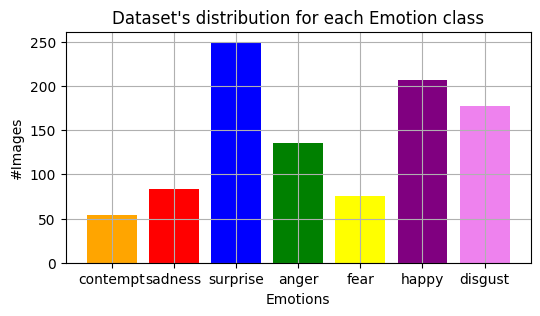

In [ ]:
data_path_ck = '/content/CK+48'
data, labels = load_data(data_path_ck)
l = labels
l.shape

In [ ]:
from sklearn.model_selection import train_test_split

# first split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.2, random_state=42)

In [ ]:
from tensorflow.keras.utils import to_categorical

# Convert y_train to categorical
num_classes = 7 # for example, if y_train contains 10 classes

y_train = to_categorical(y_train, num_classes)
y_test = to_categorical(y_test, num_classes)

In [ ]:
X_train.shape, y_train.shape,  X_test.shape, y_test.shape

((784, 48, 48, 3), (784, 7), (197, 48, 48, 3), (197, 7))

In [ ]:
import torchvision.transforms as transforms
from torch.utils.data import Dataset

class CustomDataset(Dataset):
    def __init__(self, data, labels, transform=None):
        self.data = data
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, index):
        x = self.data[index]
        y = self.labels[index]
        if self.transform:
            x = self.transform(x)
        return x, y

train_dataset = CustomDataset(X_train, y_train, transform=transforms.Compose([
                            transforms.Resize((255, 255)),
                            transforms.ToTensor()
                        ]))

test_dataset = CustomDataset(X_test, y_test, transform=transforms.Compose([
                            transforms.Resize((255, 255)),
                            transforms.ToTensor()
                        ]))


In [ ]:
batch_size = 64
train_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True
)
test_loader = torch.utils.data.DataLoader(
    test_dataset,
    batch_size=batch_size,
    shuffle=True
)

In [ ]:
import os
import shutil
import random

data_dir = '/content/CK+48'  # Replace with the actual path to your CKPlus dataset
train_dir = '/content/ck_train_dir'  # Replace with the path where you want to store the training set
test_dir = '/content/ck_test_dir'  # Replace with the path where you want to store the testing set
test_ratio = 0.2  # The ratio of data to be used for testing

# Create the train and test directories if they don't exist
os.makedirs(train_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)

# Iterate over the subfolders and randomly assign them to the train or test set
for emo_folder in os.listdir(data_dir):
    emo_path = os.path.join(data_dir, emo_folder)
    if not os.path.isdir(emo_path):
        continue
    images = os.listdir(emo_path)
    num_test = int(len(images) * test_ratio)
    test_images = random.sample(images, num_test)
    for img in images:
        src = os.path.join(emo_path, img)
        if img in test_images:
            dst = os.path.join(test_dir, emo_folder, img)
        else:
            dst = os.path.join(train_dir, emo_folder, img)
        os.makedirs(os.path.dirname(dst), exist_ok=True)
        shutil.copy(src, dst)


In [ ]:
# %% Prepare data for pretrained model
train_dataset = torchvision.datasets.ImageFolder(
        root='/content/ck_train_dir',
        transform=transforms.Compose([
                      transforms.Resize((255,255)),
                      transforms.ToTensor()
        ])
)

test_dataset = torchvision.datasets.ImageFolder(
        root='/content/ck_test_dir',
        transform=transforms.Compose([
                      transforms.Resize((255,255)),
                      transforms.ToTensor()
        ])
)

In [ ]:
batch_size = 64
train_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True
)
test_loader = torch.utils.data.DataLoader(
    test_dataset,
    batch_size=batch_size,
    shuffle=True
)

### Modeling

In [ ]:
class CNNModel(nn.Module):
    def __init__(self):
        super(CNNModel, self).__init__()
        self.vgg16 = models.vgg16(pretrained=True)

        # Replace output layer according to our problem
        in_feats = self.vgg16.classifier[6].in_features
        self.vgg16.classifier[6] = nn.Linear(in_feats, 7)

    def forward(self, x):
        x = self.vgg16(x)
        return x

model = CNNModel()
model.to(device)
model

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:08<00:00, 67.1MB/s]


CNNModel(
  (vgg16): VGG(
    (features): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): ReLU(inplace=True)
      (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace=True)
      (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (13): ReLU(inplace=True)
      (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (15): ReLU(inplace=True)
      (16):

In [ ]:
# %% Train
cross_entropy_loss = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.00002)
epochs = 100

In [ ]:
# Iterate x epochs over the train data
for epoch in range(epochs):
    for i, batch in enumerate(train_loader, 0):
        inputs, labels = batch
        inputs = inputs.to(device)
        labels = labels.to(device)
        optimizer.zero_grad()
        outputs = model(inputs)
        # Labels are automatically one-hot-encoded
        loss = cross_entropy_loss(outputs, labels)
        loss.backward()
        optimizer.step()
        print("Epochs:",epoch,"of", epochs,loss)


In [ ]:
# Save your model to Google Drive
torch.save(model.state_dict(), '/content/drive/MyDrive/mCK_model_50Epo.pth')

### Evaluation

In [ ]:
model.load_state_dict(torch.load("/content/drive/MyDrive/CK_model_50Epo.pth"))

<All keys matched successfully>

In [ ]:
import torch

model.eval()  # Set the model to evaluation mode

# Rest of your testing code
test_loss = 0
correct = 0
total = 0

with torch.no_grad():
    for batch in test_loader:
        inputs, labels = batch
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)

        total += labels.size(0)
        correct += (predicted == labels).sum().item()

        loss = cross_entropy_loss(outputs, labels)
        test_loss += loss.item()

    test_loss /= len(test_loader)
    accuracy = 100 * correct / total

    print(f"Test Loss: {test_loss:.4f}")
    print(f"Test Accuracy: {accuracy:.2f}%")


Test Loss: 0.0000
Test Accuracy: 100.00%


In [ ]:

# %% Inspect predictions for first batch test/train loader
import pandas as pd

inputs, labels = next(iter(test_loader))
inputs = inputs.to(device)
labels = labels.numpy()
outputs = model(inputs).max(1).indices.detach().cpu().numpy()

comparison = pd.DataFrame()
# print("Batch predictions:")
# print(outputs)

comparison["actual"] = labels
comparison["predicted"] = outputs

print("\nComparison:")
print(comparison.head())


Comparison:
   actual  predicted
0       1          1
1       0          0
2       2          2
3       3          3
4       2          2


### Confusion Matrix

Test Loss: 0.0000
Test Accuracy: 100.00%


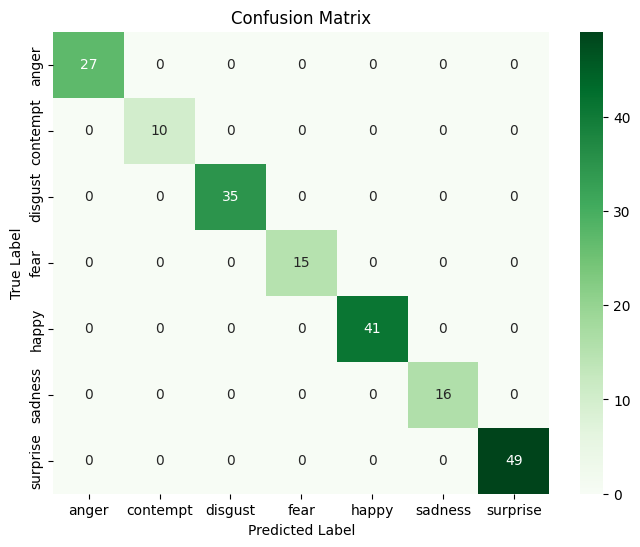

In [ ]:
import torch
import numpy as np
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Rest of your testing code
test_loss = 0
correct = 0
total = 0
all_predicted = []
all_labels = []

with torch.no_grad():
    for batch in test_loader:
        inputs, labels = batch
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)

        total += labels.size(0)
        correct += (predicted == labels).sum().item()

        loss = cross_entropy_loss(outputs, labels)
        test_loss += loss.item()

        all_predicted.extend(predicted.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    test_loss /= len(test_loader)
    accuracy = 100 * correct / total

    print(f"Test Loss: {test_loss:.4f}")
    print(f"Test Accuracy: {accuracy:.2f}%")

# Calculate the confusion matrix
cm = confusion_matrix(all_labels, all_predicted)

classes = list(train_dataset.class_to_idx.keys())
def plot_confusion_matrix(cm, classes, title='Confusion Matrix', cmap=None):
    plt.figure(figsize=(8, 6))
    if cmap is None:
        cmap = plt.get_cmap('Greens')
    sns.heatmap(cm, annot=True, fmt='d', cmap=cmap, xticklabels=classes, yticklabels=classes)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title(title)
    plt.show()

# Assuming you already have the confusion matrix 'cm' and the class labels 'classes'
plot_confusion_matrix(cm, classes)


In [ ]:
import matplotlib.pyplot as plt

def generate_heatmap(pixel_relevance_scores):
    # Normalize the relevance scores between 0 and 1
    normalized_scores = (pixel_relevance_scores - np.min(pixel_relevance_scores)) / (np.max(pixel_relevance_scores) - np.min(pixel_relevance_scores))

    # Create the heatmap using the normalized relevance scores
    heatmap = plt.imshow(normalized_scores, cmap='jet')

    # Add a colorbar to the heatmap
    plt.colorbar(heatmap)

    # Show the generated heatmap
    plt.show()


### LRP on VGG16

In [ ]:
def new_layer(layer, g):
    """Clone a layer and pass its parameters through the function g."""
    layer = copy.deepcopy(layer)
    try: layer.weight = torch.nn.Parameter(g(layer.weight))
    except AttributeError: pass
    try: layer.bias = torch.nn.Parameter(g(layer.bias))
    except AttributeError: pass
    return layer

def dense_to_conv(layers):
    """ Converts a dense layer to a conv layer """
    newlayers = []
    for i,layer in enumerate(layers):
        if isinstance(layer, nn.Linear):
            newlayer = None
            if i == 0:
                m, n = 512, layer.weight.shape[0]
                newlayer = nn.Conv2d(m,n,7)
                newlayer.weight = nn.Parameter(layer.weight.reshape(n,m,7,7))
            else:
                m,n = layer.weight.shape[1],layer.weight.shape[0]
                newlayer = nn.Conv2d(m,n,1)
                newlayer.weight = nn.Parameter(layer.weight.reshape(n,m,1,1))
            newlayer.bias = nn.Parameter(layer.bias)
            newlayers += [newlayer]
        else:
            newlayers += [layer]
    return newlayers

def get_linear_layer_indices(model):
    offset = len(model.vgg16._modules['features']) + 1
    indices = []
    for i, layer in enumerate(model.vgg16._modules['classifier']):
        if isinstance(layer, nn.Linear):
            indices.append(i)
    indices = [offset + val for val in indices]
    return indices

In [ ]:
def apply_lrp_on_vgg16(model, image):
    image = torch.unsqueeze(image, 0)
    # >>> Step 1: Extract layers
    layers = list(model.vgg16._modules['features']) \
                + [model.vgg16._modules['avgpool']] \
                + dense_to_conv(list(model.vgg16._modules['classifier']))
    linear_layer_indices = get_linear_layer_indices(model)
    # >>> Step 2: Propagate image through layers and store activations
    n_layers = len(layers)
    activations = [image] + [None] * n_layers # list of activations

    for layer in range(n_layers):
        if layer in linear_layer_indices:
            if layer == 32:
                activations[layer] = activations[layer].reshape((1, 512, 7, 7))
        activation = layers[layer].forward(activations[layer])
        if isinstance(layers[layer], torch.nn.modules.pooling.AdaptiveAvgPool2d):
            activation = torch.flatten(activation, start_dim=1)
        activations[layer+1] = activation

    # >>> Step 3: Replace last layer with one-hot-encoding
    output_activation = activations[-1].detach().cpu().numpy()
    max_activation = output_activation.max()
    one_hot_output = [val if val == max_activation else 0
                        for val in output_activation[0]]

    activations[-1] = torch.FloatTensor([one_hot_output]).to(device)

    # >>> Step 4: Backpropagate relevance scores
    relevances = [None] * n_layers + [activations[-1]]
    # Iterate over the layers in reverse order
    for layer in range(0, n_layers)[::-1]:
        current = layers[layer]
        # Treat max pooling layers as avg pooling
        if isinstance(current, torch.nn.MaxPool2d):
            layers[layer] = torch.nn.AvgPool2d(2)
            current = layers[layer]
        if isinstance(current, torch.nn.Conv2d) or \
           isinstance(current, torch.nn.AvgPool2d) or\
           isinstance(current, torch.nn.Linear):
            activations[layer] = activations[layer].data.requires_grad_(True)

            # Apply variants of LRP depending on the depth
            # see: https://link.springer.com/chapter/10.1007%2F978-3-030-28954-6_10
            # Lower layers, LRP-gamma >> Favor positive contributions (activations)
            if layer <= 16:       rho = lambda p: p + 0.25*p.clamp(min=0); incr = lambda z: z+1e-9
            # Middle layers, LRP-epsilon >> Remove some noise / Only most salient factors survive
            if 17 <= layer <= 30: rho = lambda p: p;                       incr = lambda z: z+1e-9+0.25*((z**2).mean()**.5).data
            # Upper Layers, LRP-0 >> Basic rule
            if layer >= 31:       rho = lambda p: p;                       incr = lambda z: z+1e-9

            # Transform weights of layer and execute forward pass
            z = incr(new_layer(layers[layer],rho).forward(activations[layer]))
            # Element-wise division between relevance of the next layer and z
            s = (relevances[layer+1]/z).data
            # Calculate the gradient and multiply it by the activation
            (z * s).sum().backward();
            c = activations[layer].grad
            # Assign new relevance values
            relevances[layer] = (activations[layer]*c).data
        else:
            relevances[layer] = relevances[layer+1]

    # >>> Potential Step 5: Apply different propagation rule for pixels
    return relevances[0]

#### test

Original label :  tensor(6) | Groundtruth for this image:  surprise


<ipython-input-53-c588761682f4>:20: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,1)


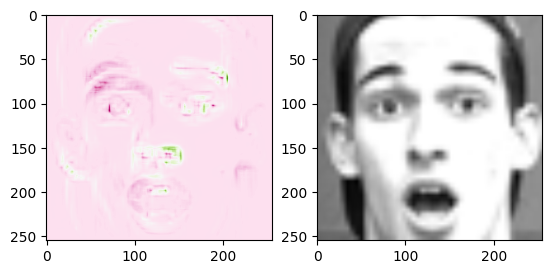

In [ ]:
# %%
# Calculate relevances for a image in this test batch
# 3, 4, 5, 7
image_id = 1
# image_id = 12
image_relevances = apply_lrp_on_vgg16(model, inputs[image_id])
image_relevances = image_relevances.permute(0,2,3,1).detach().cpu().numpy()[0]
image_relevances = np.interp(image_relevances, (image_relevances.min(),
                                                image_relevances.max()),
                                                (0, 1))
# Show relevances
pred_label = list(test_dataset.class_to_idx.keys())[
             list(test_dataset.class_to_idx.values())
            .index(labels[image_id])]
if outputs[image_id] == labels[image_id]:
    print("Original label : ", labels[image_id], "| Groundtruth for this image: ", pred_label)

    # Plot images next to each other
    plt.axis('off')
    plt.subplot(1,2,1)
    # plt.imshow(image_relevances[:,:,0], cmap="seismic")
    plt.imshow(image_relevances[:,:,0], cmap="PiYG")
    plt.subplot(1,2,2)
    plt.imshow(inputs[image_id].permute(1,2,0).detach().cpu().numpy())
    plt.show()
else:
    print("This image is not classified correctly.")


In [ ]:
# Get the input image
input_image = inputs[image_id]

# Apply LRP on the input image to get the relevance scores
image_relevances = apply_lrp_on_vgg16(model, input_image)
image_relevances = image_relevances.permute(0, 2, 3, 1).detach().cpu().numpy()[0]

# Get the relevance scores for each pixel in the input image
# pixel_relevance_scores = input_image.detach().cpu().numpy() * image_relevances
pixel_relevance_scores = input_image.detach().cpu().numpy() * np.transpose(image_relevances, (2, 0, 1))
print(pixel_relevance_scores)

In [ ]:
mean_relevance_score = np.mean(pixel_relevance_scores)
print(mean_relevance_score)

In [ ]:
import matplotlib.pyplot as plt

def generate_heatmap(pixel_relevance_scores):
    # Normalize the relevance scores between 0 and 1
    normalized_scores = (pixel_relevance_scores - np.min(pixel_relevance_scores)) / (np.max(pixel_relevance_scores) - np.min(pixel_relevance_scores))

    # Create the heatmap using the normalized relevance scores
    heatmap = plt.imshow(normalized_scores, cmap='jet')

    # Add a colorbar to the heatmap
    plt.colorbar(heatmap)

    # Show the generated heatmap
    plt.show()


In [ ]:
import matplotlib.pyplot as plt

# Select the channel for which you want to generate the heatmap
channel_index = 2  # Change this to the desired channel index (0, 1, or 2)

# Get the relevance scores for the selected channel
relevance_scores = pixel_relevance_scores[channel_index]

# Generate the heatmap
heatmap = plt.imshow(relevance_scores, cmap='hot')
plt.colorbar(heatmap)

# Display the heatmap
plt.figure(figsize=(10.0, 10.0))
plt.show()


In [ ]:
import matplotlib.pyplot as plt

# Select the channel for which you want to generate the heatmap
channel_index = 2  # Change this to the desired channel index (0, 1, or 2)

# Get the relevance scores for the selected channel
relevance_scores = pixel_relevance_scores[channel_index]

# Generate the heatmap with the desired size

cmaps = ['Accent', 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'BrBG_r', 'BuGn', 'BuGn_r', 'BuPu', 'BuPu_r', 'CMRmap', 'CMRmap_r', 'Dark2', 'Dark2_r', 'GnBu', 'GnBu_r', 'Greens', 'Greens_r', 'Greys', 'Greys_r', 'OrRd', 'OrRd_r', 'Oranges', 'Oranges_r', 'PRGn', 'PRGn_r', 'Paired', 'Paired_r', 'Pastel1', 'Pastel1_r', 'Pastel2', 'Pastel2_r', 'PiYG', 'PiYG_r', 'PuBu', 'PuBuGn', 'PuBuGn_r', 'PuBu_r', 'PuOr', 'PuOr_r', 'PuRd', 'PuRd_r', 'Purples', 'Purples_r', 'RdBu', 'RdBu_r', 'RdGy', 'RdGy_r', 'RdPu', 'RdPu_r', 'RdYlBu', 'RdYlBu_r', 'RdYlGn', 'RdYlGn_r', 'Reds', 'Reds_r', 'Set1', 'Set1_r', 'Set2', 'Set2_r', 'Set3', 'Set3_r', 'Spectral', 'Spectral_r', 'Wistia', 'Wistia_r', 'YlGn', 'YlGnBu', 'YlGnBu_r', 'YlGn_r', 'YlOrBr', 'YlOrBr_r', 'YlOrRd', 'YlOrRd_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'bwr_r', 'cividis', 'cividis_r', 'cool', 'cool_r', 'coolwarm', 'coolwarm_r', 'copper', 'copper_r', 'crest', 'crest_r', 'cubehelix', 'cubehelix_r', 'flag', 'flag_r', 'flare', 'flare_r', 'gist_earth', 'gist_earth_r', 'gist_gray', 'gist_gray_r', 'gist_heat', 'gist_heat_r', 'gist_ncar', 'gist_ncar_r', 'gist_rainbow', 'gist_rainbow_r', 'gist_stern', 'gist_stern_r', 'gist_yarg', 'gist_yarg_r', 'gnuplot', 'gnuplot2', 'gnuplot2_r', 'gnuplot_r', 'gray', 'gray_r', 'hot', 'hot_r', 'hsv', 'hsv_r', 'icefire', 'icefire_r', 'inferno', 'inferno_r', 'jet', 'jet_r']
for c in cmaps:
    plt.figure(figsize=(2, 2))  # Set the desired size of the heatmap
    heatmap = plt.imshow(relevance_scores, cmap=c)  # Set the extent to match the size of the heatmap
    plt.xlabel(c)
    # Add a colorbar
    plt.colorbar(heatmap)

    # Display the heatmap
    plt.show()


In [ ]:
import matplotlib.pyplot as plt

# Select the channel for which you want to generate the heatmap
channel_index = 0  # Change this to the desired channel index (0, 1, or 2)

# Get the relevance scores for the selected channel
relevance_scores = pixel_relevance_scores[channel_index]

# Generate the heatmap
plt.figure(figsize = (2, 2))
heatmap = plt.imshow(relevance_scores, cmap='hot')
plt.colorbar(heatmap)

# Display the heatmap
plt.show()

In [ ]:
import matplotlib.pyplot as plt

# Select the channel for which you want to generate the heatmap
channel_index = 1  # Change this to the desired channel index (0, 1, or 2)

# Get the relevance scores for the selected channel
relevance_scores = pixel_relevance_scores[channel_index]

# Generate the heatmap
heatmap = plt.imshow(relevance_scores, cmap='hot')
plt.colorbar(heatmap)

# Display the heatmap
plt.show()

In [ ]:
# # Iterate over the images in the class_images list
# # class_images =['anger','contempt','disgust','fear','happy','sadness','surprise']
# for image_id, image in enumerate(class_images):
#     # Apply LRP on the input image to get the relevance scores
#     image_relevances = apply_lrp_on_vgg16(model, image)
#     image_relevances = image_relevances.permute(0, 2, 3, 1).detach().cpu().numpy()[0]

#     # Get the relevance scores for each pixel in the input image
#     pixel_relevance_scores = image.detach().cpu().numpy() * np.transpose(image_relevances, (2, 0, 1))

#     # Generate heatmap using the pixel relevance scores
#     heatmap = np.sum(pixel_relevance_scores, axis=0)

#     # Display or save the heatmap as desired
#     plt.imshow(heatmap, cmap='hot')
#     plt.axis('off')
#     plt.show()




In [ ]:
# channel_index = 0  # Index of the channel you want to consider
# pixel_contribution_dict = {}

# # Iterate over the pixels in the channel
# for row in range(224):
#     for col in range(224):
#         pixel_value = pixel_relevance_scores[channel_index, row, col]
#         total_contribution = np.sum(pixel_relevance_scores[channel_index])
#         contribution_percentage = (pixel_value / total_contribution) * 100
#         pixel_contribution_dict[(row, col)] = contribution_percentage


In [ ]:
z_count, p_count = 0,0
for value in pixel_contribution_dict.values():
    if value > 0:
      p_count = p_count + 1
    else:
      z_count = z_count + 1
    # print(value)


In [ ]:
print(z_count, p_count)

In [ ]:
# Find the pixel with the highest contribution percentage
max_contribution_pixel = max(pixel_contribution_dict, key=pixel_contribution_dict.get)
max_contribution_percentage = pixel_contribution_dict[max_contribution_pixel]

# Print the pixel coordinates and its corresponding contribution percentage
print("Pixel with the highest contribution:")
print("Pixel coordinates:", max_contribution_pixel)
print("Contribution percentage:", max_contribution_percentage)


NameError: ignored

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Transpose the dimensions of the image array
image = np.transpose(input_image, (1, 2, 0))  # Assuming input_image shape is (3, 255, 255)

# Plot the image
plt.imshow(image)

# Define the threshold for high contribution percentage
threshold = 0.08  # Replace with your desired threshold value

# Get the pixel coordinates with high contribution percentage
high_contrib_pixels = [pixel for pixel, contribution in pixel_contribution_dict.items() if contribution > threshold]

# Highlight the relevant parts of the image
for pixel in high_contrib_pixels:
    plt.scatter(pixel[1], pixel[0], color='blue', s=10)  # Assumes pixel coordinates are (row, column)

# Show the plot
plt.show()


*Fixing of lambda value*

In [ ]:
image_id = 4
# image_id = 12
image_relevances = apply_lrp_on_vgg16(model, inputs[image_id])
image_relevances = image_relevances.permute(0,2,3,1).detach().cpu().numpy()[0]
image_relevances = np.interp(image_relevances, (image_relevances.min(),
                                                image_relevances.max()),
                                                (0, 1))
# Show relevances
pred_label = list(train_dataset.class_to_idx.keys())[
             list(train_dataset.class_to_idx.values())
            .index(labels[image_id])]
if outputs[image_id] == labels[image_id]:
    print("Original label : ", labels[image_id], "| Groundtruth for this image: ", pred_label)

    # Plot images next to each other
    plt.axis('off')
    plt.subplot(1,2,1)
    # plt.imshow(image_relevances[:,:,0], cmap="seismic")
    plt.imshow(image_relevances[:,:,0], cmap="PiYG")
    plt.subplot(1,2,2)
    plt.imshow(inputs[image_id].permute(1,2,0).detach().cpu().numpy())
    plt.show()
else:
    print("This image is not classified correctly.")

In [ ]:
# Specify the class you want to visualize
target_class = "happy"

# Find the index of the target class in the list of class labels
class_index = list(train_dataset.class_to_idx.keys()).index(target_class)

# Iterate through the images in the dataset
for image_id in range(len(inputs)):
    image_relevances = apply_lrp_on_vgg16(model, inputs[image_id])
    image_relevances = image_relevances.permute(0, 2, 3, 1).detach().cpu().numpy()[0]
    image_relevances = np.interp(image_relevances, (image_relevances.min(), image_relevances.max()), (0, 1))

    # Check if the predicted label matches the target class
    if outputs[image_id] == class_index:
        pred_label = list(train_dataset.class_to_idx.keys())[outputs[image_id]]
        print("Original label:", labels[image_id], "| Groundtruth for this image:", pred_label)

        # Plot images next to each other
        plt.axis('off')
        plt.subplot(1, 2, 1)
        plt.imshow(image_relevances[:, :, 0], cmap="PiYG")
        plt.subplot(1, 2, 2)
        plt.imshow(inputs[image_id].permute(1, 2, 0).detach().cpu().numpy())
        plt.show()
    else:
        print("This image is not classified correctly.")


In [ ]:
# Specify the class you want to visualize
target_class = "disgust"

# Find the index of the target class in the list of class labels
class_index = list(train_dataset.class_to_idx.keys()).index(target_class)

# Iterate through the images in the dataset
for image_id in range(len(inputs)):
    image_relevances = apply_lrp_on_vgg16(model, inputs[image_id])
    image_relevances = image_relevances.permute(0, 2, 3, 1).detach().cpu().numpy()[0]
    image_relevances = np.interp(image_relevances, (image_relevances.min(), image_relevances.max()), (0, 1))

    # Check if the predicted label matches the target class
    if outputs[image_id] == class_index:
        pred_label = list(train_dataset.class_to_idx.keys())[outputs[image_id]]
        print("Original label:", labels[image_id], "| Groundtruth for this image:", pred_label)

        # Plot images next to each other
        plt.axis('off')
        plt.subplot(1, 2, 1)
        plt.imshow(image_relevances[:, :, 0], cmap="PiYG")
        plt.subplot(1, 2, 2)
        plt.imshow(inputs[image_id].permute(1, 2, 0).detach().cpu().numpy())
        plt.show()
    else:
        print("This image is not classified correctly.")


### Results with relevance heatmaps

In [ ]:
def pixel_contribution_dictionary(channel, pixel_relevance_scores):
    channel_index = channel  # Index of the channel you want to consider
    pixel_contribution_dict = {}

    # Iterate over the pixels in the channel
    for row in range(255):
        for col in range(255):
            pixel_value = pixel_relevance_scores[channel_index, row, col]
            total_contribution = np.sum(pixel_relevance_scores[channel_index])
            contribution_percentage = (pixel_value / total_contribution) * 100
            pixel_contribution_dict[(row, col)] = contribution_percentage
    return pixel_contribution_dict

In [ ]:
def contributed_pixels_count(c, prs):
  z_count, p_count = 0,0
  for value in pixel_contribution_dictionary(c, prs).values():
      if value > 0:
        p_count = p_count + 1
      else:
        z_count = z_count + 1
  print("zero contributed : ", z_count,"and actively contributed : ", p_count)
  return p_count, z_count

torch.Size([64, 3, 255, 255])
0


<ipython-input-30-3641deb26041>:27: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:245.)
  activations[-1] = torch.FloatTensor([one_hot_output]).to(device)


3 and tensor(3)
Groundtruth for this image: fear


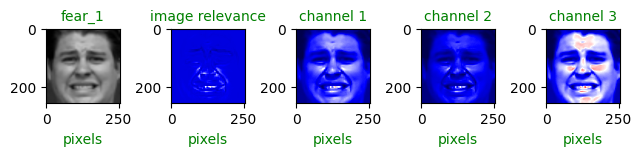

zero contributed :  970 and actively contributed :  64055
['fear_1']|[64055]|[970]
1
2 and tensor(2)
Groundtruth for this image: disgust


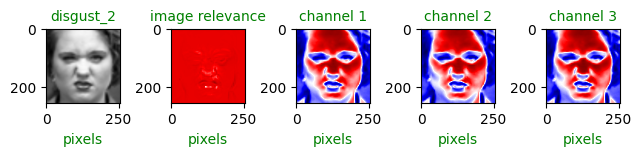

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2']|[64055, 65024]|[970, 1]
2
6 and tensor(6)
Groundtruth for this image: surprise


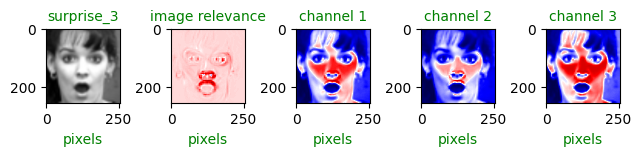

zero contributed :  87 and actively contributed :  64938
['fear_1', 'disgust_2', 'surprise_3']|[64055, 65024, 64938]|[970, 1, 87]
3
6 and tensor(6)
Groundtruth for this image: surprise


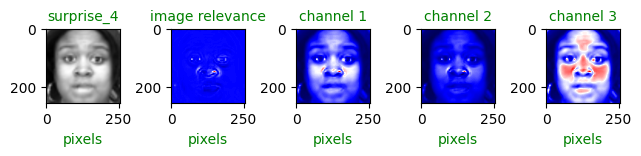

zero contributed :  63 and actively contributed :  64962
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4']|[64055, 65024, 64938, 64962]|[970, 1, 87, 63]
4
1 and tensor(1)
Groundtruth for this image: contempt


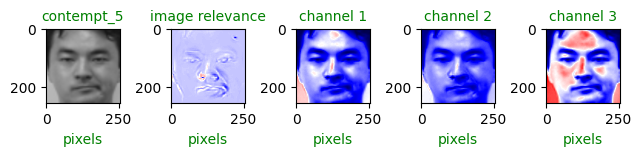

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5']|[64055, 65024, 64938, 64962, 65024]|[970, 1, 87, 63, 1]
5
6 and tensor(6)
Groundtruth for this image: surprise


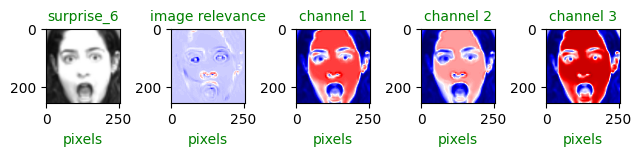

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6']|[64055, 65024, 64938, 64962, 65024, 65024]|[970, 1, 87, 63, 1, 1]
6
6 and tensor(6)
Groundtruth for this image: surprise


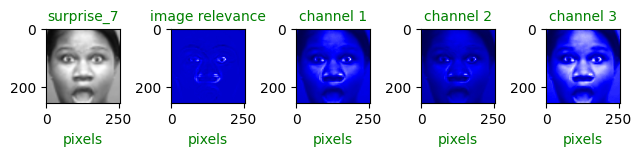

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7']|[64055, 65024, 64938, 64962, 65024, 65024, 65024]|[970, 1, 87, 63, 1, 1, 1]
7
Not a sequence ..
8
Not a sequence ..
9
Not a sequence ..
10
1 and tensor(1)
Groundtruth for this image: contempt


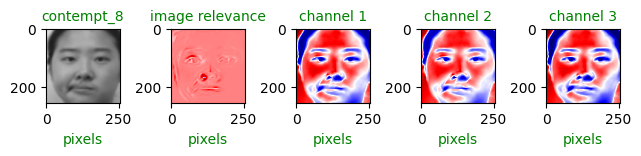

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024]|[970, 1, 87, 63, 1, 1, 1, 1]
11
Not a sequence ..
12
2 and tensor(2)
Groundtruth for this image: disgust


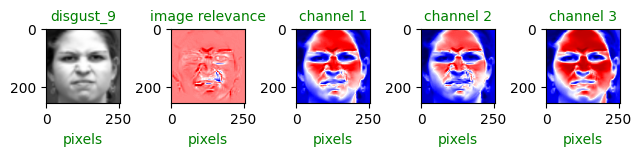

zero contributed :  26 and actively contributed :  64999
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999]|[970, 1, 87, 63, 1, 1, 1, 1, 26]
13
Not a sequence ..
14
6 and tensor(6)
Groundtruth for this image: surprise


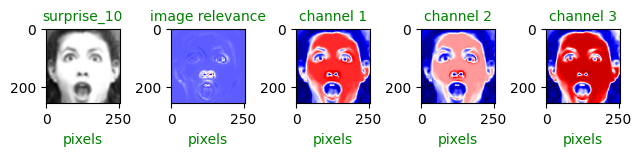

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1]
15
6 and tensor(6)
Groundtruth for this image: surprise


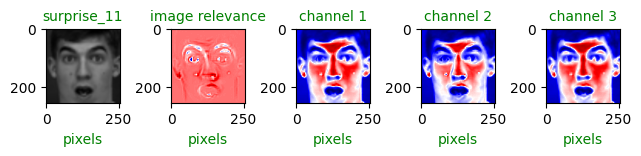

zero contributed :  138 and actively contributed :  64887
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138]
16
2 and tensor(2)
Groundtruth for this image: disgust


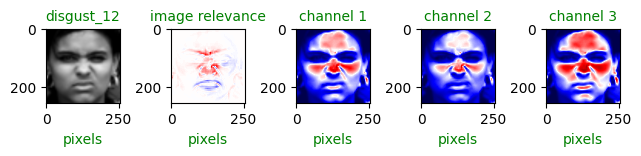

zero contributed :  4232 and actively contributed :  60793
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232]
17
3 and tensor(3)
Groundtruth for this image: fear


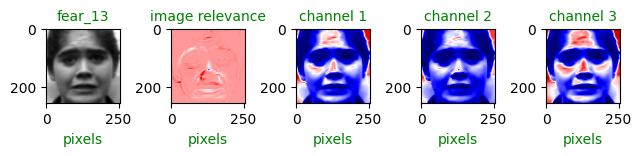

zero contributed :  82 and actively contributed :  64943
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82]
18
5 and tensor(5)
Groundtruth for this image: sadness


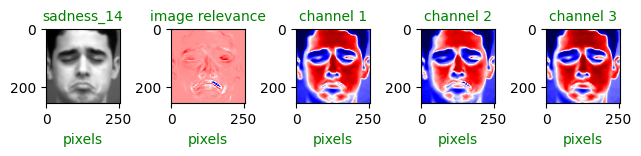

zero contributed :  1097 and actively contributed :  63928
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097]
19
5 and tensor(5)
Groundtruth for this image: sadness


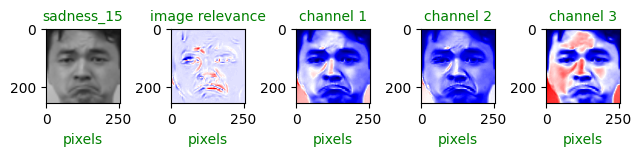

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1]
20
2 and tensor(2)
Groundtruth for this image: disgust


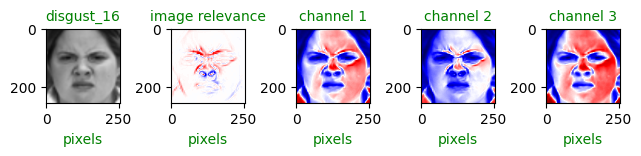

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1]
21
6 and tensor(6)
Groundtruth for this image: surprise


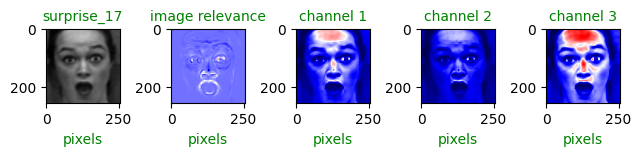

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1]
22
5 and tensor(5)
Groundtruth for this image: sadness


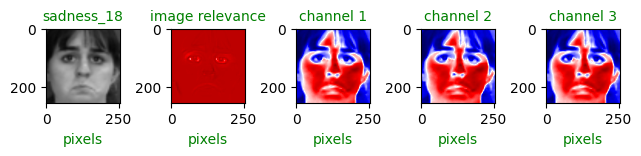

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1]
23
Not a sequence ..
24
6 and tensor(6)
Groundtruth for this image: surprise


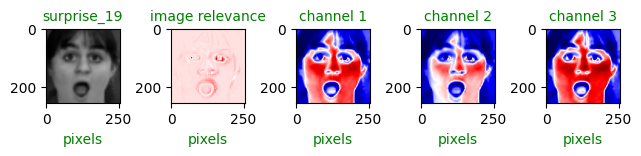

zero contributed :  157 and actively contributed :  64868
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157]
25
4 and tensor(4)
Groundtruth for this image: happy


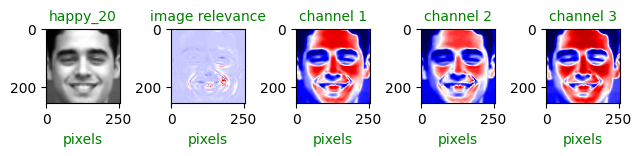

zero contributed :  994 and actively contributed :  64031
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994]
26
2 and tensor(2)
Groundtruth for this image: disgust


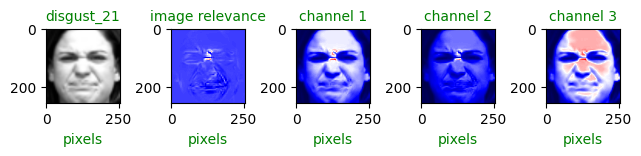

zero contributed :  1521 and actively contributed :  63504
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521]
27
6 and tensor(6)
Groundtruth for this image: surprise


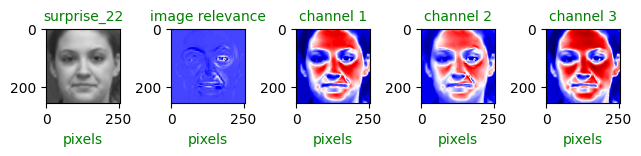

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1]
28
4 and tensor(4)
Groundtruth for this image: happy


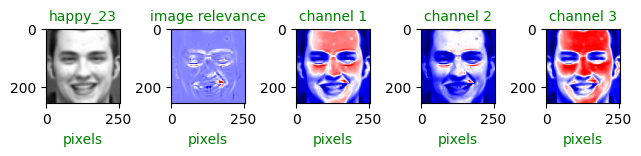

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1]
29
4 and tensor(4)
Groundtruth for this image: happy


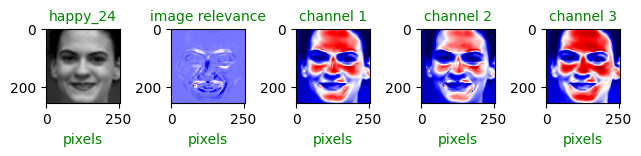

zero contributed :  2833 and actively contributed :  62192
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1, 2833]
30
2 and tensor(2)
Groundtruth for this image: disgust


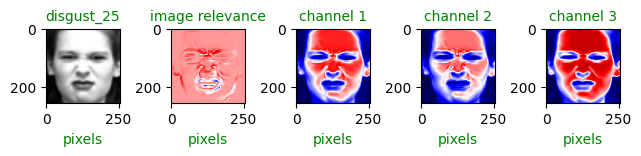

zero contributed :  378 and actively contributed :  64647
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1, 2833, 378]
31
4 and tensor(4)
Groundtruth for this image: happy


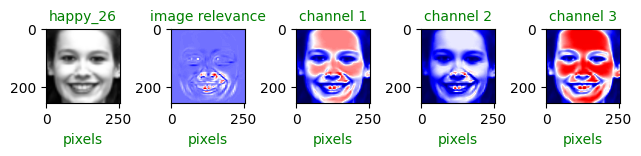

zero contributed :  360 and actively contributed :  64665
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1, 2833, 378, 360]
32
6 and tensor(6)
Groundtruth for this image: surprise


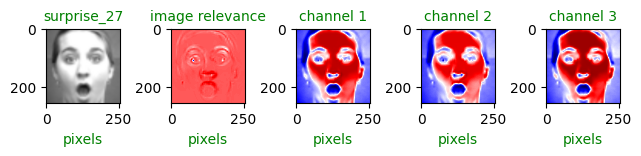

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1, 2833, 378, 360, 1]
33
2 and tensor(2)
Groundtruth for this image: disgust


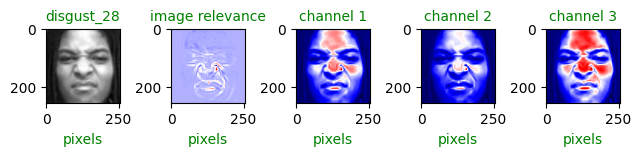

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1, 2833, 378, 360, 1, 1]
34
6 and tensor(6)
Groundtruth for this image: surprise


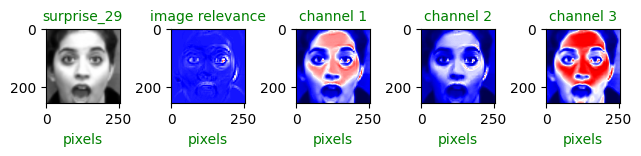

zero contributed :  1347 and actively contributed :  63678
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1, 2833, 378, 360, 1, 1, 1347]
35
Not a sequence ..
36
Not a sequence ..
37
6 and tensor(6)
Groundtruth for this image: surprise


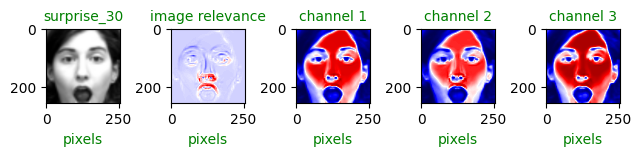

zero contributed :  1600 and actively contributed :  63425
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1, 2833, 378, 360, 1, 1, 1347, 1600]
38
6 and tensor(6)
Groundtruth for this image: surprise


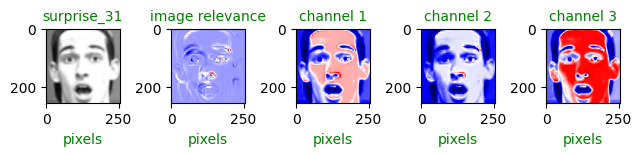

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1, 2833, 378, 360, 1, 1, 1347, 1600, 1]
39
Not a sequence ..
40
4 and tensor(4)
Groundtruth for this image: happy


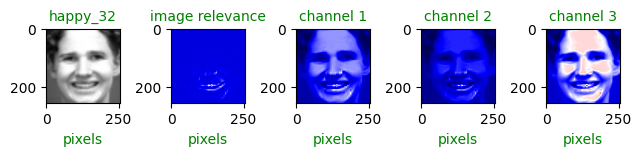

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31', 'happy_32']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024, 65024]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1, 2833, 378, 360, 1, 1, 1347, 1600, 1, 1]
41
4 and tensor(4)
Groundtruth for this image: happy


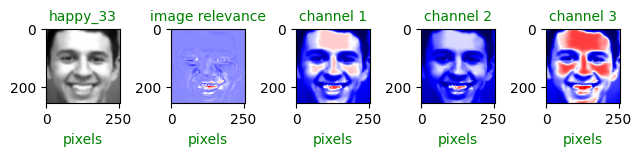

zero contributed :  106 and actively contributed :  64919
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31', 'happy_32', 'happy_33']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024, 65024, 64919]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1, 2833, 378, 360, 1, 1, 1347, 1600, 1, 1, 106]
42
5 and tensor(5)
Groundtruth for this image: sadness


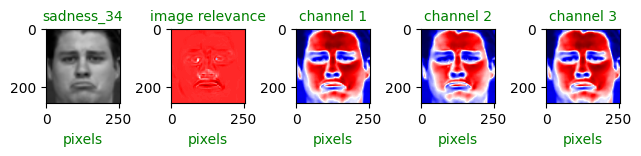

zero contributed :  993 and actively contributed :  64032
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31', 'happy_32', 'happy_33', 'sadness_34']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024, 65024, 64919, 64032]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1, 2833, 378, 360, 1, 1, 1347, 1600, 1, 1, 106, 993]
43
2 and tensor(2)
Groundtruth for this image: disgust


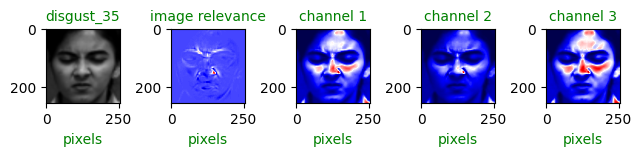

zero contributed :  4824 and actively contributed :  60201
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31', 'happy_32', 'happy_33', 'sadness_34', 'disgust_35']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024, 65024, 64919, 64032, 60201]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1, 2833, 378, 360, 1, 1, 1347, 1600, 1, 1, 106, 993, 4824]
44
6 and tensor(6)
Groundtruth for this image: surprise


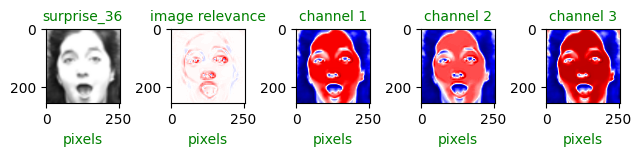

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31', 'happy_32', 'happy_33', 'sadness_34', 'disgust_35', 'surprise_36']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024, 65024, 64919, 64032, 60201, 65024]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1, 2833, 378, 360, 1, 1, 1347, 1600, 1, 1, 106, 993, 4824, 1]
45
6 and tensor(6)
Groundtruth for this image: 

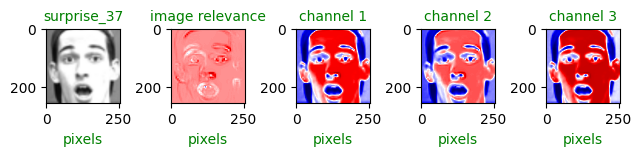

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31', 'happy_32', 'happy_33', 'sadness_34', 'disgust_35', 'surprise_36', 'surprise_37']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024, 65024, 64919, 64032, 60201, 65024, 65024]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1, 2833, 378, 360, 1, 1, 1347, 1600, 1, 1, 106, 993, 4824, 1, 1]
46
4 and tensor(4)
Gro

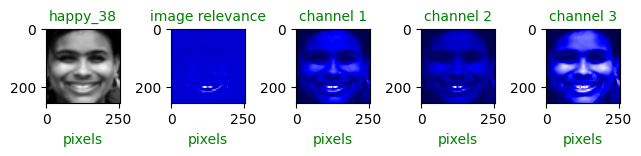

zero contributed :  3418 and actively contributed :  61607
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31', 'happy_32', 'happy_33', 'sadness_34', 'disgust_35', 'surprise_36', 'surprise_37', 'happy_38']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024, 65024, 64919, 64032, 60201, 65024, 65024, 61607]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1, 2833, 378, 360, 1, 1, 1347, 1600, 1, 1, 106, 993, 4824, 1, 1, 

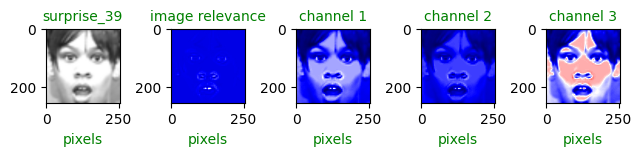

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31', 'happy_32', 'happy_33', 'sadness_34', 'disgust_35', 'surprise_36', 'surprise_37', 'happy_38', 'surprise_39']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024, 65024, 64919, 64032, 60201, 65024, 65024, 61607, 65024]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1, 2833, 378, 360, 1, 1, 1347, 1600, 1, 1, 106

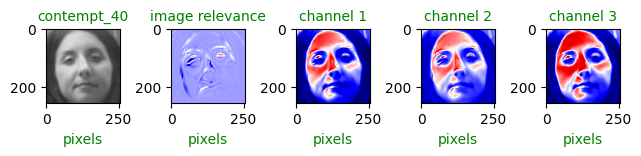

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31', 'happy_32', 'happy_33', 'sadness_34', 'disgust_35', 'surprise_36', 'surprise_37', 'happy_38', 'surprise_39', 'contempt_40']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024, 65024, 64919, 64032, 60201, 65024, 65024, 61607, 65024, 65024]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1, 2833, 378, 360, 1, 1,

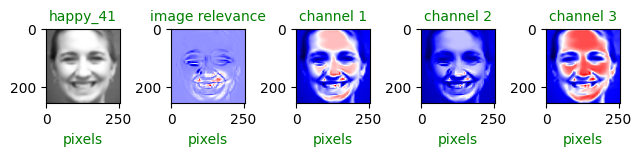

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31', 'happy_32', 'happy_33', 'sadness_34', 'disgust_35', 'surprise_36', 'surprise_37', 'happy_38', 'surprise_39', 'contempt_40', 'happy_41']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024, 65024, 64919, 64032, 60201, 65024, 65024, 61607, 65024, 65024, 65024]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157, 994, 1521, 1, 1, 28

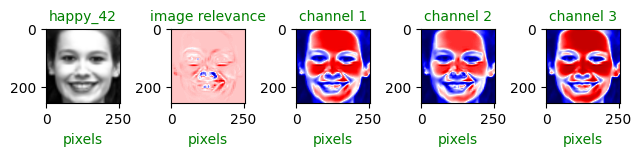

zero contributed :  467 and actively contributed :  64558
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31', 'happy_32', 'happy_33', 'sadness_34', 'disgust_35', 'surprise_36', 'surprise_37', 'happy_38', 'surprise_39', 'contempt_40', 'happy_41', 'happy_42']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024, 65024, 64919, 64032, 60201, 65024, 65024, 61607, 65024, 65024, 65024, 64558]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 1097, 1, 1, 1, 1, 157

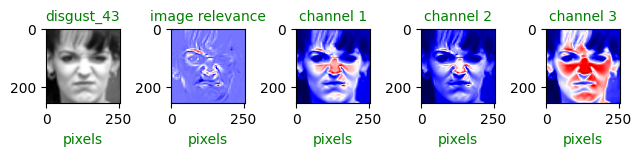

zero contributed :  116 and actively contributed :  64909
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31', 'happy_32', 'happy_33', 'sadness_34', 'disgust_35', 'surprise_36', 'surprise_37', 'happy_38', 'surprise_39', 'contempt_40', 'happy_41', 'happy_42', 'disgust_43']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024, 65024, 64919, 64032, 60201, 65024, 65024, 61607, 65024, 65024, 65024, 64558, 64909]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1, 138, 4232, 82, 

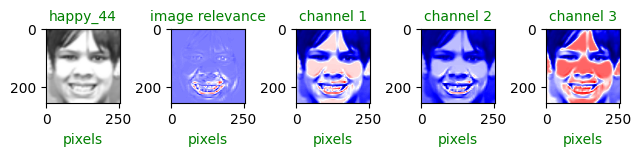

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31', 'happy_32', 'happy_33', 'sadness_34', 'disgust_35', 'surprise_36', 'surprise_37', 'happy_38', 'surprise_39', 'contempt_40', 'happy_41', 'happy_42', 'disgust_43', 'happy_44']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024, 65024, 64919, 64032, 60201, 65024, 65024, 61607, 65024, 65024, 65024, 64558, 64909, 65024]|[970, 1, 87, 63, 1, 1, 1, 1, 26, 1

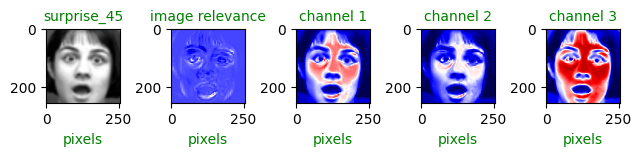

zero contributed :  446 and actively contributed :  64579
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31', 'happy_32', 'happy_33', 'sadness_34', 'disgust_35', 'surprise_36', 'surprise_37', 'happy_38', 'surprise_39', 'contempt_40', 'happy_41', 'happy_42', 'disgust_43', 'happy_44', 'surprise_45']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024, 65024, 64919, 64032, 60201, 65024, 65024, 61607, 65024, 65024, 65024, 64558, 64909, 65024, 64579]|[970, 1, 8

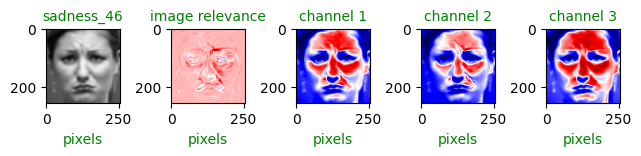

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31', 'happy_32', 'happy_33', 'sadness_34', 'disgust_35', 'surprise_36', 'surprise_37', 'happy_38', 'surprise_39', 'contempt_40', 'happy_41', 'happy_42', 'disgust_43', 'happy_44', 'surprise_45', 'sadness_46']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024, 65024, 64919, 64032, 60201, 65024, 65024, 61607, 65024, 65024, 65024, 64558, 64909, 65024, 64579

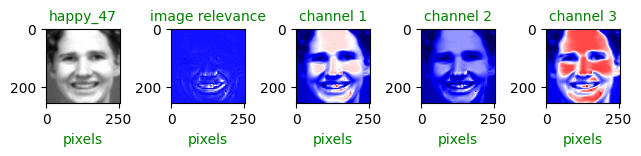

zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31', 'happy_32', 'happy_33', 'sadness_34', 'disgust_35', 'surprise_36', 'surprise_37', 'happy_38', 'surprise_39', 'contempt_40', 'happy_41', 'happy_42', 'disgust_43', 'happy_44', 'surprise_45', 'sadness_46', 'happy_47']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024, 65024, 64919, 64032, 60201, 65024, 65024, 61607, 65024, 65024, 65024, 64558, 64909, 

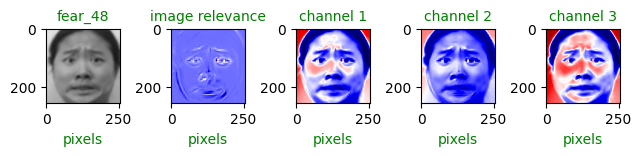

Exception ignored in: <function _xla_gc_callback at 0x7f2f8b9a2560>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/jax/_src/lib/__init__.py", line 103, in _xla_gc_callback
    def _xla_gc_callback(*args):
KeyboardInterrupt: 


zero contributed :  1 and actively contributed :  65024
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31', 'happy_32', 'happy_33', 'sadness_34', 'disgust_35', 'surprise_36', 'surprise_37', 'happy_38', 'surprise_39', 'contempt_40', 'happy_41', 'happy_42', 'disgust_43', 'happy_44', 'surprise_45', 'sadness_46', 'happy_47', 'fear_48']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024, 65024, 64919, 64032, 60201, 65024, 65024, 61607, 65024, 65024, 65024, 645

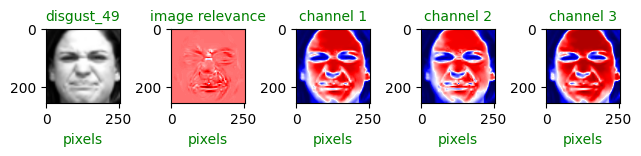

zero contributed :  1485 and actively contributed :  63540
['fear_1', 'disgust_2', 'surprise_3', 'surprise_4', 'contempt_5', 'surprise_6', 'surprise_7', 'contempt_8', 'disgust_9', 'surprise_10', 'surprise_11', 'disgust_12', 'fear_13', 'sadness_14', 'sadness_15', 'disgust_16', 'surprise_17', 'sadness_18', 'surprise_19', 'happy_20', 'disgust_21', 'surprise_22', 'happy_23', 'happy_24', 'disgust_25', 'happy_26', 'surprise_27', 'disgust_28', 'surprise_29', 'surprise_30', 'surprise_31', 'happy_32', 'happy_33', 'sadness_34', 'disgust_35', 'surprise_36', 'surprise_37', 'happy_38', 'surprise_39', 'contempt_40', 'happy_41', 'happy_42', 'disgust_43', 'happy_44', 'surprise_45', 'sadness_46', 'happy_47', 'fear_48', 'disgust_49']|[64055, 65024, 64938, 64962, 65024, 65024, 65024, 65024, 64999, 65024, 64887, 60793, 64943, 63928, 65024, 65024, 65024, 65024, 64868, 64031, 63504, 65024, 65024, 62192, 64647, 64665, 65024, 65024, 63678, 63425, 65024, 65024, 64919, 64032, 60201, 65024, 65024, 61607, 65024, 

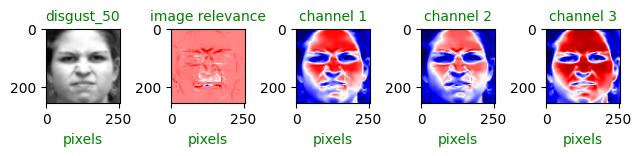

KeyboardInterrupt: ignored

<Figure size 640x480 with 0 Axes>

In [ ]:
n = 1
image_names = []
positive_counts = []
negative_counts = []

for inputs, labels in test_loader:
    inputs = inputs.to(device)
    outputs = model(inputs).max(1).indices.detach().cpu().numpy()
    print(inputs.shape)
    for i in range(inputs.shape[0]):
        image_id = i
        print(image_id)

        try:
            image_relevances = apply_lrp_on_vgg16(model, inputs[image_id])
            image_relevances = image_relevances.permute(0, 2, 3, 1).detach().cpu().numpy()[0]
            image_relevances = np.interp(image_relevances, (image_relevances.min(), image_relevances.max()), (0, 1))
            pixel_relevance_scores = inputs[image_id].detach().cpu().numpy() * np.transpose(image_relevances, (2, 0, 1))
            # print(type(pixel_relevance_scores), len(pixel_relevance_scores))

            pred_label = list(train_dataset.class_to_idx.keys())[list(train_dataset.class_to_idx.values()).index(labels[image_id])]
            image_name = pred_label+'_'+str(n)
            n += 1
            # Add condition to process images only for the specified emotion class
            # if pred_label == emotion_class:
            print(outputs[image_id], "and", labels[image_id])
            if outputs[image_id] == labels[image_id]:
                print("Groundtruth for this image:", pred_label)
                plt.axis('off')
                plt.gca().remove()

                plt.subplot(1, 5, 1)
                plt.imshow(inputs[image_id].permute(1, 2, 0).detach().cpu().numpy())
                plt.title(image_name, fontdict={'fontsize': 10, 'color': 'green'})
                plt.xlabel('pixels', fontdict={'fontsize': 10, 'color': 'green'})

                plt.subplot(1, 5, 2)
                plt.imshow(image_relevances[:, :, 0], cmap="seismic")
                plt.title("image relevance", fontdict={'fontsize': 10, 'color': 'green'})
                plt.xlabel('pixels', fontdict={'fontsize': 10, 'color': 'green'})


                plt.subplot(1, 5, 3)
                plt.imshow(pixel_relevance_scores[0], cmap="seismic")
                plt.title("channel 1", fontdict={'fontsize': 10, 'color': 'green'})
                plt.xlabel('pixels', fontdict={'fontsize': 10, 'color': 'green'})


                plt.subplot(1, 5, 4)
                plt.imshow(pixel_relevance_scores[1], cmap="seismic")
                plt.title("channel 2", fontdict={'fontsize': 10, 'color': 'green'})
                plt.xlabel('pixels', fontdict={'fontsize': 10, 'color': 'green'})


                plt.subplot(1, 5, 5)
                plt.imshow(pixel_relevance_scores[2], cmap="seismic")
                plt.title("channel 3", fontdict={'fontsize': 10, 'color': 'green'})
                plt.xlabel('pixels', fontdict={'fontsize': 10, 'color': 'green'})


                plt.tight_layout()
                plt.show()
                plt.clf()

                # print(contributed_pixels_count(0, pixel_relevance_scores))
                p, z = contributed_pixels_count(1, pixel_relevance_scores)
                # print(contributed_pixels_count(2, pixel_relevance_scores))

                image_names.append(image_name)
                positive_counts.append(p)
                negative_counts.append(z)

                print(image_names, positive_counts, negative_counts, sep="|")

        except TypeError:
            print("Not a sequence ..")
            continue

### Play with results

In [ ]:
import pickle

my_image_data = [image_names, positive_counts, negative_counts]
# Serialize list object and write to file
with open('drive/MyDrive/list_values.pkl', 'wb') as file:
    pickle.dump(my_image_data, file)


In [ ]:
data = zip(image_names, positive_counts, negative_counts)

In [ ]:
from prettytable import PrettyTable

# Define the table
table = PrettyTable()
table.field_names = ["Image Name", "P_counts", "Z_counts"]
for a,b,c in data:
    table.add_row([a, b, c])

# Set the table border style
table.border = True

# Print the table
print(table)


In [ ]:
import pickle

# Unpickle the file
with open('drive/MyDrive/list_values.pkl', 'rb') as file:
    unpickled_data = pickle.load(file)

# Retrieve the data from the unpickled object
image_names, positive_counts, negative_counts = unpickled_data

# Print the retrieved data1
print("Image Names:", image_names)
print("Positive Counts:", positive_counts)
print("Negative Counts:", negative_counts)


Image Names: ['happy_0', 'contempt_1', 'happy_2', 'fear_4', 'surprise_5', 'surprise_6', 'surprise_7', 'disgust_8', 'surprise_9', 'sadness_10', 'disgust_11', 'disgust_12', 'disgust_13', 'sadness_15', 'happy_16', 'surprise_17', 'happy_18', 'happy_19', 'disgust_20', 'happy_21', 'surprise_22', 'disgust_23', 'surprise_25', 'disgust_26', 'disgust_27', 'contempt_28', 'happy_29', 'disgust_30', 'disgust_31', 'surprise_32', 'happy_33', 'sadness_34', 'surprise_35', 'surprise_37', 'disgust_38', 'fear_39', 'disgust_41', 'surprise_43', 'surprise_44', 'disgust_45', 'fear_46', 'happy_47', 'happy_48', 'fear_49', 'contempt_50', 'sadness_52', 'happy_53', 'fear_54', 'surprise_55', 'surprise_56', 'happy_57', 'disgust_58', 'happy_59', 'disgust_60', 'fear_61', 'happy_63', 'surprise_0', 'sadness_1', 'happy_2', 'disgust_3', 'disgust_4', 'surprise_5', 'surprise_6', 'surprise_7', 'happy_9', 'sadness_11', 'surprise_12', 'contempt_13', 'happy_14', 'disgust_15', 'happy_17', 'happy_19', 'surprise_20', 'surprise_21',

In [ ]:
# Original lists
list1 = image_names
list2 = positive_counts
list3 = negative_counts

# Sort list1 and obtain the corresponding sorted indices
sorted_indices = sorted(range(len(list3)), key=lambda i: list3[i])

# Sort all lists based on the sorted indices
sorted_list1 = [list1[i] for i in sorted_indices]
sorted_list2 = [list2[i] for i in sorted_indices]
sorted_list3 = [list3[i] for i in sorted_indices]

# Print the sorted lists
print(sorted_list1)  # [1, 2, 3]
print(sorted_list2)  # ['A', 'B', 'C']
print(sorted_list3)  # [7, 8, 9]


['disgust_31', 'sadness_15', 'surprise_15', 'sadness_36', 'fear_6', 'surprise_2', 'sadness_59', 'surprise_5', 'surprise_6', 'sadness_10', 'disgust_11', 'disgust_12', 'sadness_15', 'happy_18', 'disgust_23', 'contempt_28', 'disgust_30', 'sadness_34', 'surprise_35', 'fear_39', 'surprise_43', 'fear_46', 'happy_47', 'fear_49', 'contempt_50', 'sadness_52', 'happy_53', 'fear_54', 'surprise_55', 'surprise_56', 'happy_57', 'disgust_58', 'happy_59', 'disgust_60', 'happy_63', 'sadness_1', 'surprise_5', 'surprise_6', 'sadness_11', 'surprise_12', 'contempt_13', 'happy_14', 'disgust_15', 'happy_17', 'surprise_20', 'surprise_21', 'surprise_22', 'disgust_24', 'contempt_26', 'happy_31', 'happy_33', 'happy_35', 'surprise_36', 'sadness_37', 'surprise_38', 'disgust_41', 'surprise_42', 'surprise_43', 'sadness_50', 'surprise_51', 'surprise_53', 'sadness_54', 'contempt_58', 'disgust_59', 'fear_62', 'surprise_63', 'happy_0', 'surprise_2', 'surprise_7', 'happy_11', 'sadness_12', 'happy_13', 'disgust_17', 'surp

In [ ]:
sorted_data = zip(sorted_list1, sorted_list2, sorted_list3)

In [ ]:
from prettytable import PrettyTable

# Define the table
table = PrettyTable()
table.field_names = ["Image Name", "P_counts", "Z_counts"]
for a,b,c in sorted_data:
    table.add_row([a, b, c])

# Set the table border style
table.border = True

# Print the table
print(table)

#### test

In [ ]:
def get_pixel_count_in_range(array):
  array = array.flatten()
  count_range = []
  for i in range(10):
    x, y = i/10, (i+1)/10
    # Count the number of values in the range
    count = np.count_nonzero(np.logical_and(array > x, array <= y))

    # Print the count
    print("Contribution of pixels in the range [",x,y,"] is : ", count)
    count_range.append(count)
  return count_range

In [ ]:
def calculate_range_by_mean5(array):
  pixel_count_in_range = get_pixel_count_in_range(array)
  m1 = sum(pixel_count_in_range[:5])
  m2 = sum(pixel_count_in_range[3:8])
  m3 = sum(pixel_count_in_range[5:])

  lmh = ["Low", "Medium", "High"]
  lmhv = [m1, m2, m3]

  intensity = lmh[lmhv.index(max(lmhv))]
  # print(intensity)
  return intensity


In [ ]:
emotion_class = 'happy'  # Specify the emotion class for which you want to generate relevance scores

folder_path = '/content/drive/MyDrive/hm'
n = 1
image_names = []
positive = []
negative_counts = []
relevance_scores = []

for inputs, labels in train_loader:
    inputs = inputs.to(device)
    outputs = model(inputs).max(1).indices.detach().cpu().numpy()
    for i in range(inputs.shape[0]):
        image_id = i

        try:
            image_relevances = apply_lrp_on_vgg16(model, inputs[image_id])
            image_relevances = image_relevances.permute(0, 2, 3, 1).detach().cpu().numpy()[0]
            image_relevances = np.interp(image_relevances, (image_relevances.min(), image_relevances.max()), (0, 1))
            image_relevances_transposed = np.transpose(image_relevances, (2, 0, 1))
            pixel_relevance_scores = inputs[image_id].detach().cpu().numpy() * np.transpose(image_relevances, (2, 0, 1))

            pred_label = list(train_dataset.class_to_idx.keys())[list(train_dataset.class_to_idx.values()).index(labels[image_id])]
            image_name = pred_label + '_' + str(n)
            n += 1
            # Add condition to process images only for the specified emotion class
            if pred_label == emotion_class:
                if outputs[image_id] == labels[image_id]:
                    print("Groundtruth for this image:", pred_label)
                    plt.clf()  # Clear the previous figure

                    plt.subplot(1, 5, 1)
                    plt.imshow(inputs[image_id].permute(1, 2, 0).detach().cpu().numpy())
                    plt.title(image_name)

                    plt.subplot(1, 5, 2)
                    plt.imshow(image_relevances[:, :, 0], cmap="seismic")
                    plt.title("Image Relevance")

                    plt.subplot(1, 5, 3)
                    plt.imshow(pixel_relevance_scores[0], cmap="seismic")
                    plt.title("Channel 1")

                    plt.subplot(1, 5, 4)
                    plt.imshow(pixel_relevance_scores[1], cmap="seismic")
                    plt.title("Channel 2")

                    plt.subplot(1, 5, 5)
                    plt.imshow(pixel_relevance_scores[2], cmap="seismic")
                    plt.title("Channel 3")

                    plt.tight_layout()
                    plt.show()

                    p, z = contributed_pixels_count(1, pixel_relevance_scores)
                    image_names.append(image_name)
                    positive_counts.append(p)
                    negative_counts.append(z)
                    relevance_scores.append(image_relevances)
                    print("-------------------------------------------------------------------------------------------------------")
                    # print((image_relevances.shape))
                    intensity = calculate_range_by_mean5(image_relevances)
                    print(intensity+" "+pred_label)
                    print("-------------------------------------------------------------------------------------------------------")

        except TypeError:
            continue


In [ ]:
image_relevances[0][0]

array([0.3221357 , 0.32173873, 0.32195615])

In [ ]:
!rm -r '/content/drive/MyDrive/hm'

In [ ]:
!mkdir '/content/drive/MyDrive/hm'

# JAFFE

### Preparation

In [ ]:
# !kaggle datasets download -d aymenboulila2/jaffe10

In [ ]:
# !unzip jaffe10.zip

In [ ]:
!kaggle datasets download -d ahtcmstp/jaffe2021

 79% 3.00M/3.78M [00:00<00:00, 5.62MB/s]
100% 3.78M/3.78M [00:00<00:00, 5.77MB/s]


In [ ]:
!unzip jaffe2021.zip

Archive:  jaffe2021.zip
  inflating: Jaffe-20211229/Data_Images/Training/Anger/Images0.jpeg  
  inflating: Jaffe-20211229/Data_Images/Training/Anger/Images1.jpeg  
  inflating: Jaffe-20211229/Data_Images/Training/Anger/Images10.jpeg  
  inflating: Jaffe-20211229/Data_Images/Training/Anger/Images11.jpeg  
  inflating: Jaffe-20211229/Data_Images/Training/Anger/Images12.jpeg  
  inflating: Jaffe-20211229/Data_Images/Training/Anger/Images13.jpeg  
  inflating: Jaffe-20211229/Data_Images/Training/Anger/Images14.jpeg  
  inflating: Jaffe-20211229/Data_Images/Training/Anger/Images15.jpeg  
  inflating: Jaffe-20211229/Data_Images/Training/Anger/Images16.jpeg  
  inflating: Jaffe-20211229/Data_Images/Training/Anger/Images17.jpeg  
  inflating: Jaffe-20211229/Data_Images/Training/Anger/Images18.jpeg  
  inflating: Jaffe-20211229/Data_Images/Training/Anger/Images19.jpeg  
  inflating: Jaffe-20211229/Data_Images/Training/Anger/Images2.jpeg  
  inflating: Jaffe-20211229/Data_Images/Training/Anger/I

In [ ]:
jaffee_dataset = '/content/Jaffe-20211229/Data_Images/Training'

### Pre-processing

In [ ]:
# Auxiliary function for data distribution visualization
import cv2
def data_visualization(classes, data):
    # Define the color scheme for the bar graph
    colors = ['orange','red', 'blue', 'green', 'yellow', 'purple',  'violet']
    fig, ax = plt.subplots(figsize=(6, 3))
    ax.bar(classes, data, color=colors)
    ax.set(title="Dataset's distribution for each Emotion class")
    ax.set(xlabel="Emotions", ylabel="#Images");
    ax.grid()


def load_data(data_path):
    subfolders_ck = os.listdir(data_path)

    print("[INFO] Dataset Loading...\n")

    img_data_list=[]
    labels_list = []
    num_images_per_class = []

    for category in subfolders_ck:
        img_list=os.listdir(data_path +'/'+ category)

        print('Loading :', len(img_list), 'images of category', category)
        for img in img_list:
            # Load an image from this path
            pixels=cv2.imread(data_path + '/'+ category + '/'+ img, cv2.IMREAD_GRAYSCALE)
            face_array=cv2.resize(pixels, None, fx=1, fy=1,interpolation = cv2.INTER_CUBIC)

            img_data_list.append(face_array)
            labels_list.append(category)

        num_images_per_class.append(len(img_list))

    le = LabelEncoder()
    labels = le.fit_transform(labels_list)
    # labels = to_categorical(labels, 7)
    data = np.array(img_data_list)

    data_visualization(subfolders_ck, num_images_per_class)

    # Dataset Summary
    # print("\nTotal number of uploaded data:", data.shape[0], ", with data shape", (data.shape[1],data.shape[2],data.shape[3]))
    print("\nTotal number of uploaded data:", data.shape[0],", ", data.shape)


    return data, labels

[INFO] Dataset Loading...

Loading : 22 images of category Fear
Loading : 21 images of category Sadness
Loading : 23 images of category Happiness
Loading : 22 images of category Anger
Loading : 20 images of category Disgust
Loading : 22 images of category Neutral
Loading : 20 images of category Surprise

Total number of uploaded data: 150 ,  (150, 224, 224)


(150,)

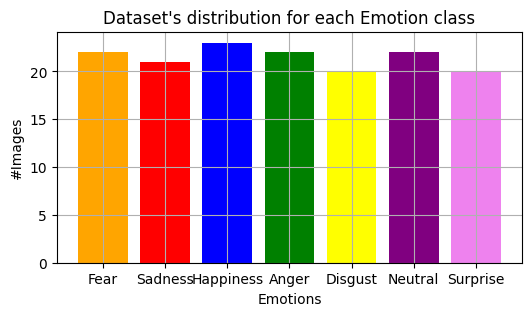

In [ ]:
data_path_ck = jaffee_dataset
data, labels = load_data(data_path_ck)
l = labels
l.shape

In [ ]:
from sklearn.model_selection import train_test_split

# first split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.2, random_state=42)

In [ ]:
from tensorflow.keras.utils import to_categorical

# Convert y_train to categorical
num_classes = 7 # for example, if y_train contains 10 classes

y_train = to_categorical(y_train, num_classes)
y_test = to_categorical(y_test, num_classes)

In [ ]:
X_train.shape, y_train.shape,  X_test.shape, y_test.shape

((120, 224, 224), (120, 7), (30, 224, 224), (30, 7))

In [ ]:
import torchvision.transforms as transforms
from torch.utils.data import Dataset

x,y = 48, 48

class CustomDataset(Dataset):
    def __init__(self, data, labels, transform=None):
        self.data = data
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, index):
        x = self.data[index]
        y = self.labels[index]
        if self.transform:
            x = self.transform(x)
        return x, y

train_dataset = CustomDataset(X_train, y_train, transform=transforms.Compose([
                            transforms.Resize((x, y)),
                            transforms.ToTensor()
                        ]))

test_dataset = CustomDataset(X_test, y_test, transform=transforms.Compose([
                            transforms.Resize((x, y)),
                            transforms.ToTensor()
                        ]))


In [ ]:
batch_size = 64
train_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True
)
test_loader = torch.utils.data.DataLoader(
    test_dataset,
    batch_size=batch_size,
    shuffle=True
)

In [ ]:
import os
import shutil
import random

data_dir = jaffee_dataset  # Replace with the actual path to your CKPlus dataset
train_dir = '/content/jtrain_dir'  # Replace with the path where you want to store the training set
test_dir = '/content/jtest_dir'  # Replace with the path where you want to store the testing set
test_ratio = 0.2  # The ratio of data to be used for testing

# Create the train and test directories if they don't exist
os.makedirs(train_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)

# Iterate over the subfolders and randomly assign them to the train or test set
for emo_folder in os.listdir(data_dir):
    emo_path = os.path.join(data_dir, emo_folder)
    if not os.path.isdir(emo_path):
        continue
    images = os.listdir(emo_path)
    num_test = int(len(images) * test_ratio)
    test_images = random.sample(images, num_test)
    for img in images:
        src = os.path.join(emo_path, img)
        if img in test_images:
            dst = os.path.join(test_dir, emo_folder, img)
        else:
            dst = os.path.join(train_dir, emo_folder, img)
        os.makedirs(os.path.dirname(dst), exist_ok=True)
        shutil.copy(src, dst)


In [ ]:
# %% Prepare data for pretrained model
x,y = 224, 224
train_dataset = torchvision.datasets.ImageFolder(
        root='/content/jtrain_dir',
        transform=transforms.Compose([
                      transforms.Resize((x,y)),
                      transforms.ToTensor()
        ])
)

test_dataset = torchvision.datasets.ImageFolder(
        root='/content/jtest_dir',
        transform=transforms.Compose([
                      transforms.Resize((x,y)),
                      transforms.ToTensor()
        ])
)

In [ ]:
batch_size = 16
train_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True
)
test_loader = torch.utils.data.DataLoader(
    test_dataset,
    batch_size=batch_size,
    shuffle=True
)

### Modeling

In [ ]:
class CNNModel(nn.Module):
    def __init__(self):
        super(CNNModel, self).__init__()
        self.vgg16 = models.vgg16(pretrained=True)

        # Replace output layer according to our problem
        in_feats = self.vgg16.classifier[6].in_features
        self.vgg16.classifier[6] = nn.Linear(in_feats, 7)

    def forward(self, x):
        x = self.vgg16(x)
        return x

model = CNNModel()
model.to(device)
model

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:01<00:00, 285MB/s]


CNNModel(
  (vgg16): VGG(
    (features): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): ReLU(inplace=True)
      (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace=True)
      (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (13): ReLU(inplace=True)
      (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (15): ReLU(inplace=True)
      (16):

In [ ]:
# %% Train
cross_entropy_loss = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.00002)
epochs = 30

In [ ]:
# Iterate x epochs over the train data
print_freq = 100  # Print loss and accuracy every 100 iterations

for epoch in range(1, epochs+1):
    total_loss = 0.0
    correct = 0
    total = 0

    for i, batch in enumerate(train_loader, 0):
        inputs, labels = batch
        inputs = inputs.to(device)
        labels = labels.to(device)
        optimizer.zero_grad()
        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)

        # Calculate loss
        loss = cross_entropy_loss(outputs, labels)
        loss.backward()
        optimizer.step()

        # Update statistics
        total_loss += loss.item()
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

        # Print loss and accuracy every x iterations
        # if (i+1) % print_freq == 0:
        avg_loss = total_loss / print_freq
        accuracy = 100.0 * correct / total
        print(f'Epoch [{epoch}/{epochs}], Iteration [{i+1}/{len(train_loader)}], Loss: {avg_loss:.4f}, Accuracy: {accuracy:.2f}%')
        total_loss = 0.0
        correct = 0
        total = 0

Epoch [1/30], Iteration [1/8], Loss: 0.0000, Accuracy: 100.00%
Epoch [1/30], Iteration [2/8], Loss: 0.0023, Accuracy: 93.75%
Epoch [1/30], Iteration [3/8], Loss: 0.0001, Accuracy: 100.00%
Epoch [1/30], Iteration [4/8], Loss: 0.0003, Accuracy: 100.00%
Epoch [1/30], Iteration [5/8], Loss: 0.0002, Accuracy: 100.00%
Epoch [1/30], Iteration [6/8], Loss: 0.0039, Accuracy: 87.50%
Epoch [1/30], Iteration [7/8], Loss: 0.0018, Accuracy: 87.50%
Epoch [1/30], Iteration [8/8], Loss: 0.0001, Accuracy: 100.00%
Epoch [2/30], Iteration [1/8], Loss: 0.0002, Accuracy: 100.00%
Epoch [2/30], Iteration [2/8], Loss: 0.0002, Accuracy: 100.00%
Epoch [2/30], Iteration [3/8], Loss: 0.0003, Accuracy: 100.00%
Epoch [2/30], Iteration [4/8], Loss: 0.0003, Accuracy: 100.00%
Epoch [2/30], Iteration [5/8], Loss: 0.0013, Accuracy: 93.75%
Epoch [2/30], Iteration [6/8], Loss: 0.0005, Accuracy: 100.00%
Epoch [2/30], Iteration [7/8], Loss: 0.0001, Accuracy: 100.00%
Epoch [2/30], Iteration [8/8], Loss: 0.0003, Accuracy: 100.

In [ ]:
# Save your model to Google Drive
torch.save(model.state_dict(), '/content/drive/MyDrive/mJaffe_model_30Epo.pth')

### Evaluation

In [ ]:
model.load_state_dict(torch.load("/content/drive/MyDrive/mJaffe_model_50Epo.pth"))

<All keys matched successfully>

In [ ]:
import torch

model.eval()  # Set the model to evaluation mode

# Rest of your testing code
test_loss = 0
correct = 0
total = 0

with torch.no_grad():
    for batch in test_loader:
        inputs, labels = batch
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)

        total += labels.size(0)
        correct += (predicted == labels).sum().item()

        loss = cross_entropy_loss(outputs, labels)
        test_loss += loss.item()

    test_loss /= len(test_loader)
    accuracy = 100 * correct / total

    print(f"Test Loss: {test_loss:.4f}")
    print(f"Test Accuracy: {accuracy:.2f}%")


Test Loss: 1.2782
Test Accuracy: 92.86%


### Confusion Matrix

Test Loss: 1.1306
Test Accuracy: 92.86%


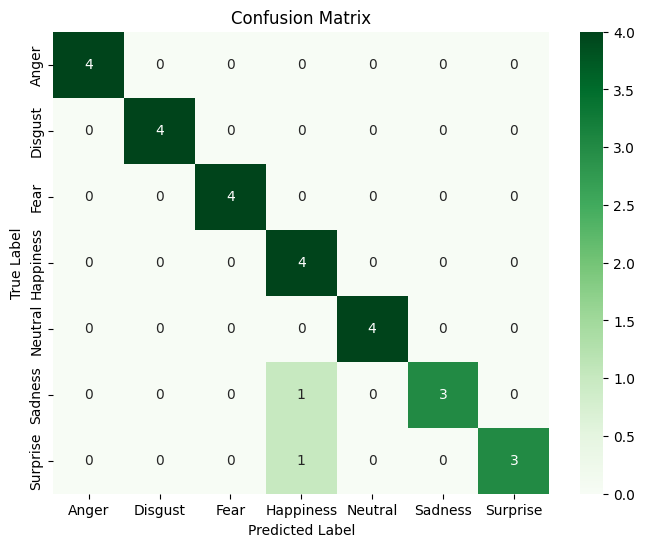

In [ ]:
import torch
import numpy as np
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Rest of your testing code
test_loss = 0
correct = 0
total = 0
all_predicted = []
all_labels = []

with torch.no_grad():
    for batch in test_loader:
        inputs, labels = batch
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)

        total += labels.size(0)
        correct += (predicted == labels).sum().item()

        loss = cross_entropy_loss(outputs, labels)
        test_loss += loss.item()

        all_predicted.extend(predicted.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    test_loss /= len(test_loader)
    accuracy = 100 * correct / total

    print(f"Test Loss: {test_loss:.4f}")
    print(f"Test Accuracy: {accuracy:.2f}%")

# Calculate the confusion matrix
cm = confusion_matrix(all_labels, all_predicted)

classes = list(train_dataset.class_to_idx.keys())
def plot_confusion_matrix(cm, classes, title='Confusion Matrix', cmap=None):
    plt.figure(figsize=(8, 6))
    if cmap is None:
        cmap = plt.get_cmap('Greens')
    sns.heatmap(cm, annot=True, fmt='d', cmap=cmap, xticklabels=classes, yticklabels=classes)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title(title)
    plt.show()

# Assuming you already have the confusion matrix 'cm' and the class labels 'classes'
plot_confusion_matrix(cm, classes)


In [ ]:
import matplotlib.pyplot as plt

def generate_heatmap(pixel_relevance_scores):
    # Normalize the relevance scores between 0 and 1
    normalized_scores = (pixel_relevance_scores - np.min(pixel_relevance_scores)) / (np.max(pixel_relevance_scores) - np.min(pixel_relevance_scores))

    # Create the heatmap using the normalized relevance scores
    heatmap = plt.imshow(normalized_scores, cmap='jet')

    # Add a colorbar to the heatmap
    plt.colorbar(heatmap)

    # Show the generated heatmap
    plt.show()


In [ ]:

# %% Inspect predictions for first batch test/train loader
import pandas as pd

inputs, labels = next(iter(test_loader))
# inputs, labels = next(iter(train_loader))
inputs = inputs.to(device)
labels = labels.numpy()
outputs = model(inputs).max(1).indices.detach().cpu().numpy()

comparison = pd.DataFrame()
print("Batch predictions:")
print(outputs)

comparison["actual"] = labels
comparison["predicted"] = outputs

print("\nComparison:")
print(comparison)

Batch predictions:
[5 6 6 2 2 5 2 0 4 0 6 6 4 3 3 0]

Comparison:
    actual  predicted
0        1          5
1        6          6
2        6          6
3        1          2
4        2          2
5        1          5
6        2          2
7        0          0
8        4          4
9        1          0
10       6          6
11       6          6
12       4          4
13       3          3
14       5          3
15       0          0


### LRP on VGG16

In [ ]:
def new_layer(layer, g):
    """Clone a layer and pass its parameters through the function g."""
    layer = copy.deepcopy(layer)
    try: layer.weight = torch.nn.Parameter(g(layer.weight))
    except AttributeError: pass
    try: layer.bias = torch.nn.Parameter(g(layer.bias))
    except AttributeError: pass
    return layer

In [ ]:
def dense_to_conv(layers):
    """ Converts a dense layer to a conv layer """
    newlayers = []
    for i,layer in enumerate(layers):
        if isinstance(layer, nn.Linear):
            newlayer = None
            if i == 0:
                m, n = 512, layer.weight.shape[0]
                newlayer = nn.Conv2d(m,n,7)
                newlayer.weight = nn.Parameter(layer.weight.reshape(n,m,7,7))
            else:
                m,n = layer.weight.shape[1],layer.weight.shape[0]
                newlayer = nn.Conv2d(m,n,1)
                newlayer.weight = nn.Parameter(layer.weight.reshape(n,m,1,1))
            newlayer.bias = nn.Parameter(layer.bias)
            newlayers += [newlayer]
        else:
            newlayers += [layer]
    return newlayers

In [ ]:
def get_linear_layer_indices(model):
    offset = len(model.vgg16._modules['features']) + 1
    indices = []
    for i, layer in enumerate(model.vgg16._modules['classifier']):
        if isinstance(layer, nn.Linear):
            indices.append(i)
    indices = [offset + val for val in indices]
    return indices

In [ ]:
def apply_lrp_on_vgg16(model, image):
    image = torch.unsqueeze(image, 0)
    # >>> Step 1: Extract layers
    layers = list(model.vgg16._modules['features']) \
                + [model.vgg16._modules['avgpool']] \
                + dense_to_conv(list(model.vgg16._modules['classifier']))
    linear_layer_indices = get_linear_layer_indices(model)
    # >>> Step 2: Propagate image through layers and store activations
    n_layers = len(layers)
    activations = [image] + [None] * n_layers # list of activations

    for layer in range(n_layers):
        if layer in linear_layer_indices:
            if layer == 32:
                activations[layer] = activations[layer].reshape((1, 512, 7, 7))
        activation = layers[layer].forward(activations[layer])
        if isinstance(layers[layer], torch.nn.modules.pooling.AdaptiveAvgPool2d):
            activation = torch.flatten(activation, start_dim=1)
        activations[layer+1] = activation

    # >>> Step 3: Replace last layer with one-hot-encoding
    output_activation = activations[-1].detach().cpu().numpy()
    max_activation = output_activation.max()
    one_hot_output = [val if val == max_activation else 0
                        for val in output_activation[0]]

    activations[-1] = torch.FloatTensor([one_hot_output]).to(device)

    # >>> Step 4: Backpropagate relevance scores
    relevances = [None] * n_layers + [activations[-1]]
    # Iterate over the layers in reverse order
    for layer in range(0, n_layers)[::-1]:
        current = layers[layer]
        # Treat max pooling layers as avg pooling
        if isinstance(current, torch.nn.MaxPool2d):
            layers[layer] = torch.nn.AvgPool2d(2)
            current = layers[layer]
        if isinstance(current, torch.nn.Conv2d) or \
           isinstance(current, torch.nn.AvgPool2d) or\
           isinstance(current, torch.nn.Linear):
            activations[layer] = activations[layer].data.requires_grad_(True)

            # Apply variants of LRP depending on the depth
            # see: https://link.springer.com/chapter/10.1007%2F978-3-030-28954-6_10
            # Lower layers, LRP-gamma >> Favor positive contributions (activations)
            if layer <= 16:       rho = lambda p: p + 0.25*p.clamp(min=0); incr = lambda z: z+1e-9
            # Middle layers, LRP-epsilon >> Remove some noise / Only most salient factors survive
            if 17 <= layer <= 30: rho = lambda p: p;                       incr = lambda z: z+1e-9+0.25*((z**2).mean()**.5).data
            # Upper Layers, LRP-0 >> Basic rule
            if layer >= 31:       rho = lambda p: p;                       incr = lambda z: z+1e-9

            # Transform weights of layer and execute forward pass
            z = incr(new_layer(layers[layer],rho).forward(activations[layer]))
            # Element-wise division between relevance of the next layer and z
            s = (relevances[layer+1]/z).data
            # Calculate the gradient and multiply it by the activation
            (z * s).sum().backward();
            c = activations[layer].grad
            # Assign new relevance values
            relevances[layer] = (activations[layer]*c).data
        else:
            relevances[layer] = relevances[layer+1]

    # >>> Potential Step 5: Apply different propagation rule for pixels
    return relevances[0]

In [ ]:
def get_pixel_count_in_range(array):
  array = array.flatten()
  count_range = []
  for i in range(10):
    x, y = i/10, (i+1)/10
    # Count the number of values in the range
    count = np.count_nonzero(np.logical_and(array > x, array <= y))

    # Print the count
    print("Contribution of pixels in the range [",x,y,"] is : ", count)
    count_range.append(count)
  return count_range

In [ ]:
def calculate_range_by_mean5(array):
  pixel_count_in_range = get_pixel_count_in_range(array)
  m1 = sum(pixel_count_in_range[:5])
  m2 = sum(pixel_count_in_range[3:8])
  m3 = sum(pixel_count_in_range[5:])

  lmh = ["Low", "Medium", "High"]
  lmhv = [m1, m2, m3]

  intensity = lmh[lmhv.index(max(lmhv))]
  # print(intensity)
  return intensity


In [ ]:
# emotion_class = 'happy'  # Specify the emotion class for which you want to generate relevance scores

folder_path = '/content/drive/MyDrive/hm'
n = 1
image_names = []
positive = []
negative_counts = []
relevance_scores = []

for inputs, labels in train_loader:
    inputs = inputs.to(device)
    outputs = model(inputs).max(1).indices.detach().cpu().numpy()
    for i in range(inputs.shape[0]):
        image_id = i

        try:
            image_relevances = apply_lrp_on_vgg16(model, inputs[image_id])
            # image_relevances = calculate_relevance(model, inputs[image_id])
            image_relevances = image_relevances.permute(0, 2, 3, 1).detach().cpu().numpy()[0]
            image_relevances = np.interp(image_relevances, (image_relevances.min(), image_relevances.max()), (0, 1))
            image_relevances_transposed = np.transpose(image_relevances, (2, 0, 1))
            pixel_relevance_scores = inputs[image_id].detach().cpu().numpy() * np.transpose(image_relevances, (2, 0, 1))

            pred_label = list(train_dataset.class_to_idx.keys())[list(train_dataset.class_to_idx.values()).index(labels[image_id])]
            image_name = pred_label + '_' + str(n)
            n += 1
            # Add condition to process images only for the specified emotion class
            # if pred_label == emotion_class:
            if outputs[image_id] == labels[image_id]:
                print("Groundtruth for this image:", pred_label)
                plt.clf()  # Clear the previous figure

                plt.subplot(1, 5, 1)
                plt.imshow(inputs[image_id].permute(1, 2, 0).detach().cpu().numpy())
                plt.title(image_name)

                plt.subplot(1, 5, 2)
                plt.imshow(image_relevances[:, :, 0], cmap="seismic")
                plt.title("Image Relevance")

                plt.subplot(1, 5, 3)
                plt.imshow(pixel_relevance_scores[0], cmap="seismic")
                plt.title("Channel 1")

                plt.subplot(1, 5, 4)
                plt.imshow(pixel_relevance_scores[1], cmap="seismic")
                plt.title("Channel 2")

                plt.subplot(1, 5, 5)
                plt.imshow(pixel_relevance_scores[2], cmap="seismic")
                plt.title("Channel 3")

                plt.tight_layout()
                plt.show()

                # p, z = contributed_pixels_count(1, pixel_relevance_scores)
                # image_names.append(image_name)
                # positive_counts.append(p)
                # negative_counts.append(z)
                # relevance_scores.append(image_relevances)
                print("-------------------------------------------------------------------------------------------------------")
                # print((image_relevances.shape))
                intensity = calculate_range_by_mean5(image_relevances[1])
                print(intensity+" "+pred_label)
                print("-------------------------------------------------------------------------------------------------------")

        except TypeError:
            continue


NameError: ignored

torch.Size([16, 3, 224, 224])
0
6 and tensor(6)
Groundtruth for this image: Surprise


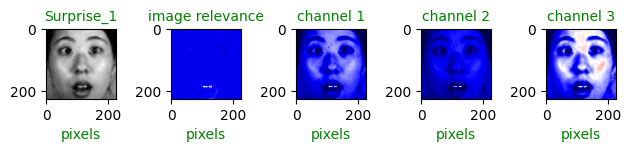

['Surprise_1']|[64960]|[65]
1
5 and tensor(5)
Groundtruth for this image: Sadness


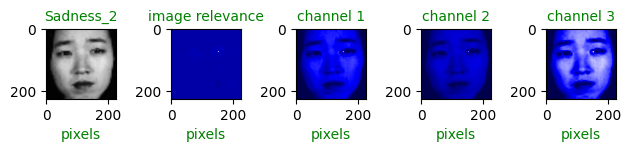

['Surprise_1', 'Sadness_2']|[64960, 64960]|[65, 65]
2
3 and tensor(3)
Groundtruth for this image: Happiness


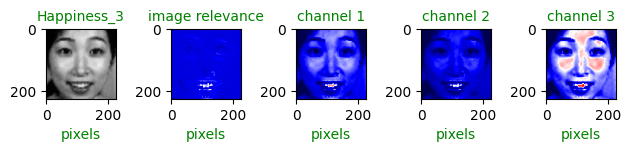

['Surprise_1', 'Sadness_2', 'Happiness_3']|[64960, 64960, 64960]|[65, 65, 65]
3
2 and tensor(2)
Groundtruth for this image: Fear


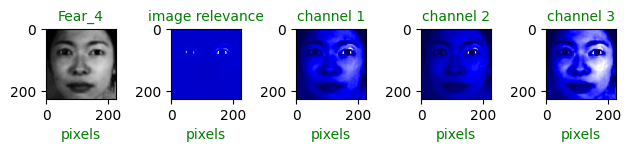

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4']|[64960, 64960, 64960, 64960]|[65, 65, 65, 65]
4
Not a sequence ..
5
4 and tensor(4)
Groundtruth for this image: Neutral


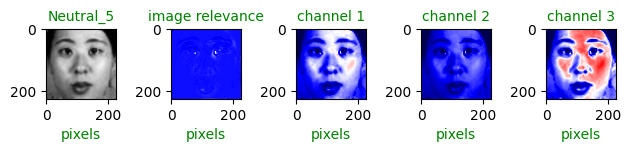

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5']|[64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65]
6
3 and tensor(3)
Groundtruth for this image: Happiness


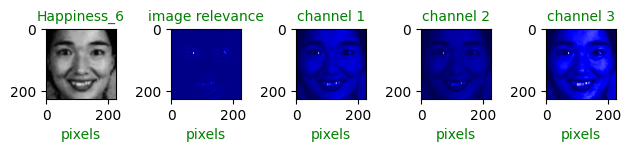

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6']|[64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65]
7
1 and tensor(1)
Groundtruth for this image: Disgust


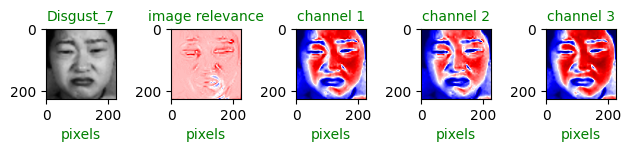

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7']|[64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65]
8
4 and tensor(4)
Groundtruth for this image: Neutral


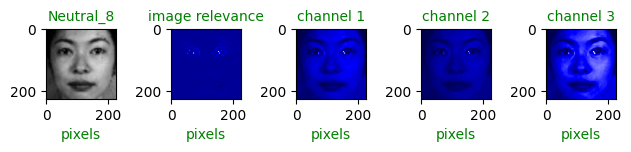

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65]
9
6 and tensor(6)
Groundtruth for this image: Surprise


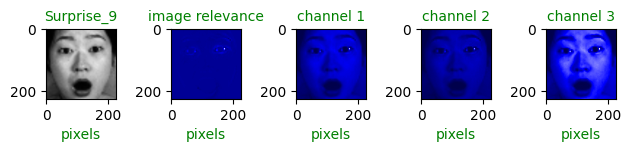

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65]
10
6 and tensor(6)
Groundtruth for this image: Surprise


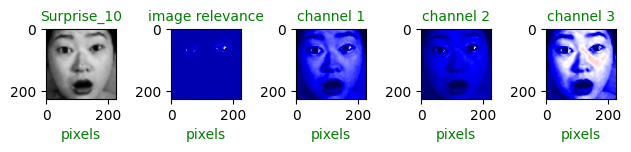

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
11
6 and tensor(6)
Groundtruth for this image: Surprise


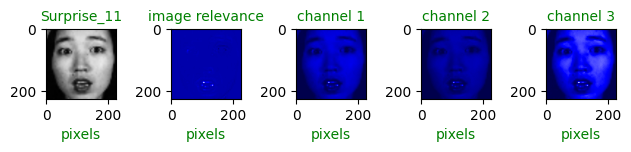

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
12
1 and tensor(1)
Groundtruth for this image: Disgust


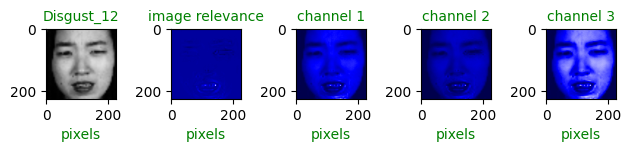

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
13
Not a sequence ..
14
1 and tensor(1)
Groundtruth for this image: Disgust


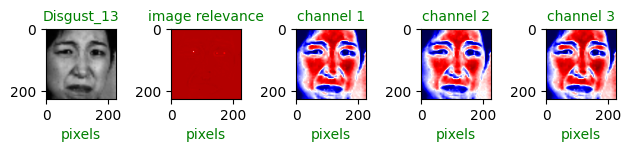

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
15
6 and tensor(6)
Groundtruth for this image: Surprise


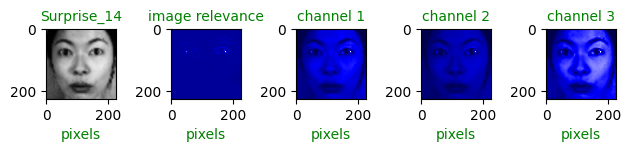

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
torch.Size([16, 3, 224, 224])
0
2 and tensor(2)
Groundtruth for this image: Fear


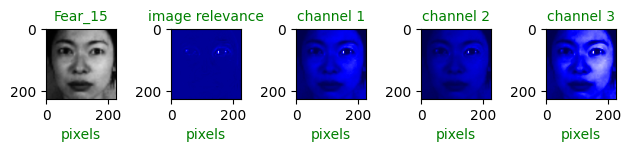

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
1
2 and tensor(2)
Groundtruth for this image: Fear


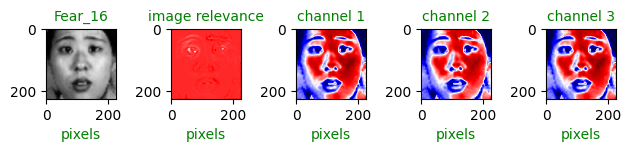

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
2
1 and tensor(5)
3
3 and tensor(3)
Groundtruth for this image: Happiness


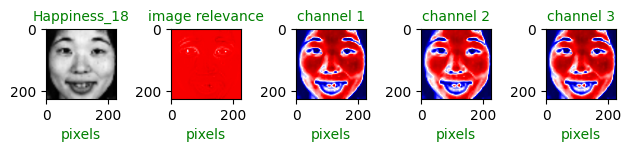

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
4
3 and tensor(3)
Groundtruth for this image: Happiness


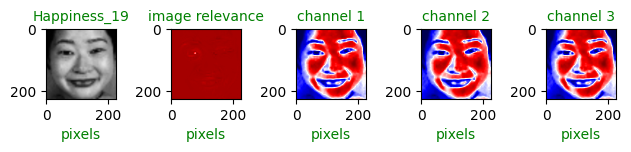

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
5
6 and tensor(6)
Groundtruth for this image: Surprise


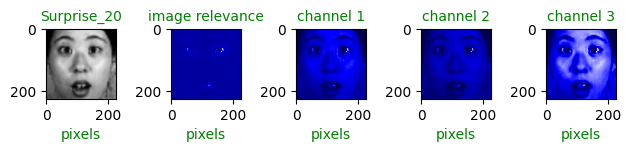

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
6
4 and tensor(4)
Groundtruth for this image: Neutral


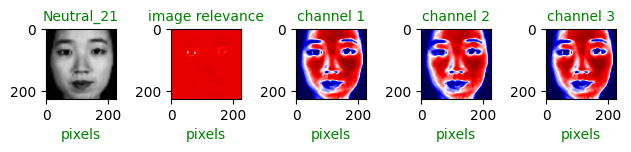

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
7
3 and tensor(3)
Groundtruth for this image: Happiness


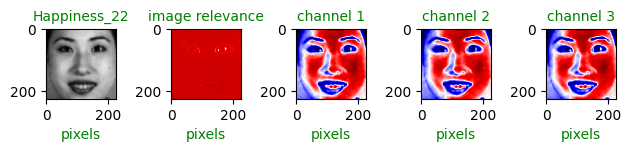

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
8
4 and tensor(4)
Groundtruth for this image: Neutral


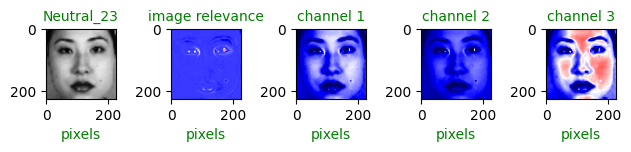

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
9
4 and tensor(4)
Groundtruth for this image: Neutral


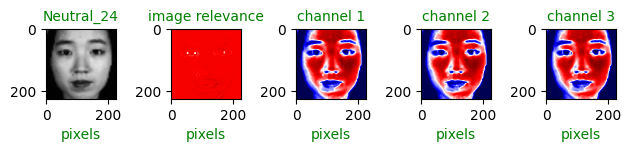

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
10
1 and tensor(1)
Groundtruth for this image: Disgust


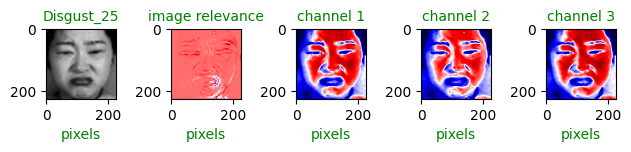

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
11
4 and tensor(4)
Groundtruth for this image: Neutral


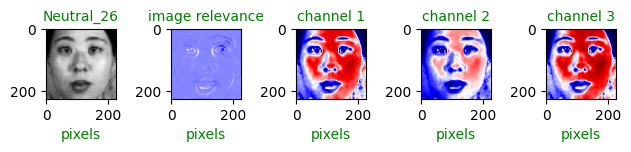

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
12
5 and tensor(5)
Groundtruth for this image: Sadness


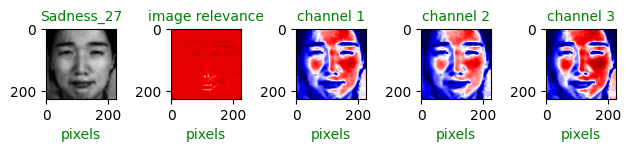

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
13
4 and tensor(4)
Groundtruth for this image: Neutral


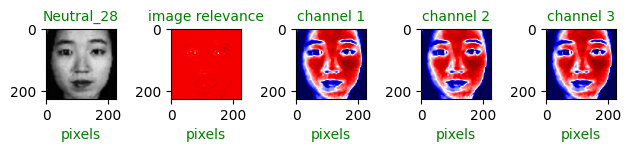

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
14
Not a sequence ..
15
Not a sequence ..
torch.Size([16, 3, 224, 224])
0
5 and tensor(5)
Groundtruth for this image: Sadness


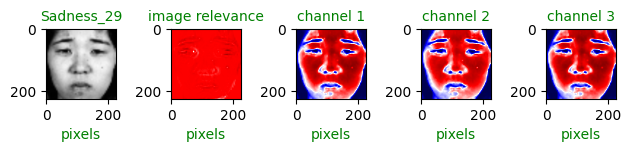

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
1
4 and tensor(4)
Groundtruth for this image: Neutral


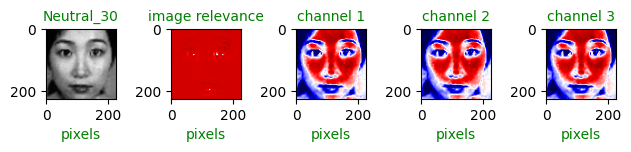

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29', 'Neutral_30']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
2
6 and tensor(6)
Groundtruth for this image: Surprise


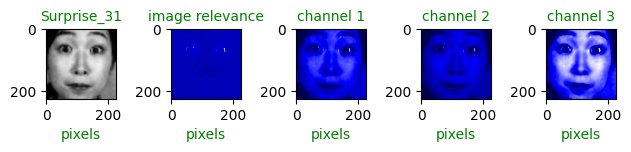

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29', 'Neutral_30', 'Surprise_31']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
3
Not a sequence ..
4
2 and tensor(2)
Groundtruth for this image: Fear


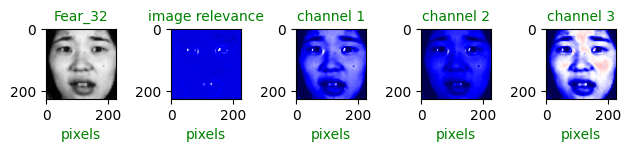

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29', 'Neutral_30', 'Surprise_31', 'Fear_32']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
5
Not a sequence ..
6
5 and tensor(5)
Groundtruth for this image: Sadness


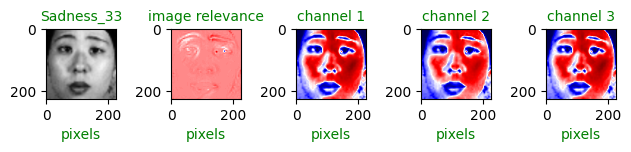

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29', 'Neutral_30', 'Surprise_31', 'Fear_32', 'Sadness_33']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
7
5 and tensor(5)
Groundtruth for this image: Sadness


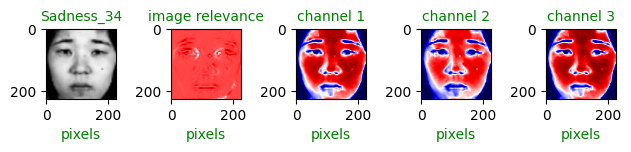

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29', 'Neutral_30', 'Surprise_31', 'Fear_32', 'Sadness_33', 'Sadness_34']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
8
6 and tensor(6)
Groundtruth for this image: Surprise


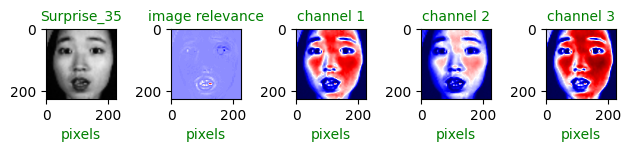

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29', 'Neutral_30', 'Surprise_31', 'Fear_32', 'Sadness_33', 'Sadness_34', 'Surprise_35']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
9
1 and tensor(1)
Groundtruth for this image: Disgust


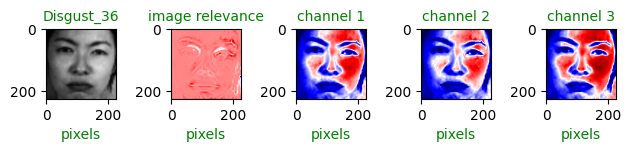

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29', 'Neutral_30', 'Surprise_31', 'Fear_32', 'Sadness_33', 'Sadness_34', 'Surprise_35', 'Disgust_36']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
10
5 and tensor(5)
Groundtruth for this image: Sadness


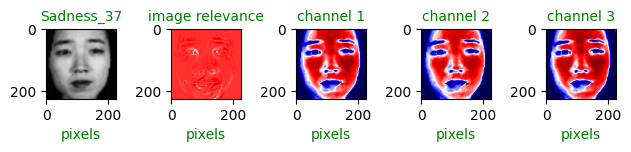

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29', 'Neutral_30', 'Surprise_31', 'Fear_32', 'Sadness_33', 'Sadness_34', 'Surprise_35', 'Disgust_36', 'Sadness_37']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
11
1 and tensor(1)
Groundtruth for this image: Disgust


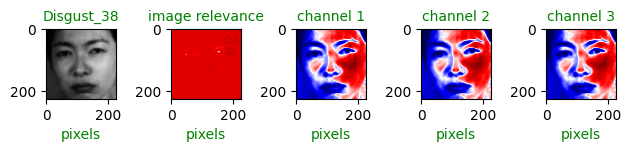

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29', 'Neutral_30', 'Surprise_31', 'Fear_32', 'Sadness_33', 'Sadness_34', 'Surprise_35', 'Disgust_36', 'Sadness_37', 'Disgust_38']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
12
2 and tensor(2)
Groundtruth for this image: Fear


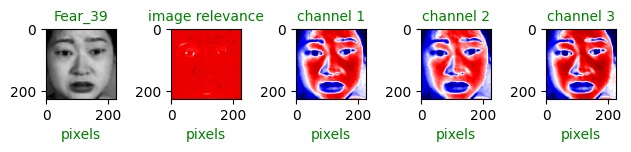

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29', 'Neutral_30', 'Surprise_31', 'Fear_32', 'Sadness_33', 'Sadness_34', 'Surprise_35', 'Disgust_36', 'Sadness_37', 'Disgust_38', 'Fear_39']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
13
5 and tensor(5)
Groundtruth for this image: Sadnes

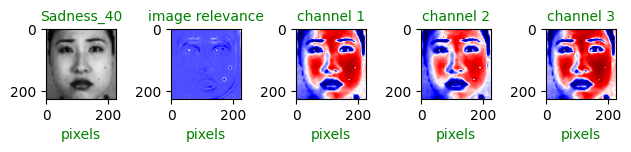

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29', 'Neutral_30', 'Surprise_31', 'Fear_32', 'Sadness_33', 'Sadness_34', 'Surprise_35', 'Disgust_36', 'Sadness_37', 'Disgust_38', 'Fear_39', 'Sadness_40']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
14
1 and tensor(1)
Groundtru

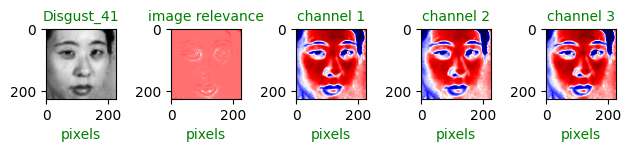

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29', 'Neutral_30', 'Surprise_31', 'Fear_32', 'Sadness_33', 'Sadness_34', 'Surprise_35', 'Disgust_36', 'Sadness_37', 'Disgust_38', 'Fear_39', 'Sadness_40', 'Disgust_41']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
15


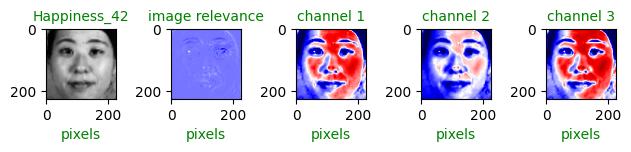

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29', 'Neutral_30', 'Surprise_31', 'Fear_32', 'Sadness_33', 'Sadness_34', 'Surprise_35', 'Disgust_36', 'Sadness_37', 'Disgust_38', 'Fear_39', 'Sadness_40', 'Disgust_41', 'Happiness_42']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 

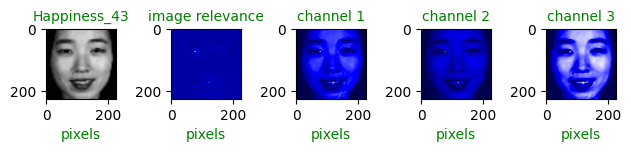

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29', 'Neutral_30', 'Surprise_31', 'Fear_32', 'Sadness_33', 'Sadness_34', 'Surprise_35', 'Disgust_36', 'Sadness_37', 'Disgust_38', 'Fear_39', 'Sadness_40', 'Disgust_41', 'Happiness_42', 'Happiness_43']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 6

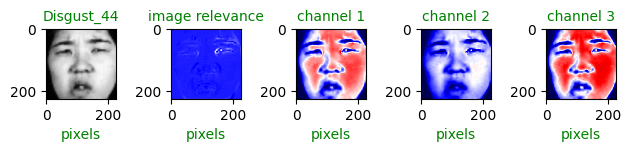

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29', 'Neutral_30', 'Surprise_31', 'Fear_32', 'Sadness_33', 'Sadness_34', 'Surprise_35', 'Disgust_36', 'Sadness_37', 'Disgust_38', 'Fear_39', 'Sadness_40', 'Disgust_41', 'Happiness_42', 'Happiness_43', 'Disgust_44']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 

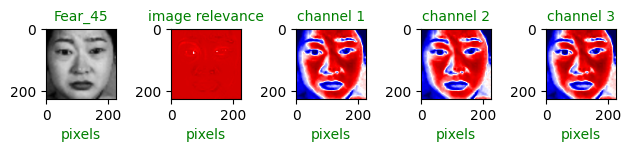

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29', 'Neutral_30', 'Surprise_31', 'Fear_32', 'Sadness_33', 'Sadness_34', 'Surprise_35', 'Disgust_36', 'Sadness_37', 'Disgust_38', 'Fear_39', 'Sadness_40', 'Disgust_41', 'Happiness_42', 'Happiness_43', 'Disgust_44', 'Fear_45']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65

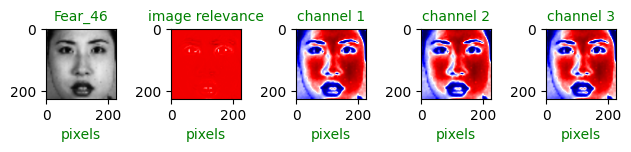

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29', 'Neutral_30', 'Surprise_31', 'Fear_32', 'Sadness_33', 'Sadness_34', 'Surprise_35', 'Disgust_36', 'Sadness_37', 'Disgust_38', 'Fear_39', 'Sadness_40', 'Disgust_41', 'Happiness_42', 'Happiness_43', 'Disgust_44', 'Fear_45', 'Fear_46']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 

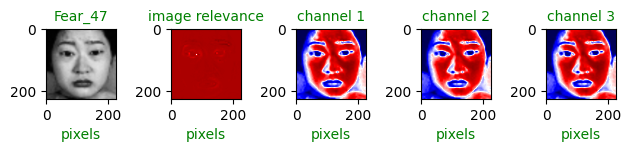

['Surprise_1', 'Sadness_2', 'Happiness_3', 'Fear_4', 'Neutral_5', 'Happiness_6', 'Disgust_7', 'Neutral_8', 'Surprise_9', 'Surprise_10', 'Surprise_11', 'Disgust_12', 'Disgust_13', 'Surprise_14', 'Fear_15', 'Fear_16', 'Happiness_18', 'Happiness_19', 'Surprise_20', 'Neutral_21', 'Happiness_22', 'Neutral_23', 'Neutral_24', 'Disgust_25', 'Neutral_26', 'Sadness_27', 'Neutral_28', 'Sadness_29', 'Neutral_30', 'Surprise_31', 'Fear_32', 'Sadness_33', 'Sadness_34', 'Surprise_35', 'Disgust_36', 'Sadness_37', 'Disgust_38', 'Fear_39', 'Sadness_40', 'Disgust_41', 'Happiness_42', 'Happiness_43', 'Disgust_44', 'Fear_45', 'Fear_46', 'Fear_47']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65

<Figure size 640x480 with 0 Axes>

In [ ]:
# emotion_class = 'happy'  # Specify the emotion class for which you want to generate relevance scores
folder_path = '/content/drive/MyDrive/hm'
n = 1
image_names = []
positive_counts = []
negative_counts = []

for inputs, labels in test_loader:
    inputs = inputs.to(device)
    outputs = model(inputs).max(1).indices.detach().cpu().numpy()
    print(inputs.shape)
    for i in range(inputs.shape[0]):
        image_id = i
        print(image_id)

        try:
            image_relevances = apply_lrp_on_vgg16(model, inputs[image_id])
            image_relevances = image_relevances.permute(0, 2, 3, 1).detach().cpu().numpy()[0]
            image_relevances = np.interp(image_relevances, (image_relevances.min(), image_relevances.max()), (0, 1))
            pixel_relevance_scores = inputs[image_id].detach().cpu().numpy() * np.transpose(image_relevances, (2, 0, 1))
            # print(type(pixel_relevance_scores), len(pixel_relevance_scores))

            pred_label = list(train_dataset.class_to_idx.keys())[list(train_dataset.class_to_idx.values()).index(labels[image_id])]
            image_name = pred_label+'_'+str(n)
            n += 1
            # Add condition to process images only for the specified emotion class
            # if pred_label == emotion_class:
            print(outputs[image_id], "and", labels[image_id])
            if outputs[image_id] == labels[image_id]:
                print("Groundtruth for this image:", pred_label)
                plt.axis('off')
                plt.gca().remove()

                plt.subplot(1, 5, 1)
                plt.imshow(inputs[image_id].permute(1, 2, 0).detach().cpu().numpy())
                plt.title(image_name, fontdict={'fontsize': 10, 'color': 'green'})
                plt.xlabel('pixels', fontdict={'fontsize': 10, 'color': 'green'})

                plt.subplot(1, 5, 2)
                plt.imshow(image_relevances[:, :, 0], cmap="seismic")
                plt.title("image relevance", fontdict={'fontsize': 10, 'color': 'green'})
                plt.xlabel('pixels', fontdict={'fontsize': 10, 'color': 'green'})


                plt.subplot(1, 5, 3)
                plt.imshow(pixel_relevance_scores[0], cmap="seismic")
                plt.title("channel 1", fontdict={'fontsize': 10, 'color': 'green'})
                plt.xlabel('pixels', fontdict={'fontsize': 10, 'color': 'green'})


                plt.subplot(1, 5, 4)
                plt.imshow(pixel_relevance_scores[1], cmap="seismic")
                plt.title("channel 2", fontdict={'fontsize': 10, 'color': 'green'})
                plt.xlabel('pixels', fontdict={'fontsize': 10, 'color': 'green'})


                plt.subplot(1, 5, 5)
                plt.imshow(pixel_relevance_scores[2], cmap="seismic")
                plt.title("channel 3", fontdict={'fontsize': 10, 'color': 'green'})
                plt.xlabel('pixels', fontdict={'fontsize': 10, 'color': 'green'})


                plt.tight_layout()
                plt.show()
                plt.clf()

                # print(contributed_pixels_count(0, pixel_relevance_scores))
                # p, z = contributed_pixels_count(1, pixel_relevance_scores)
                # print(contributed_pixels_count(2, pixel_relevance_scores))

                image_names.append(image_name)
                positive_counts.append(p)
                negative_counts.append(z)

                print(image_names, positive_counts, negative_counts, sep="|")

                # Save the figure in the specified folder
                plt.savefig(f'{folder_path}/{image_name}')
        except TypeError:
            print("Not a sequence ..")
            continue

# KDEF

### Preparation

In [ ]:
!kaggle datasets download -d ankur133047/modified-kdef-facial-expression-dataset

 76% 34.0M/44.7M [00:00<00:00, 192MB/s] 
100% 44.7M/44.7M [00:00<00:00, 148MB/s]


In [ ]:
!unzip modified-kdef-facial-expression-dataset.zip

Archive:  modified-kdef-facial-expression-dataset.zip
  inflating: kdef_pixels.csv         
  inflating: train_kdef/train_kdef/0/AF01NES.png  
  inflating: train_kdef/train_kdef/0/AF02NES.png  
  inflating: train_kdef/train_kdef/0/AF03NES.png  
  inflating: train_kdef/train_kdef/0/AF04NES.png  
  inflating: train_kdef/train_kdef/0/AF05NES.png  
  inflating: train_kdef/train_kdef/0/AF06NES.png  
  inflating: train_kdef/train_kdef/0/AF07NES.png  
  inflating: train_kdef/train_kdef/0/AF08NES.png  
  inflating: train_kdef/train_kdef/0/AF09NES.png  
  inflating: train_kdef/train_kdef/0/AF10NES.png  
  inflating: train_kdef/train_kdef/0/AF11NES.png  
  inflating: train_kdef/train_kdef/0/AF12NES.png  
  inflating: train_kdef/train_kdef/0/AF13NES.png  
  inflating: train_kdef/train_kdef/0/AF14NES.png  
  inflating: train_kdef/train_kdef/0/AF15NES.png  
  inflating: train_kdef/train_kdef/0/AF16NES.png  
  inflating: train_kdef/train_kdef/0/AF17NES.png  
  inflating: train_kdef/train_kdef/0/AF18

In [ ]:
kdef_dataset = '/content/train_kdef/train_kdef'

### Pre-processing

In [ ]:

# Auxiliary function for data distribution visualization
import cv2
def data_visualization(classes, data):
    # Define the color scheme for the bar graph
    colors = ['orange','red', 'blue', 'green', 'yellow', 'purple',  'violet']
    fig, ax = plt.subplots(figsize=(6, 3))
    ax.bar(classes, data, color=colors)
    ax.set(title="Dataset's distribution for each Emotion class")
    ax.set(xlabel="Emotions", ylabel="#Images");
    ax.grid()


def load_data(data_path):
    subfolders_ck = os.listdir(data_path)

    print("[INFO] Dataset Loading...\n")

    img_data_list=[]
    labels_list = []
    num_images_per_class = []

    for category in subfolders_ck:
        img_list=os.listdir(data_path +'/'+ category)

        print('Loading :', len(img_list), 'images of category', category)
        for img in img_list:
            # Load an image from this path
            pixels=cv2.imread(data_path + '/'+ category + '/'+ img, cv2.IMREAD_GRAYSCALE)
            face_array=cv2.resize(pixels, None, fx=1, fy=1,interpolation = cv2.INTER_CUBIC)

            img_data_list.append(face_array)
            labels_list.append(category)

        num_images_per_class.append(len(img_list))

    le = LabelEncoder()
    labels = le.fit_transform(labels_list)
    # labels = to_categorical(labels, 7)
    data = np.array(img_data_list)

    data_visualization(subfolders_ck, num_images_per_class)

    # Dataset Summary
    # print("\nTotal number of uploaded data:", data.shape[0], ", with data shape", (data.shape[1],data.shape[2],data.shape[3]))
    print("\nTotal number of uploaded data:", data.shape[0],", ", data.shape)


    return data, labels

[INFO] Dataset Loading...

Loading : 70 images of category 0
Loading : 70 images of category 2
Loading : 70 images of category 5
Loading : 70 images of category 6
Loading : 70 images of category 3
Loading : 70 images of category 1
Loading : 70 images of category 4

Total number of uploaded data: 490 ,  (490, 256, 256)


(490,)

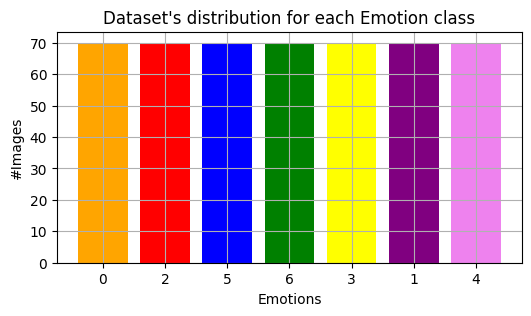

In [ ]:
data_path_ck = kdef_dataset
data, labels = load_data(data_path_ck)
l = labels
l.shape

In [ ]:
from sklearn.model_selection import train_test_split

# first split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.2, random_state=42)

In [ ]:
from tensorflow.keras.utils import to_categorical

# Assume that the y_train array is already defined as a 1D array of integers

# Convert y_train to categorical
num_classes = 7 # for example, if y_train contains 10 classes
y_train = to_categorical(y_train, num_classes)
# y_val = to_categorical(y_val, num_classes)
y_test = to_categorical(y_test, num_classes)

In [ ]:
X_train.shape, y_train.shape,  X_test.shape, y_test.shape

((392, 256, 256), (392, 7), (98, 256, 256), (98, 7))

In [ ]:
import torchvision.transforms as transforms
from torch.utils.data import Dataset

x,y = 224, 224

class CustomDataset(Dataset):
    def __init__(self, data, labels, transform=None):
        self.data = data
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, index):
        x = self.data[index]
        y = self.labels[index]
        if self.transform:
            x = self.transform(x)
        return x, y

train_dataset = CustomDataset(X_train, y_train, transform=transforms.Compose([
                            transforms.Resize((x, y)),
                            transforms.ToTensor()
                        ]))

test_dataset = CustomDataset(X_test, y_test, transform=transforms.Compose([
                            transforms.Resize((x, y)),
                            transforms.ToTensor()
                        ]))


In [ ]:
batch_size = 64
train_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True
)
test_loader = torch.utils.data.DataLoader(
    test_dataset,
    batch_size=batch_size,
    shuffle=True
)

In [ ]:
import os
import shutil
import random

data_dir = kdef_dataset  # Replace with the actual path to your CKPlus dataset
train_dir = '/content/ktrain_dir'  # Replace with the path where you want to store the training set
test_dir = '/content/ktest_dir'  # Replace with the path where you want to store the testing set
test_ratio = 0.2  # The ratio of data to be used for testing

# Create the train and test directories if they don't exist
os.makedirs(train_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)

# Iterate over the subfolders and randomly assign them to the train or test set
for emo_folder in os.listdir(data_dir):
    emo_path = os.path.join(data_dir, emo_folder)
    if not os.path.isdir(emo_path):
        continue
    images = os.listdir(emo_path)
    num_test = int(len(images) * test_ratio)
    test_images = random.sample(images, num_test)
    for img in images:
        src = os.path.join(emo_path, img)
        if img in test_images:
            dst = os.path.join(test_dir, emo_folder, img)
        else:
            dst = os.path.join(train_dir, emo_folder, img)
        os.makedirs(os.path.dirname(dst), exist_ok=True)
        shutil.copy(src, dst)


In [ ]:
# %% Prepare data for pretrained model
x,y = 224, 224
train_dataset = torchvision.datasets.ImageFolder(
        root='/content/ktrain_dir',
        transform=transforms.Compose([
                      transforms.Resize((x,y)),
                      transforms.ToTensor()
        ])
)

test_dataset = torchvision.datasets.ImageFolder(
        root='/content/ktest_dir',
        transform=transforms.Compose([
                      transforms.Resize((x,y)),
                      transforms.ToTensor()
        ])
)

In [ ]:
batch_size = 64
train_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True
)
test_loader = torch.utils.data.DataLoader(
    test_dataset,
    batch_size=batch_size,
    shuffle=True
)

### Modeling

In [ ]:
class CNNModel(nn.Module):
    def __init__(self):
        super(CNNModel, self).__init__()
        self.vgg16 = models.vgg16(pretrained=True)

        # Replace output layer according to our problem
        in_feats = self.vgg16.classifier[6].in_features
        self.vgg16.classifier[6] = nn.Linear(in_feats, 7)

    def forward(self, x):
        x = self.vgg16(x)
        return x

model = CNNModel()
model.to(device)
model

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


CNNModel(
  (vgg16): VGG(
    (features): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): ReLU(inplace=True)
      (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace=True)
      (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (13): ReLU(inplace=True)
      (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (15): ReLU(inplace=True)
      (16):

In [ ]:
# %% Train
cross_entropy_loss = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.0001)
epochs = 100

In [ ]:
# Iterate x epochs over the train data
print_freq = 7  # Print loss and accuracy every 100 iterations

for epoch in range(1, epochs+1):
    total_loss = 0.0
    correct = 0
    total = 0

    for i, batch in enumerate(train_loader, 0):
        inputs, labels = batch
        inputs = inputs.to(device)
        labels = labels.to(device)
        optimizer.zero_grad()
        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)

        # Calculate loss
        loss = cross_entropy_loss(outputs, labels)
        loss.backward()
        optimizer.step()

        # Update statistics
        total_loss += loss.item()
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

        # Print loss and accuracy every x iterations
        if (i+1) % print_freq == 0:
            avg_loss = total_loss / print_freq
            accuracy = 100.0 * correct / total
            print(f'Epoch [{epoch}/{epochs}], Iteration [{i+1}/{len(train_loader)}], Loss: {avg_loss:.4f}, Accuracy: {accuracy:.2f}%')
            total_loss = 0.0
            correct = 0
            total = 0

Epoch [1/50], Iteration [7/7], Loss: 1.1218, Accuracy: 57.91%
Epoch [2/50], Iteration [7/7], Loss: 0.8584, Accuracy: 72.45%
Epoch [3/50], Iteration [7/7], Loss: 0.4495, Accuracy: 82.65%
Epoch [4/50], Iteration [7/7], Loss: 0.3789, Accuracy: 86.48%
Epoch [5/50], Iteration [7/7], Loss: 0.3662, Accuracy: 89.03%
Epoch [6/50], Iteration [7/7], Loss: 0.3036, Accuracy: 89.80%
Epoch [7/50], Iteration [7/7], Loss: 0.2087, Accuracy: 92.09%
Epoch [8/50], Iteration [7/7], Loss: 0.1430, Accuracy: 96.43%
Epoch [9/50], Iteration [7/7], Loss: 0.1354, Accuracy: 94.39%
Epoch [10/50], Iteration [7/7], Loss: 0.1021, Accuracy: 96.68%
Epoch [11/50], Iteration [7/7], Loss: 0.0603, Accuracy: 98.47%
Epoch [12/50], Iteration [7/7], Loss: 0.1013, Accuracy: 96.94%
Epoch [13/50], Iteration [7/7], Loss: 0.0573, Accuracy: 97.96%
Epoch [14/50], Iteration [7/7], Loss: 0.0275, Accuracy: 98.98%
Epoch [15/50], Iteration [7/7], Loss: 0.0176, Accuracy: 99.23%
Epoch [16/50], Iteration [7/7], Loss: 0.0089, Accuracy: 99.49%
E

In [ ]:
# Save your model to Google Drive
torch.save(model.state_dict(), '/content/drive/MyDrive/mkdef_model_30Epo.pth')

### Evaluation

In [ ]:
model.load_state_dict(torch.load("/content/drive/MyDrive/mkdef_model_50Epo.pth"))

<All keys matched successfully>

In [ ]:
import torch

model.eval()  # Set the model to evaluation mode

# Rest of your testing code
test_loss = 0
correct = 0
total = 0

with torch.no_grad():
    for batch in test_loader:
        inputs, labels = batch
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)

        total += labels.size(0)
        correct += (predicted == labels).sum().item()

        loss = cross_entropy_loss(outputs, labels)
        test_loss += loss.item()

    test_loss /= len(test_loader)
    accuracy = 100 * correct / total

    print(f"Test Loss: {test_loss:.4f}")
    print(f"Test Accuracy: {accuracy:.2f}%")


Test Loss: 0.9145
Test Accuracy: 84.69%


### Confusion Matrix

Test Loss: 0.9055
Test Accuracy: 84.69%


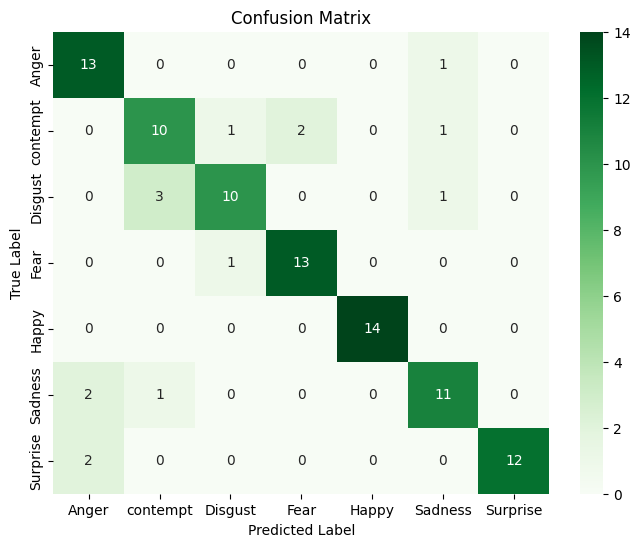

In [ ]:
import torch
import numpy as np
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Rest of your testing code
test_loss = 0
correct = 0
total = 0
all_predicted = []
all_labels = []

with torch.no_grad():
    for batch in test_loader:
        inputs, labels = batch
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)

        total += labels.size(0)
        correct += (predicted == labels).sum().item()

        loss = cross_entropy_loss(outputs, labels)
        test_loss += loss.item()

        all_predicted.extend(predicted.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    test_loss /= len(test_loader)
    accuracy = 100 * correct / total

    print(f"Test Loss: {test_loss:.4f}")
    print(f"Test Accuracy: {accuracy:.2f}%")

# Calculate the confusion matrix
cm = confusion_matrix(all_labels, all_predicted)

classes = ['Anger', 'contempt', 'Disgust', 'Fear', 'Happy','Sadness', 'Surprise']
def plot_confusion_matrix(cm, classes, title='Confusion Matrix', cmap=None):
    plt.figure(figsize=(8, 6))
    if cmap is None:
        cmap = plt.get_cmap('Greens')
    sns.heatmap(cm, annot=True, fmt='d', cmap=cmap, xticklabels=classes, yticklabels=classes)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title(title)
    plt.show()

# Assuming you already have the confusion matrix 'cm' and the class labels 'classes'
plot_confusion_matrix(cm, classes)


#### test

In [ ]:
mapping = {0:'anger', 1:'contempt', 2:'disgust', 3:'Fear', 4:'Happy', 5:'Sadness', 6: 'Surprise'}
labels_text = ['Anger', 'contempt', 'Disgust', 'Fear', 'Happy','Sadness', 'Surprise']
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
Pred = all_predicted
i=0
Y_test_l=[]
Pred_l=[]
while(i<len(Pred)):
  Y_test_l.append(int(np.argmax(y_test[i])))
  Pred_l.append(int(np.argmax(Pred[i])))
  i+=1

report=classification_report(Y_test_l, Pred_l, target_names=labels_text)
print(report)

              precision    recall  f1-score   support

       Anger       0.13      1.00      0.23        13
    contempt       0.00      0.00      0.00        11
     Disgust       0.00      0.00      0.00        19
        Fear       0.00      0.00      0.00        14
       Happy       0.00      0.00      0.00        22
     Sadness       0.00      0.00      0.00        10
    Surprise       0.00      0.00      0.00         9

    accuracy                           0.13        98
   macro avg       0.02      0.14      0.03        98
weighted avg       0.02      0.13      0.03        98



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


<Axes: >

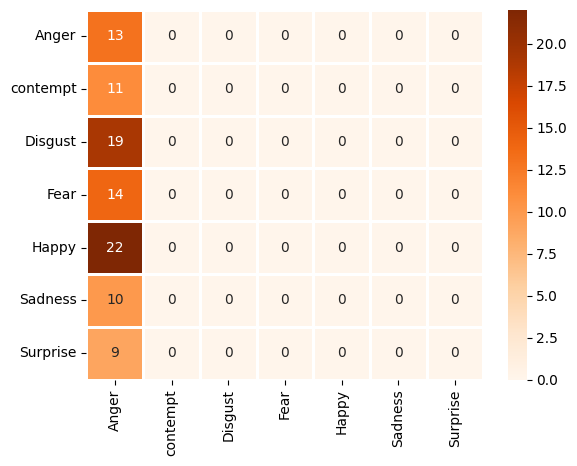

In [ ]:
from operator import index
results = confusion_matrix(Y_test_l, Pred_l)
cm_array_df = pd.DataFrame(results, index=labels_text, columns=labels_text)
import seaborn as sns

# sns.heatmap(results, annot=True,  cmap="Greens")
plt.savefig('CNN-PSOCK+.jpg')
# sns.heatmap(cm_array_df, annot=True,  cmap="Greens")

cf_matrix = confusion_matrix(Y_test_l, Pred_l)
sns.heatmap(cf_matrix, linewidths=1, annot=True, cmap='Oranges', xticklabels=labels_text, yticklabels = labels_text)

In [ ]:
import matplotlib.pyplot as plt

def generate_heatmap(pixel_relevance_scores):
    # Normalize the relevance scores between 0 and 1
    normalized_scores = (pixel_relevance_scores - np.min(pixel_relevance_scores)) / (np.max(pixel_relevance_scores) - np.min(pixel_relevance_scores))

    # Create the heatmap using the normalized relevance scores
    heatmap = plt.imshow(normalized_scores, cmap='jet')

    # Add a colorbar to the heatmap
    plt.colorbar(heatmap)

    # Show the generated heatmap
    plt.show()


In [ ]:
# Testing the model accuracy
model.eval()  # Set the model to evaluation mode

test_loss = 0
correct = 0
total = 0

with torch.no_grad():
    for batch in test_loader:
        inputs, labels = batch
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)

        total += labels.size(0)
        correct += (predicted == labels).sum().item()

        loss = cross_entropy_loss(outputs, labels)
        test_loss += loss.item()

    test_loss /= len(test_loader)
    accuracy = 100 * correct / total

    print(f"Test Loss: {test_loss:.4f}")
    print(f"Test Accuracy: {accuracy:.2f}%")


Test Loss: 0.9789
Test Accuracy: 84.69%


In [ ]:

# %% Inspect predictions for first batch test/train loader
import pandas as pd

inputs, labels = next(iter(test_loader))
# inputs, labels = next(iter(train_loader))
inputs = inputs.to(device)
labels = labels.numpy()
outputs = model(inputs).max(1).indices.detach().cpu().numpy()

comparison = pd.DataFrame()
print("Batch predictions:")
print(outputs)

comparison["actual"] = labels
comparison["predicted"] = outputs

print("\nComparison:")
print(comparison)

Batch predictions:
[6 0 2 4 4 4 3 5 5 0 2 5 0 1 1 4 6 6 0 0 5 3 5 6 5 4 1 5 2 5 3 3 2 4 5 6 2
 2 2 5 1 6 1 5 6 5 3 2 6 4 0 6 3 0 6 6 5 6 0 1 1 5 4 6]

Comparison:
    actual  predicted
0        6          6
1        5          0
2        2          2
3        4          4
4        4          4
..     ...        ...
59       1          1
60       1          1
61       5          5
62       4          4
63       6          6

[64 rows x 2 columns]


### LRP on VGG16

In [ ]:
def new_layer(layer, g):
    """Clone a layer and pass its parameters through the function g."""
    layer = copy.deepcopy(layer)
    try: layer.weight = torch.nn.Parameter(g(layer.weight))
    except AttributeError: pass
    try: layer.bias = torch.nn.Parameter(g(layer.bias))
    except AttributeError: pass
    return layer

In [ ]:
def dense_to_conv(layers):
    """ Converts a dense layer to a conv layer """
    newlayers = []
    for i,layer in enumerate(layers):
        if isinstance(layer, nn.Linear):
            newlayer = None
            if i == 0:
                m, n = 512, layer.weight.shape[0]
                newlayer = nn.Conv2d(m,n,7)
                newlayer.weight = nn.Parameter(layer.weight.reshape(n,m,7,7))
            else:
                m,n = layer.weight.shape[1],layer.weight.shape[0]
                newlayer = nn.Conv2d(m,n,1)
                newlayer.weight = nn.Parameter(layer.weight.reshape(n,m,1,1))
            newlayer.bias = nn.Parameter(layer.bias)
            newlayers += [newlayer]
        else:
            newlayers += [layer]
    return newlayers

In [ ]:
def get_linear_layer_indices(model):
    offset = len(model.vgg16._modules['features']) + 1
    indices = []
    for i, layer in enumerate(model.vgg16._modules['classifier']):
        if isinstance(layer, nn.Linear):
            indices.append(i)
    indices = [offset + val for val in indices]
    return indices

In [ ]:
def apply_lrp_on_vgg16(model, image):
    image = torch.unsqueeze(image, 0)
    # >>> Step 1: Extract layers
    layers = list(model.vgg16._modules['features']) \
                + [model.vgg16._modules['avgpool']] \
                + dense_to_conv(list(model.vgg16._modules['classifier']))
    linear_layer_indices = get_linear_layer_indices(model)
    # >>> Step 2: Propagate image through layers and store activations
    n_layers = len(layers)
    activations = [image] + [None] * n_layers # list of activations

    for layer in range(n_layers):
        if layer in linear_layer_indices:
            if layer == 32:
                activations[layer] = activations[layer].reshape((1, 512, 7, 7))
        activation = layers[layer].forward(activations[layer])
        if isinstance(layers[layer], torch.nn.modules.pooling.AdaptiveAvgPool2d):
            activation = torch.flatten(activation, start_dim=1)
        activations[layer+1] = activation

    # >>> Step 3: Replace last layer with one-hot-encoding
    output_activation = activations[-1].detach().cpu().numpy()
    max_activation = output_activation.max()
    one_hot_output = [val if val == max_activation else 0
                        for val in output_activation[0]]

    activations[-1] = torch.FloatTensor([one_hot_output]).to(device)

    # >>> Step 4: Backpropagate relevance scores
    relevances = [None] * n_layers + [activations[-1]]
    # Iterate over the layers in reverse order
    for layer in range(0, n_layers)[::-1]:
        current = layers[layer]
        # Treat max pooling layers as avg pooling
        if isinstance(current, torch.nn.MaxPool2d):
            layers[layer] = torch.nn.AvgPool2d(2)
            current = layers[layer]
        if isinstance(current, torch.nn.Conv2d) or \
           isinstance(current, torch.nn.AvgPool2d) or\
           isinstance(current, torch.nn.Linear):
            activations[layer] = activations[layer].data.requires_grad_(True)

            # Apply variants of LRP depending on the depth
            # see: https://link.springer.com/chapter/10.1007%2F978-3-030-28954-6_10
            # Lower layers, LRP-gamma >> Favor positive contributions (activations)
            if layer <= 16:       rho = lambda p: p + 0.25*p.clamp(min=0); incr = lambda z: z+1e-9
            # Middle layers, LRP-epsilon >> Remove some noise / Only most salient factors survive
            if 17 <= layer <= 30: rho = lambda p: p;                       incr = lambda z: z+1e-9+0.25*((z**2).mean()**.5).data
            # Upper Layers, LRP-0 >> Basic rule
            if layer >= 31:       rho = lambda p: p;                       incr = lambda z: z+1e-9

            # Transform weights of layer and execute forward pass
            z = incr(new_layer(layers[layer],rho).forward(activations[layer]))
            # Element-wise division between relevance of the next layer and z
            s = (relevances[layer+1]/z).data
            # Calculate the gradient and multiply it by the activation
            (z * s).sum().backward();
            c = activations[layer].grad
            # Assign new relevance values
            relevances[layer] = (activations[layer]*c).data
        else:
            relevances[layer] = relevances[layer+1]

    # >>> Potential Step 5: Apply different propagation rule for pixels
    return relevances[0]

In [ ]:
def get_pixel_count_in_range(array):
  array = array.flatten()
  count_range = []
  for i in range(10):
    x, y = i/10, (i+1)/10
    # Count the number of values in the range
    count = np.count_nonzero(np.logical_and(array > x, array <= y))

    # Print the count
    print("Contribution of pixels in the range [",x,y,"] is : ", count)
    count_range.append(count)
  return count_range

In [ ]:
def calculate_range_by_mean5(array):
  pixel_count_in_range = get_pixel_count_in_range(array)
  m1 = sum(pixel_count_in_range[:5])
  m2 = sum(pixel_count_in_range[3:8])
  m3 = sum(pixel_count_in_range[5:])

  lmh = ["Low", "Medium", "High"]
  lmhv = [m1, m2, m3]

  intensity = lmh[lmhv.index(max(lmhv))]
  # print(intensity)
  return intensity


In [ ]:
class_names = ['neutral', 'anger', 'disgust', 'fear', 'happiness' , 'sadness', 'surprise']

torch.Size([64, 3, 224, 224])
0
5 and tensor(5)
Groundtruth for this image: 5


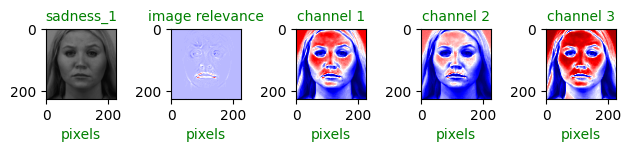

['sadness_1']|[64960]|[65]
1
5 and tensor(5)
Groundtruth for this image: 5


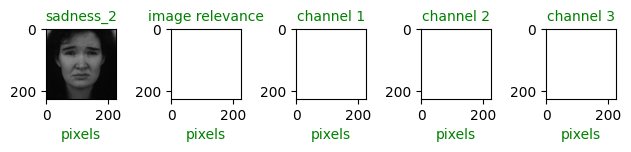

['sadness_1', 'sadness_2']|[64960, 64960]|[65, 65]
2
2 and tensor(2)
Groundtruth for this image: 2


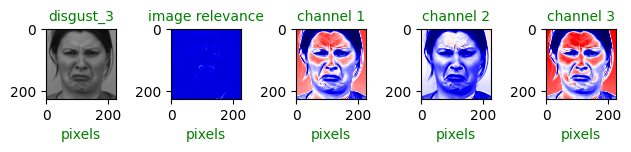

['sadness_1', 'sadness_2', 'disgust_3']|[64960, 64960, 64960]|[65, 65, 65]
3
3 and tensor(3)
Groundtruth for this image: 3


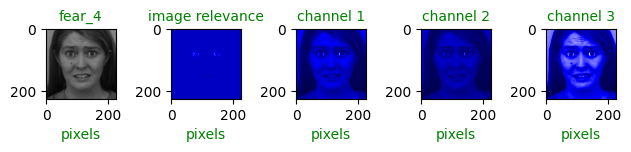

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4']|[64960, 64960, 64960, 64960]|[65, 65, 65, 65]
4
4 and tensor(4)
Groundtruth for this image: 4


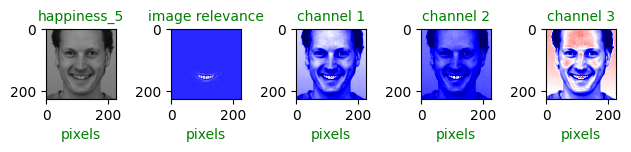

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5']|[64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65]
5
4 and tensor(4)
Groundtruth for this image: 4


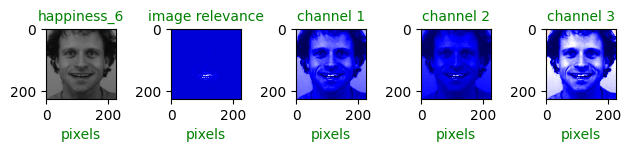

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6']|[64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65]
6
Not a sequence ..
7
Not a sequence ..
8
2 and tensor(2)
Groundtruth for this image: 2


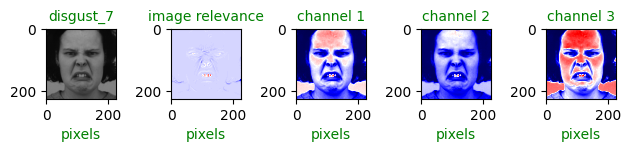

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7']|[64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65]
9
6 and tensor(6)
Groundtruth for this image: 6


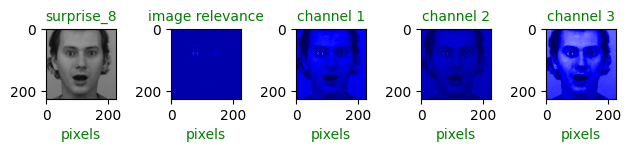

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65]
10
1 and tensor(1)
Groundtruth for this image: 1


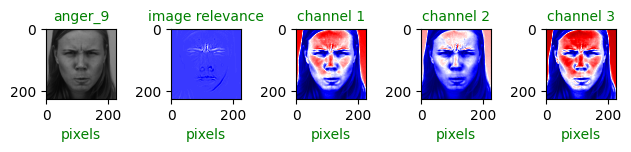

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65]
11
Not a sequence ..
12
6 and tensor(6)
Groundtruth for this image: 6


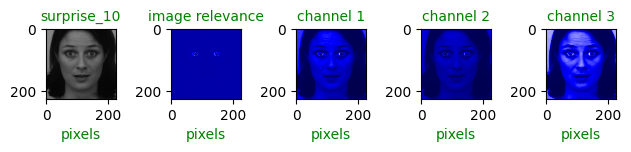

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
13
4 and tensor(4)
Groundtruth for this image: 4


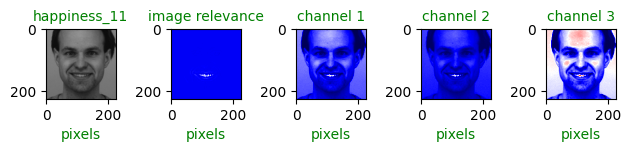

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
14
4 and tensor(4)
Groundtruth for this image: 4


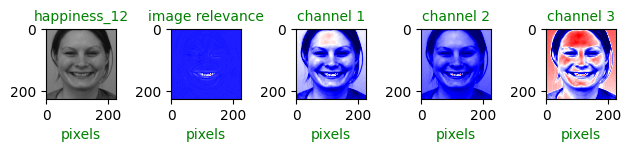

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
15
6 and tensor(3)
16
Not a sequence ..
17
1 and tensor(1)
Groundtruth for this image: 1


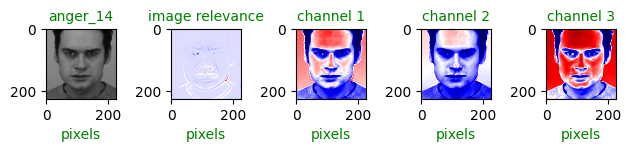

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
18
3 and tensor(3)
Groundtruth for this image: 3


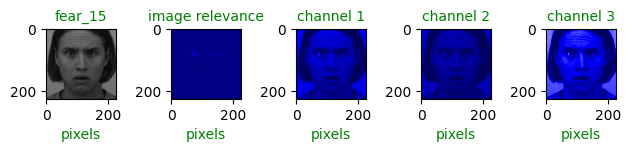

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
19
3 and tensor(3)
Groundtruth for this image: 3


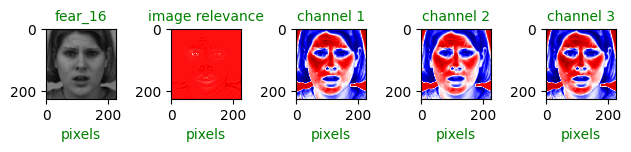

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
20
1 and tensor(1)
Groundtruth for this image: 1


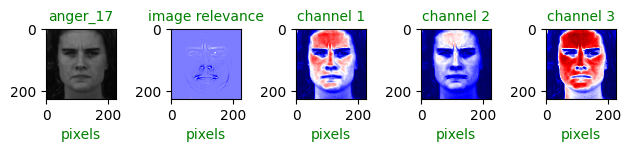

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
21
5 and tensor(5)
Groundtruth for this image: 5


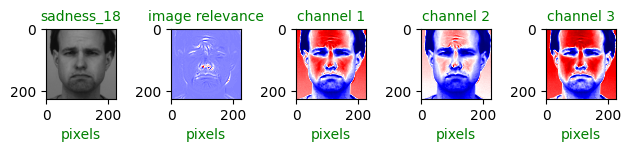

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
22
1 and tensor(1)
Groundtruth for this image: 1


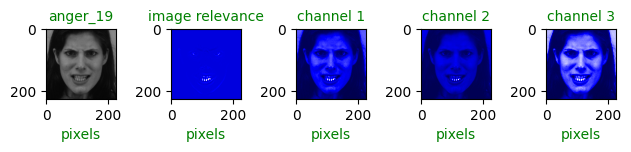

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
23
6 and tensor(6)
Groundtruth for this image: 6


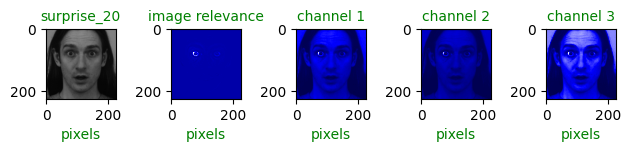

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
24
5 and tensor(5)
Groundtruth for this image: 5


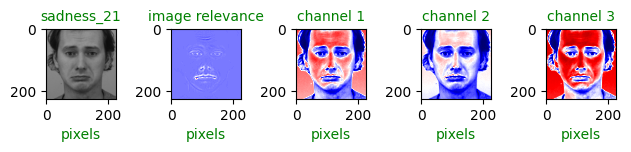

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
25
6 and tensor(6)
Groundtruth for this image: 6


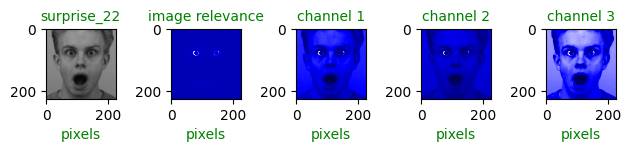

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
26
3 and tensor(3)
Groundtruth for this image: 3


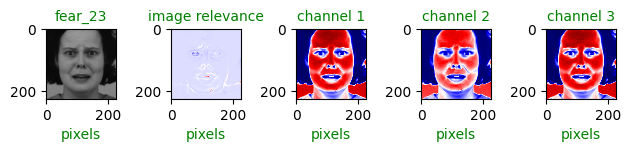

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
27
4 and tensor(4)
Groundtruth for this image: 4


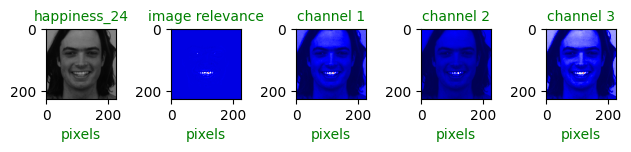

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
28
2 and tensor(2)
Groundtruth for this image: 2


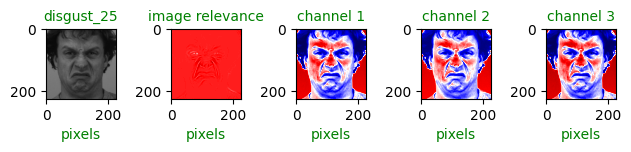

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
29
1 and tensor(1)
Groundtruth for this image: 1


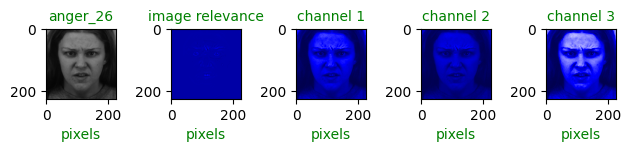

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
30
1 and tensor(1)
Groundtruth for this image: 1


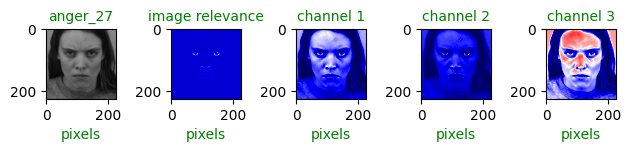

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
31
1 and tensor(1)
Groundtruth for this image: 1


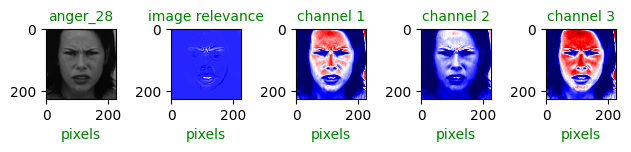

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
32
5 and tensor(5)
Groundtruth for this image: 5


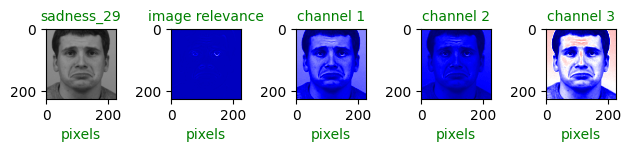

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
33
1 and tensor(1)
Groundtruth for this image: 1


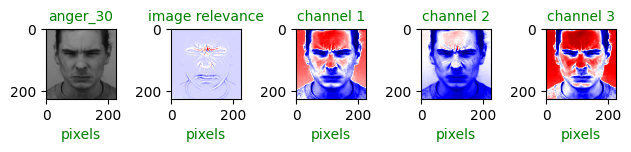

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
34
2 and tensor(2)
Groundtruth for this image: 2


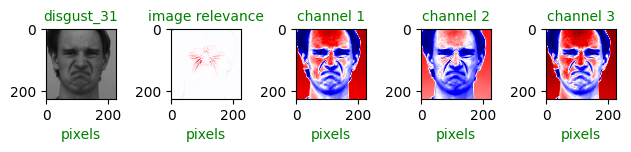

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
35
5 and tensor(5)
Groundtruth for this image: 5


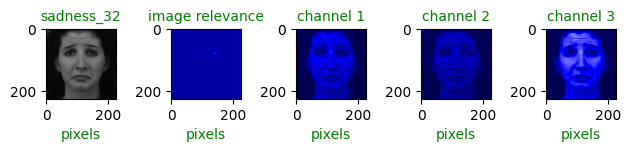

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
36
2 and tensor(2)
Groundtruth for this image: 2


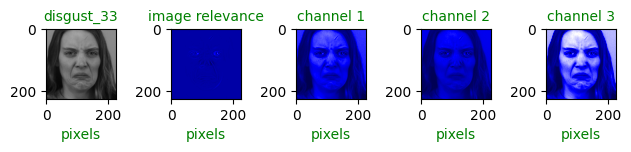

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
37
4 and tensor(4)
Groundtruth for this image: 4


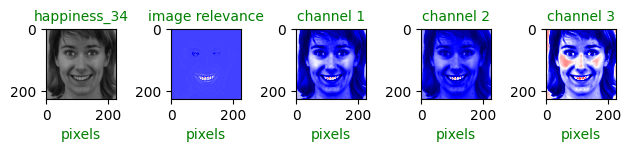

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
38
4 and tensor(4)
Groundtruth for this image: 4


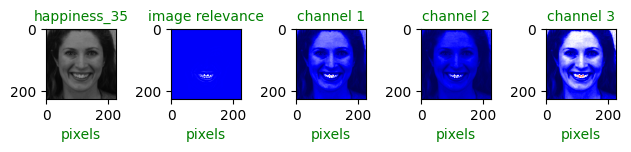

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
39
6 and tensor(6)
Groundtruth for this image: 6


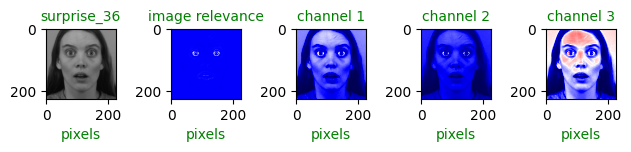

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
40
6 and tensor(6)
Groundtruth for this image: 6


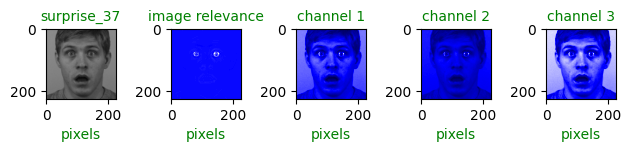

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
41
Not a sequence ..
42
5 and tensor(5)
Groundtruth for this image: 5


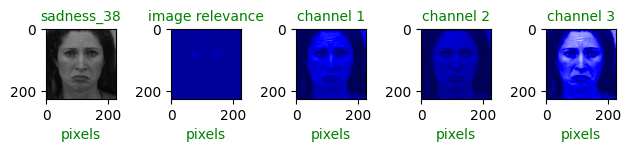

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
43
1 and tensor(1)
Groundtruth for this image: 1


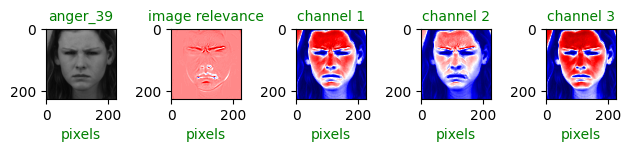

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
44
Not a sequence ..
45
2 and tensor(2)
Groundtruth for this image

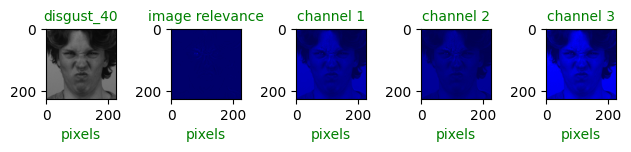

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
46
1 and tensor(1)
Groundtruth for this i

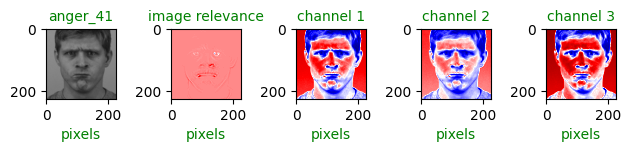

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65]
47
6 and tensor(6)

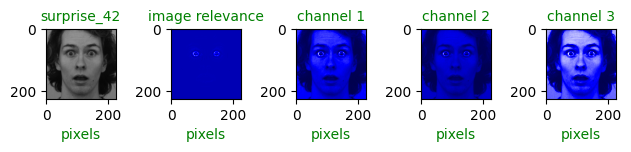

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 

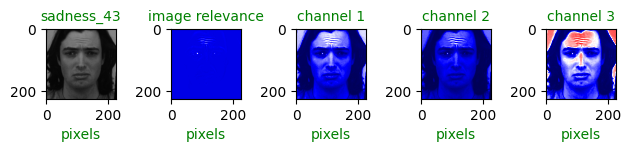

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65,

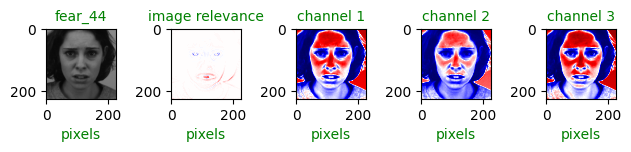

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 6

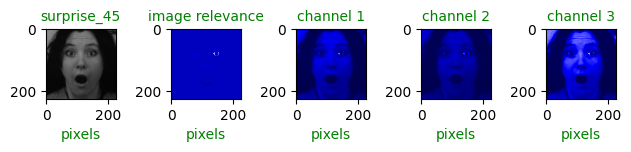

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65,

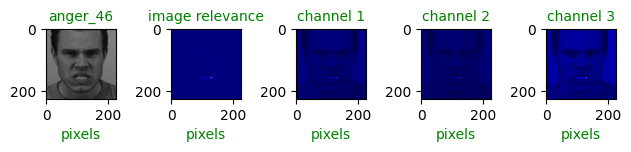

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 

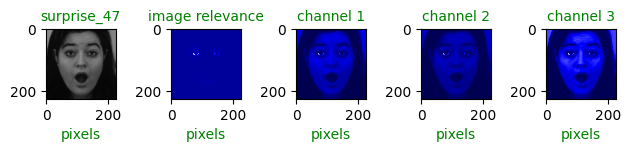

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65, 65

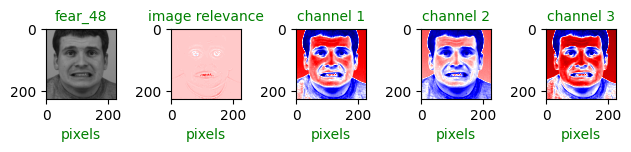

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65, 65, 65, 65, 65, 65, 

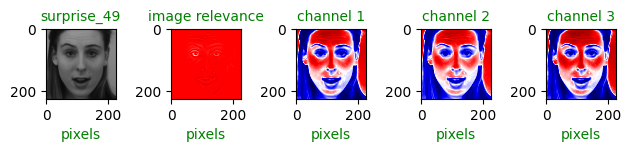

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960]|[65, 65, 65, 65

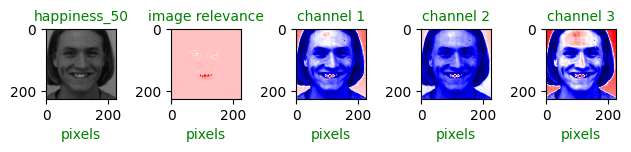

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960,

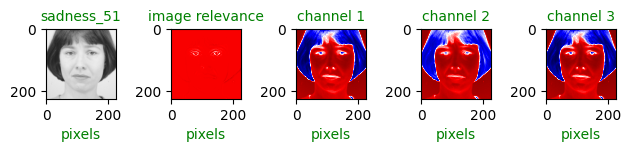

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960,

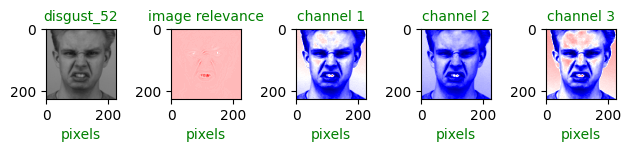

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960,

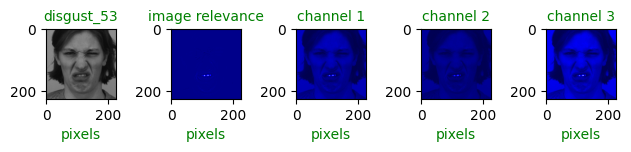

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960,

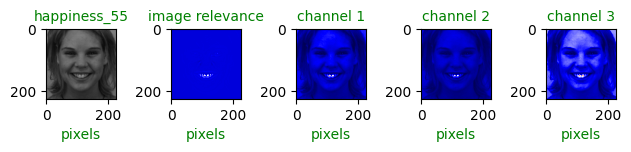

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 6496

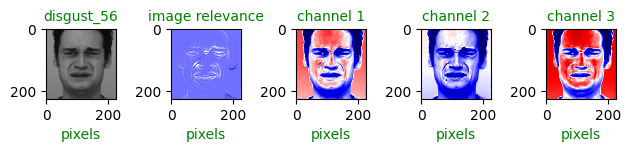

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 6496

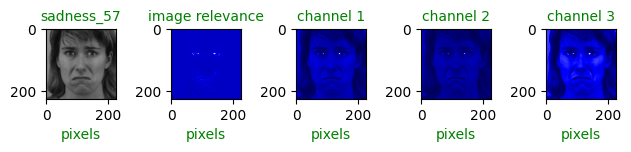

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 6496

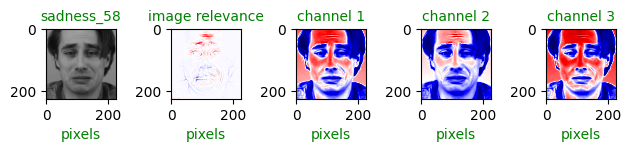

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 6496

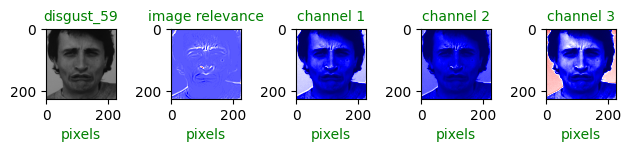

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 6496

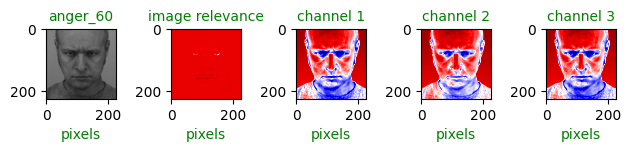

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960,

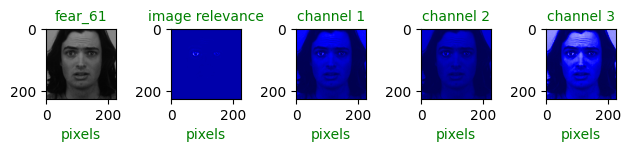

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60', 'fear_61']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64

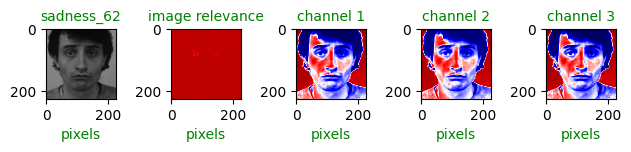

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60', 'fear_61', 'sadness_62']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64

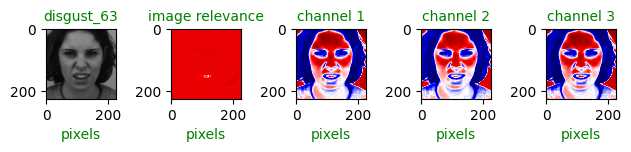

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60', 'fear_61', 'sadness_62', 'disgust_63']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64

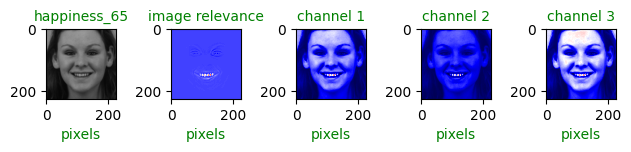

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60', 'fear_61', 'sadness_62', 'disgust_63', 'happiness_65']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 

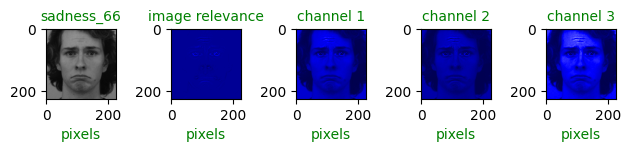

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60', 'fear_61', 'sadness_62', 'disgust_63', 'happiness_65', 'sadness_66']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 

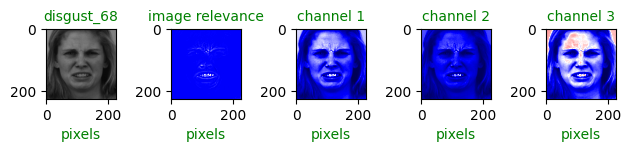

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60', 'fear_61', 'sadness_62', 'disgust_63', 'happiness_65', 'sadness_66', 'disgust_68']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 

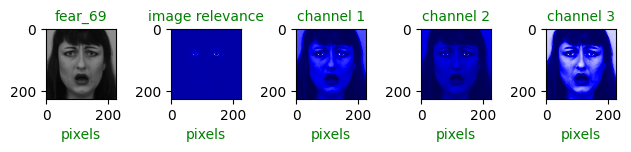

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60', 'fear_61', 'sadness_62', 'disgust_63', 'happiness_65', 'sadness_66', 'disgust_68', 'fear_69']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 649

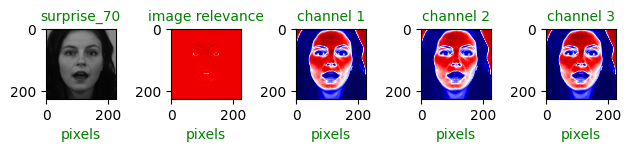

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60', 'fear_61', 'sadness_62', 'disgust_63', 'happiness_65', 'sadness_66', 'disgust_68', 'fear_69', 'surprise_70']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64

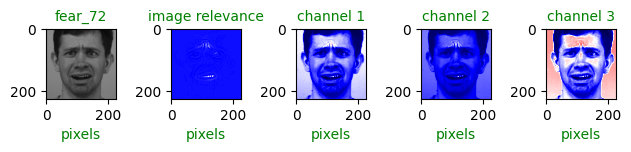

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60', 'fear_61', 'sadness_62', 'disgust_63', 'happiness_65', 'sadness_66', 'disgust_68', 'fear_69', 'surprise_70', 'fear_72']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960

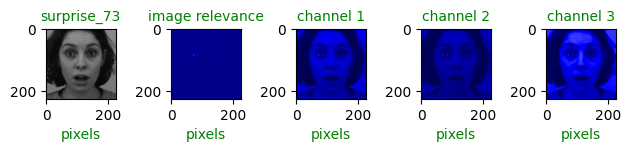

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60', 'fear_61', 'sadness_62', 'disgust_63', 'happiness_65', 'sadness_66', 'disgust_68', 'fear_69', 'surprise_70', 'fear_72', 'surprise_73']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 6496

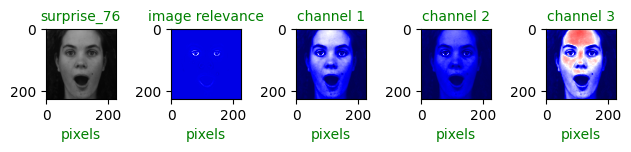

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60', 'fear_61', 'sadness_62', 'disgust_63', 'happiness_65', 'sadness_66', 'disgust_68', 'fear_69', 'surprise_70', 'fear_72', 'surprise_73', 'surprise_76']|[64960, 64960, 64960, 64960, 64960, 64960, 64960, 64960, 649

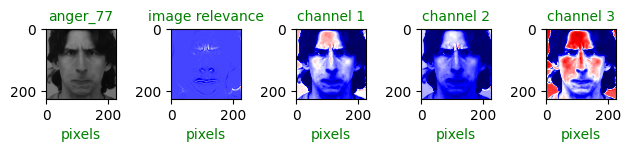

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60', 'fear_61', 'sadness_62', 'disgust_63', 'happiness_65', 'sadness_66', 'disgust_68', 'fear_69', 'surprise_70', 'fear_72', 'surprise_73', 'surprise_76', 'anger_77']|[64960, 64960, 64960, 64960, 64960, 64960, 64960

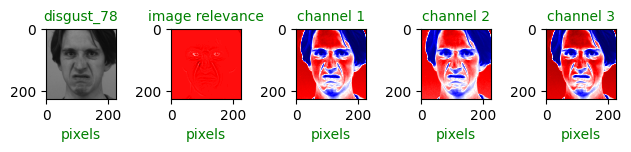

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60', 'fear_61', 'sadness_62', 'disgust_63', 'happiness_65', 'sadness_66', 'disgust_68', 'fear_69', 'surprise_70', 'fear_72', 'surprise_73', 'surprise_76', 'anger_77', 'disgust_78']|[64960, 64960, 64960, 64960, 64960

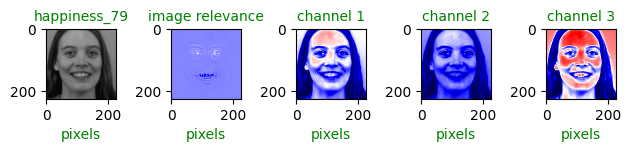

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60', 'fear_61', 'sadness_62', 'disgust_63', 'happiness_65', 'sadness_66', 'disgust_68', 'fear_69', 'surprise_70', 'fear_72', 'surprise_73', 'surprise_76', 'anger_77', 'disgust_78', 'happiness_79']|[64960, 64960, 649

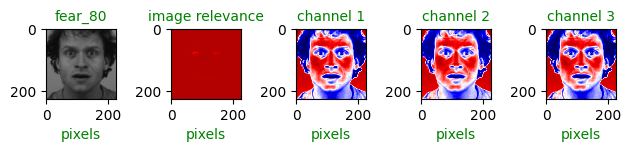

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60', 'fear_61', 'sadness_62', 'disgust_63', 'happiness_65', 'sadness_66', 'disgust_68', 'fear_69', 'surprise_70', 'fear_72', 'surprise_73', 'surprise_76', 'anger_77', 'disgust_78', 'happiness_79', 'fear_80']|[64960,

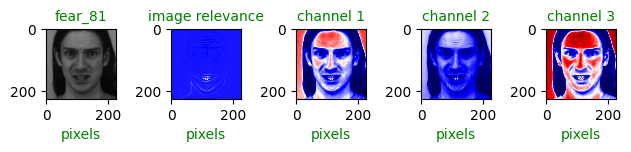

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60', 'fear_61', 'sadness_62', 'disgust_63', 'happiness_65', 'sadness_66', 'disgust_68', 'fear_69', 'surprise_70', 'fear_72', 'surprise_73', 'surprise_76', 'anger_77', 'disgust_78', 'happiness_79', 'fear_80', 'fear_8

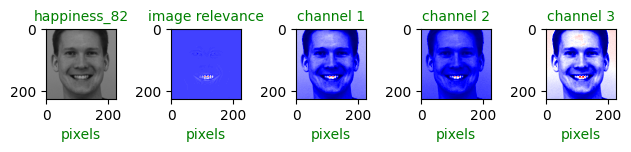

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60', 'fear_61', 'sadness_62', 'disgust_63', 'happiness_65', 'sadness_66', 'disgust_68', 'fear_69', 'surprise_70', 'fear_72', 'surprise_73', 'surprise_76', 'anger_77', 'disgust_78', 'happiness_79', 'fear_80', 'fear_8

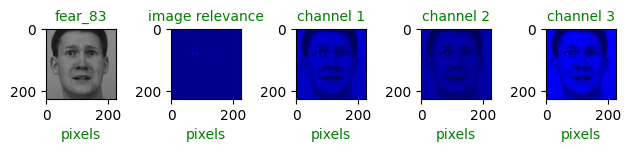

['sadness_1', 'sadness_2', 'disgust_3', 'fear_4', 'happiness_5', 'happiness_6', 'disgust_7', 'surprise_8', 'anger_9', 'surprise_10', 'happiness_11', 'happiness_12', 'anger_14', 'fear_15', 'fear_16', 'anger_17', 'sadness_18', 'anger_19', 'surprise_20', 'sadness_21', 'surprise_22', 'fear_23', 'happiness_24', 'disgust_25', 'anger_26', 'anger_27', 'anger_28', 'sadness_29', 'anger_30', 'disgust_31', 'sadness_32', 'disgust_33', 'happiness_34', 'happiness_35', 'surprise_36', 'surprise_37', 'sadness_38', 'anger_39', 'disgust_40', 'anger_41', 'surprise_42', 'sadness_43', 'fear_44', 'surprise_45', 'anger_46', 'surprise_47', 'fear_48', 'surprise_49', 'happiness_50', 'sadness_51', 'disgust_52', 'disgust_53', 'happiness_55', 'disgust_56', 'sadness_57', 'sadness_58', 'disgust_59', 'anger_60', 'fear_61', 'sadness_62', 'disgust_63', 'happiness_65', 'sadness_66', 'disgust_68', 'fear_69', 'surprise_70', 'fear_72', 'surprise_73', 'surprise_76', 'anger_77', 'disgust_78', 'happiness_79', 'fear_80', 'fear_8

<Figure size 640x480 with 0 Axes>

In [ ]:
# emotion_class = 'happy'  # Specify the emotion class for which you want to generate relevance scores
folder_path = '/content/drive/MyDrive/hm'
n = 1
image_names = []
positive_counts = []
negative_counts = []

for inputs, labels in test_loader:
    inputs = inputs.to(device)
    outputs = model(inputs).max(1).indices.detach().cpu().numpy()
    print(inputs.shape)
    for i in range(inputs.shape[0]):
        image_id = i
        print(image_id)

        try:
            image_relevances = apply_lrp_on_vgg16(model, inputs[image_id])
            image_relevances = image_relevances.permute(0, 2, 3, 1).detach().cpu().numpy()[0]
            image_relevances = np.interp(image_relevances, (image_relevances.min(), image_relevances.max()), (0, 1))
            pixel_relevance_scores = inputs[image_id].detach().cpu().numpy() * np.transpose(image_relevances, (2, 0, 1))
            # print(type(pixel_relevance_scores), len(pixel_relevance_scores))

            pred_label = list(train_dataset.class_to_idx.keys())[list(train_dataset.class_to_idx.values()).index(labels[image_id])]
            image_name = class_names[int(pred_label)]+'_'+str(n)
            n += 1
            # Add condition to process images only for the specified emotion class
            # if pred_label == emotion_class:
            print(outputs[image_id], "and", labels[image_id])
            if outputs[image_id] == labels[image_id]:
                print("Groundtruth for this image:", pred_label)
                plt.axis('off')
                plt.gca().remove()

                plt.subplot(1, 5, 1)
                plt.imshow(inputs[image_id].permute(1, 2, 0).detach().cpu().numpy())
                plt.title(image_name, fontdict={'fontsize': 10, 'color': 'green'})
                plt.xlabel('pixels', fontdict={'fontsize': 10, 'color': 'green'})

                plt.subplot(1, 5, 2)
                plt.imshow(image_relevances[:, :, 0], cmap="seismic")
                plt.title("image relevance", fontdict={'fontsize': 10, 'color': 'green'})
                plt.xlabel('pixels', fontdict={'fontsize': 10, 'color': 'green'})


                plt.subplot(1, 5, 3)
                plt.imshow(pixel_relevance_scores[0], cmap="seismic")
                plt.title("channel 1", fontdict={'fontsize': 10, 'color': 'green'})
                plt.xlabel('pixels', fontdict={'fontsize': 10, 'color': 'green'})


                plt.subplot(1, 5, 4)
                plt.imshow(pixel_relevance_scores[1], cmap="seismic")
                plt.title("channel 2", fontdict={'fontsize': 10, 'color': 'green'})
                plt.xlabel('pixels', fontdict={'fontsize': 10, 'color': 'green'})


                plt.subplot(1, 5, 5)
                plt.imshow(pixel_relevance_scores[2], cmap="seismic")
                plt.title("channel 3", fontdict={'fontsize': 10, 'color': 'green'})
                plt.xlabel('pixels', fontdict={'fontsize': 10, 'color': 'green'})


                plt.tight_layout()
                plt.show()
                plt.clf()

                # print(contributed_pixels_count(0, pixel_relevance_scores))
                # p, z = contributed_pixels_count(1, pixel_relevance_scores)
                # print(contributed_pixels_count(2, pixel_relevance_scores))

                image_names.append(image_name)
                positive_counts.append(p)
                negative_counts.append(z)

                print(image_names, positive_counts, negative_counts, sep="|")

                # Save the figure in the specified folder
                plt.savefig(f'{folder_path}/{image_name}')
        except TypeError:
            print("Not a sequence ..")
            continue

### TEST

In [ ]:
def get_pixel_count_in_range(array):
  array = array.flatten()
  count_range = []
  for i in range(10):
    x, y = i/10, (i+1)/10
    # Count the number of values in the range
    count = np.count_nonzero(np.logical_and(array > x, array <= y))

    # Print the count
    # print("Contribution of pixels in the range [",x,y,"] is : ", count)
    count_range.append(count)
  return count_range


def calculate_range_by_mean5(array):
  pixel_count_in_range = get_pixel_count_in_range(array)
  m1 = sum(pixel_count_in_range[:5])
  m2 = sum(pixel_count_in_range[3:8])
  m3 = sum(pixel_count_in_range[5:])

  lmhv = [m1, m2, m3]

  return pixel_count_in_range, lmhv


Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

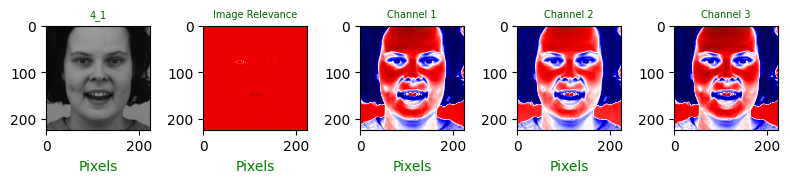

['4', '/content/ktrain_dir/0/AF02NES.png', 0, 0, 1, 1, 3, 16, 85, 148977, 1419, 25, 5, 149082, 150522, 150522, 'High']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

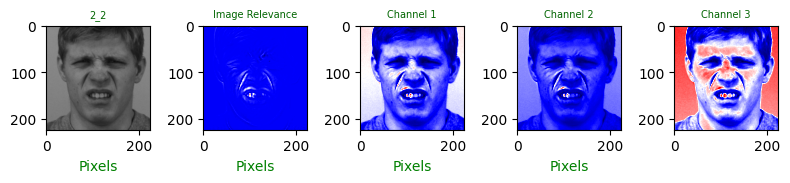

['2', '/content/ktrain_dir/0/AF03NES.png', 17, 157, 109105, 40631, 473, 112, 22, 7, 1, 2, 150383, 41245, 144, 150383, 'Low']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

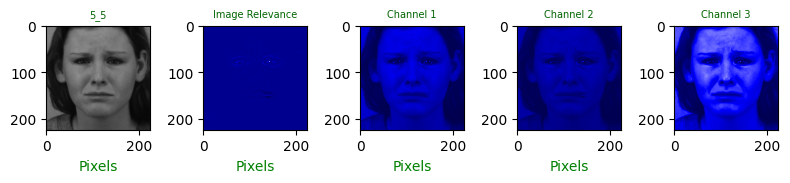

['5', '/content/ktrain_dir/0/AF06NES.png', 141148, 9339, 26, 8, 4, 0, 1, 0, 0, 1, 150525, 13, 2, 150525, 'Low']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

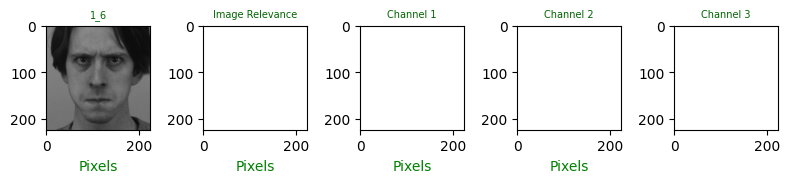

['1', '/content/ktrain_dir/0/AF09NES.png', 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 'Low']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

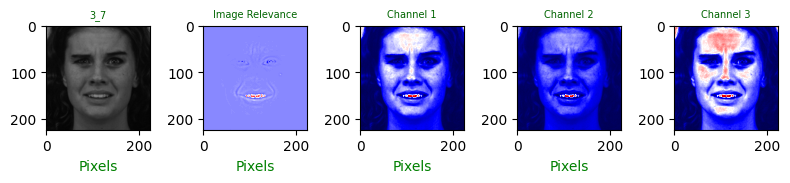

['3', '/content/ktrain_dir/0/AF11NES.png', 0, 5, 95, 149528, 644, 150, 71, 27, 6, 1, 150272, 150420, 255, 150420, 'Medium']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

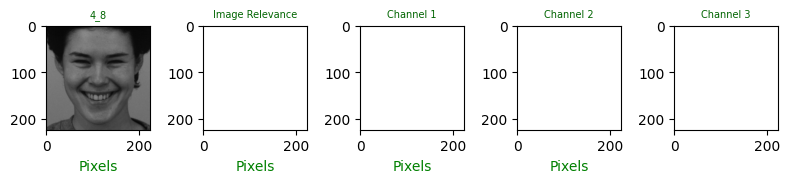

['4', '/content/ktrain_dir/0/AF12NES.png', 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 'Low']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

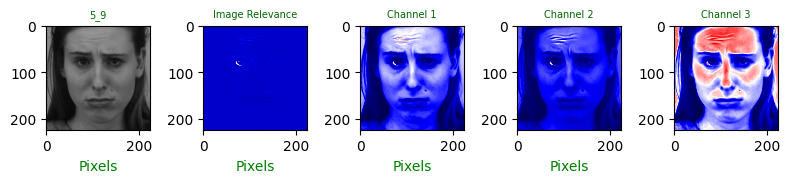

['5', '/content/ktrain_dir/0/AF13NES.png', 20, 547, 149670, 207, 44, 20, 9, 2, 3, 5, 150488, 282, 39, 150488, 'Low']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

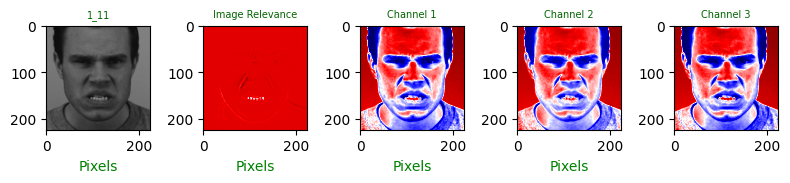

['1', '/content/ktrain_dir/0/AF16NES.png', 1, 1, 7, 15, 30, 100, 485, 149018, 832, 38, 54, 149648, 150473, 150473, 'High']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

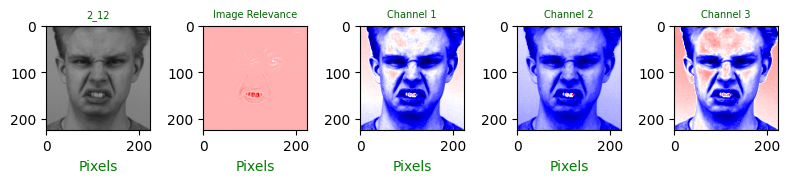

['2', '/content/ktrain_dir/0/AF17NES.png', 0, 1, 1, 8, 29, 150035, 387, 55, 8, 3, 39, 150514, 150488, 150514, 'Medium']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

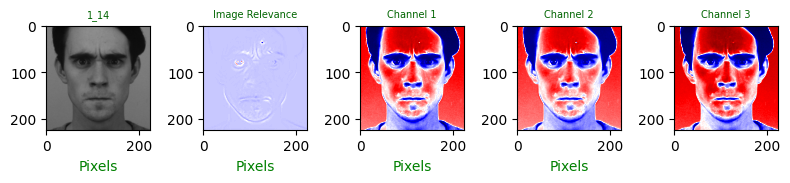

['1', '/content/ktrain_dir/0/AF19NES.png', 0, 2, 2, 5, 145494, 4986, 30, 4, 1, 3, 145503, 150519, 5024, 150519, 'Medium']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

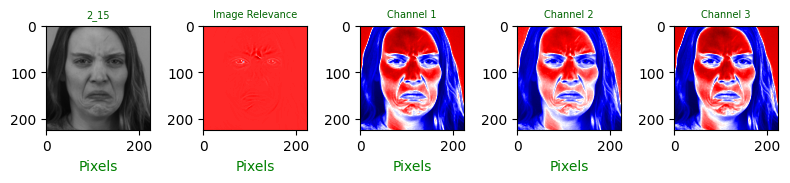

['2', '/content/ktrain_dir/0/AF20NES.png', 1, 0, 2, 2, 15, 47, 1710, 148710, 34, 6, 20, 150484, 150507, 150507, 'High']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

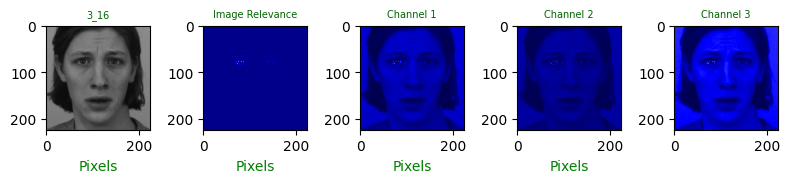

['3', '/content/ktrain_dir/0/AF21NES.png', 135187, 15222, 86, 22, 5, 2, 1, 0, 1, 1, 150522, 30, 5, 150522, 'Low']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

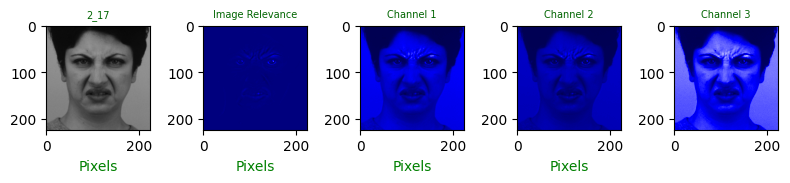

['2', '/content/ktrain_dir/0/AF22NES.png', 139138, 11287, 80, 12, 7, 1, 1, 0, 0, 1, 150524, 21, 3, 150524, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

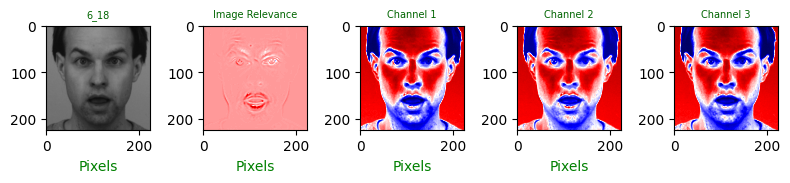

['6', '/content/ktrain_dir/0/AF23NES.png', 0, 1, 1, 7, 101, 15115, 134991, 258, 39, 14, 110, 150472, 150417, 150472, 'Medium']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

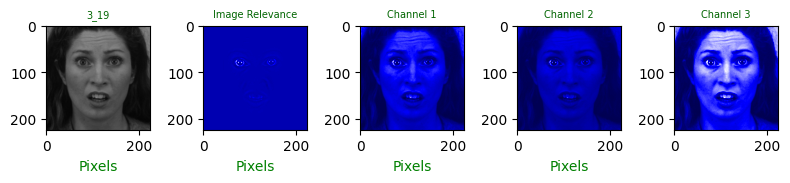

['3', '/content/ktrain_dir/0/AF26NES.png', 35, 149659, 678, 112, 26, 10, 4, 1, 0, 2, 150510, 153, 17, 150510, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

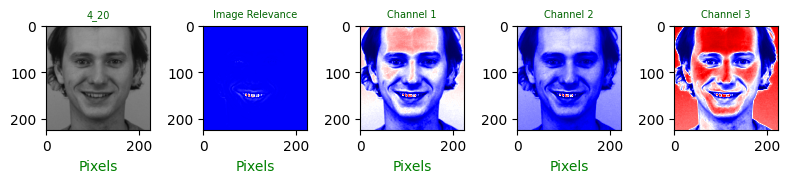

['4', '/content/ktrain_dir/0/AF27NES.png', 5, 63, 790, 149268, 225, 88, 54, 18, 14, 2, 150351, 149653, 176, 150351, 'Low']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

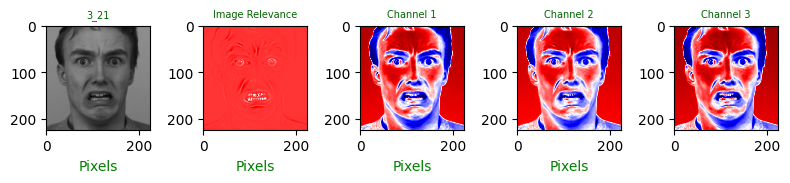

['3', '/content/ktrain_dir/0/AF28NES.png', 1, 9, 18, 41, 134, 626, 149366, 323, 6, 3, 203, 150490, 150324, 150490, 'Medium']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

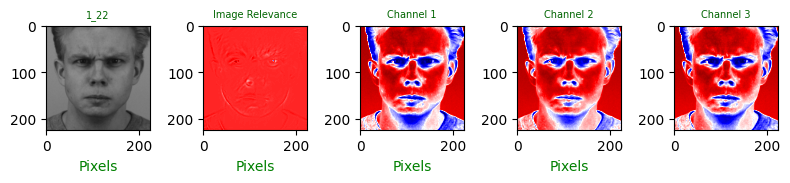

['1', '/content/ktrain_dir/0/AF29NES.png', 1, 1, 1, 3, 4, 23, 20929, 129535, 25, 5, 10, 150494, 150517, 150517, 'High']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

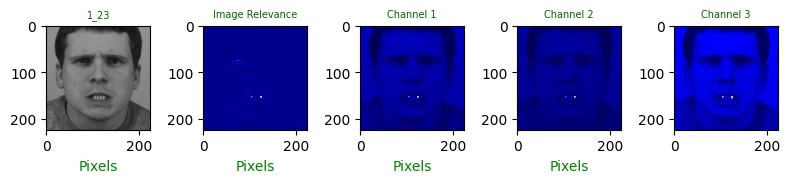

['1', '/content/ktrain_dir/0/AF30NES.png', 609, 149696, 134, 43, 19, 12, 5, 6, 2, 1, 150501, 85, 26, 150501, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

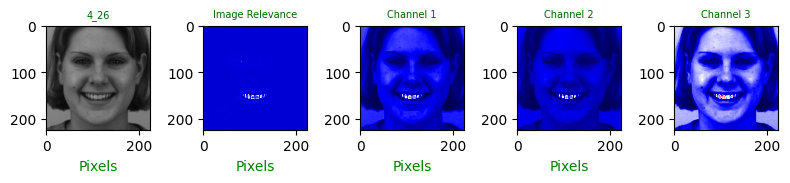

['4', '/content/ktrain_dir/0/AF33NES.png', 12, 212, 149171, 764, 226, 95, 30, 13, 3, 1, 150385, 1128, 142, 150385, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

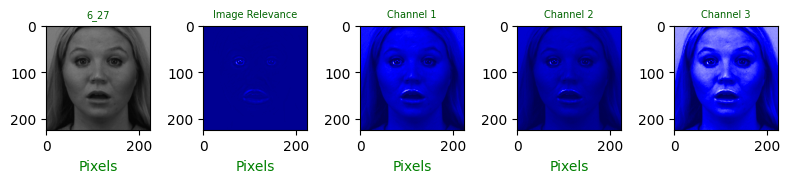

['6', '/content/ktrain_dir/0/AF34NES.png', 241, 150007, 238, 25, 9, 4, 2, 0, 0, 1, 150520, 40, 7, 150520, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

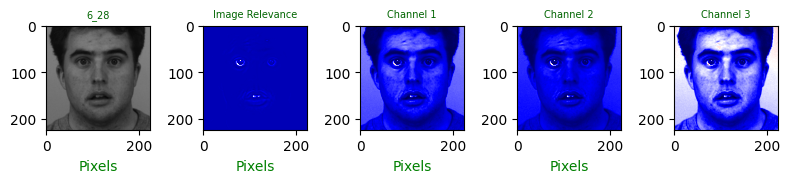

['6', '/content/ktrain_dir/0/AF35NES.png', 20, 148737, 1552, 139, 41, 22, 8, 5, 2, 1, 150489, 215, 38, 150489, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

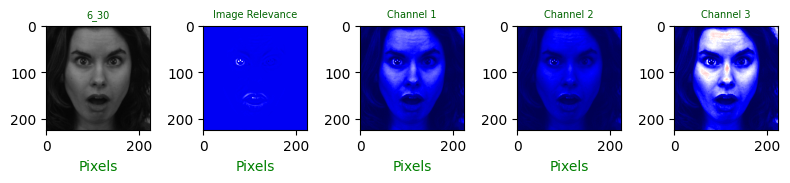

['6', '/content/ktrain_dir/0/AM02NES.png', 1, 267, 150003, 217, 24, 5, 5, 1, 1, 3, 150512, 252, 15, 150512, 'Low']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

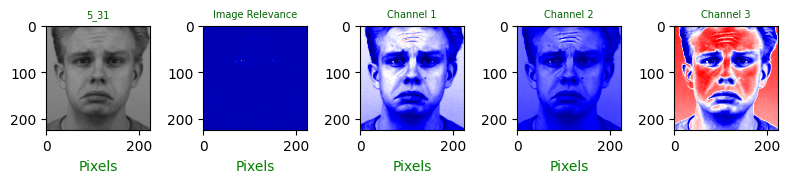

['5', '/content/ktrain_dir/0/AM04NES.png', 11, 148427, 2048, 30, 4, 4, 0, 2, 0, 1, 150520, 40, 7, 150520, 'Low']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

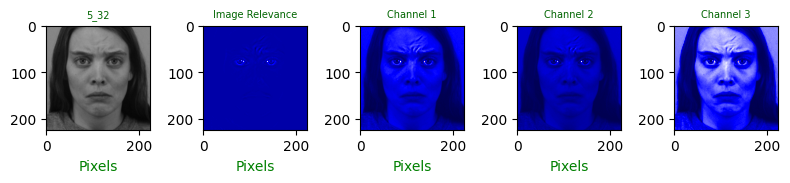

['5', '/content/ktrain_dir/0/AM05NES.png', 119, 149864, 467, 52, 18, 2, 4, 0, 0, 1, 150520, 76, 7, 150520, 'Low']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

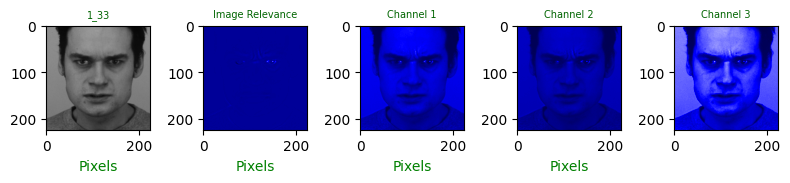

['1', '/content/ktrain_dir/0/AM07NES.png', 748, 149724, 40, 7, 5, 0, 1, 1, 0, 1, 150524, 14, 3, 150524, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

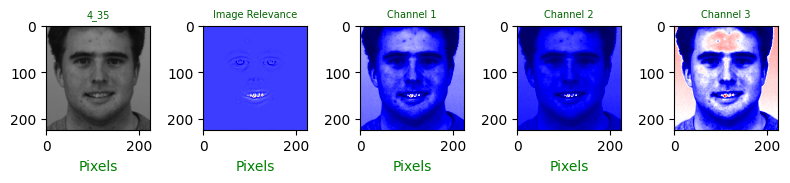

['4', '/content/ktrain_dir/0/AM09NES.png', 7, 76, 1053, 149092, 196, 67, 21, 11, 2, 2, 150424, 149387, 103, 150424, 'Low']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

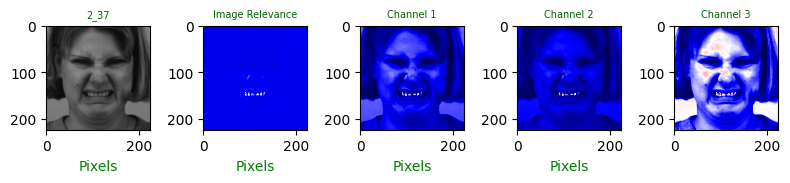

['2', '/content/ktrain_dir/0/AM11NES.png', 9, 1030, 149050, 301, 87, 27, 12, 7, 3, 1, 150477, 434, 50, 150477, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

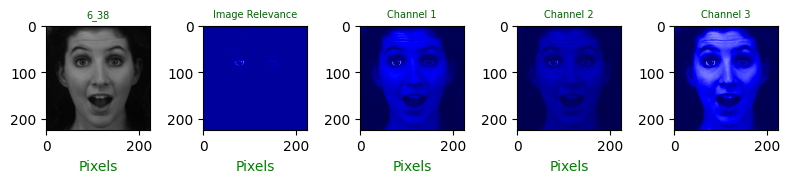

['6', '/content/ktrain_dir/0/AM12NES.png', 180, 150122, 158, 47, 15, 2, 1, 1, 0, 1, 150522, 66, 5, 150522, 'Low']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

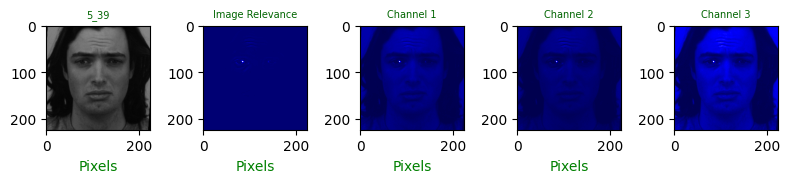

['5', '/content/ktrain_dir/0/AM13NES.png', 150072, 424, 14, 6, 3, 2, 3, 1, 0, 2, 150519, 15, 8, 150519, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

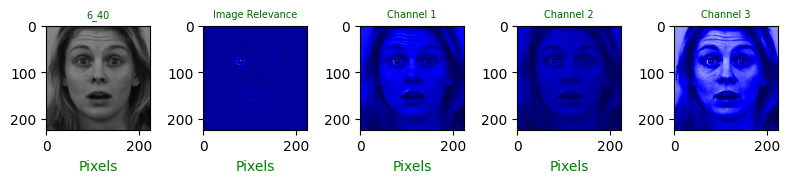

['6', '/content/ktrain_dir/0/AM14NES.png', 125, 150017, 312, 53, 15, 1, 2, 1, 0, 1, 150522, 72, 5, 150522, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

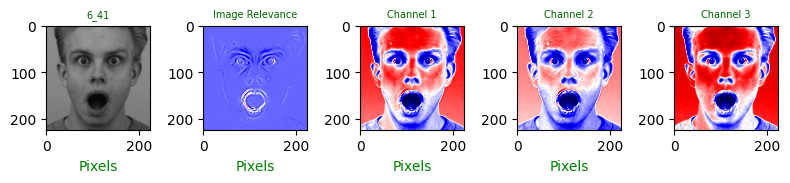

['6', '/content/ktrain_dir/0/AM15NES.png', 9, 146, 2756, 146191, 1179, 196, 42, 4, 3, 1, 150281, 147612, 246, 150281, 'Low']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

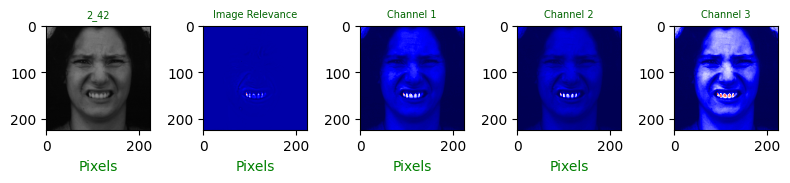

['2', '/content/ktrain_dir/0/AM18NES.png', 60, 147313, 2813, 236, 74, 20, 6, 2, 2, 1, 150496, 338, 31, 150496, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

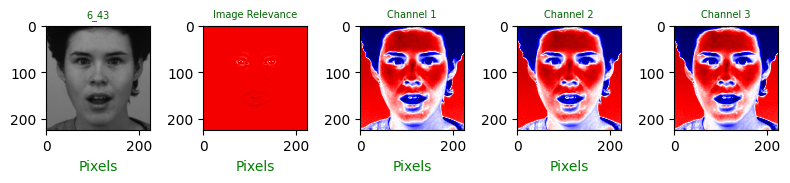

['6', '/content/ktrain_dir/0/AM19NES.png', 0, 1, 6, 3, 9, 28, 339, 149916, 213, 12, 19, 150295, 150508, 150508, 'High']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

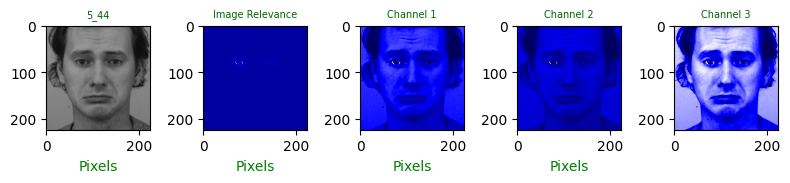

['5', '/content/ktrain_dir/0/AM20NES.png', 126, 150156, 180, 43, 16, 4, 1, 0, 0, 1, 150521, 64, 6, 150521, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

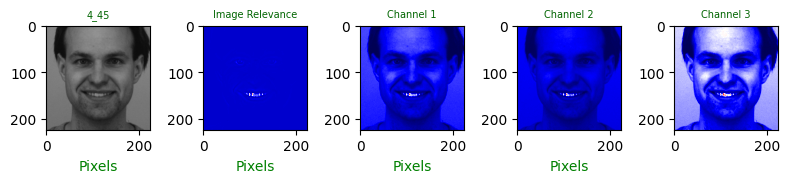

['4', '/content/ktrain_dir/0/AM21NES.png', 11, 94, 149868, 377, 111, 40, 19, 5, 0, 2, 150461, 552, 66, 150461, 'Low']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

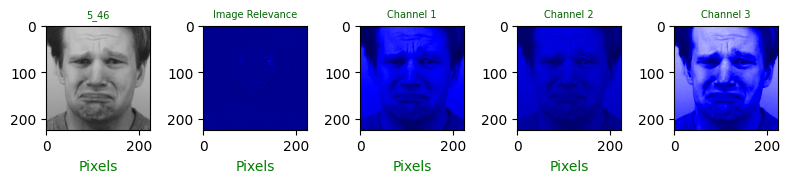

['5', '/content/ktrain_dir/0/AM22NES.png', 122, 150339, 51, 6, 4, 2, 1, 0, 1, 1, 150522, 13, 5, 150522, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

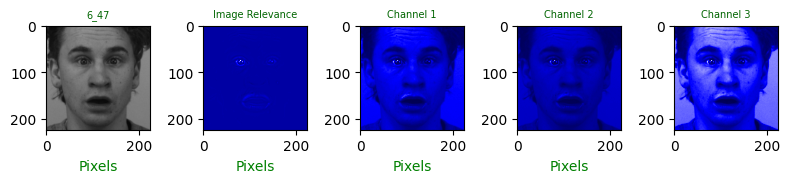

['6', '/content/ktrain_dir/0/AM24NES.png', 140, 150113, 204, 46, 14, 3, 3, 1, 1, 2, 150517, 67, 10, 150517, 'Low']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

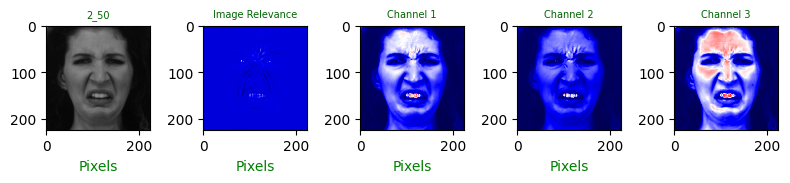

['2', '/content/ktrain_dir/0/AM28NES.png', 5, 832, 149246, 414, 22, 2, 1, 2, 0, 3, 150519, 441, 8, 150519, 'Low']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

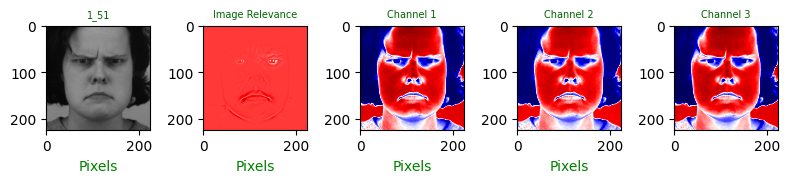

['1', '/content/ktrain_dir/0/AM29NES.png', 0, 1, 2, 3, 11, 64, 1722, 148598, 114, 12, 17, 150398, 150510, 150510, 'High']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

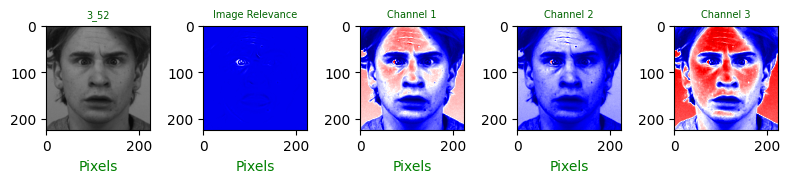

['3', '/content/ktrain_dir/0/AM30NES.png', 2, 127, 149882, 419, 66, 21, 5, 1, 3, 1, 150496, 512, 31, 150496, 'Low']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

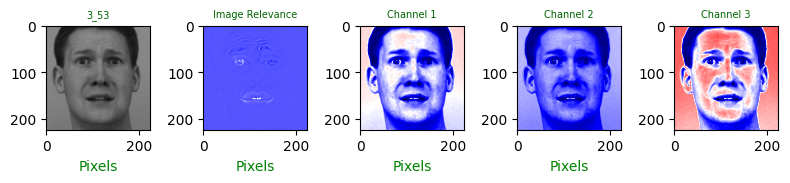

['3', '/content/ktrain_dir/0/AM31NES.png', 0, 6, 100, 150181, 202, 23, 10, 4, 0, 1, 150489, 150420, 38, 150489, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

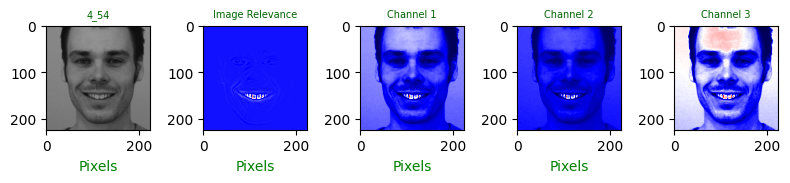

['4', '/content/ktrain_dir/0/AM34NES.png', 3, 37, 269, 149401, 574, 131, 70, 28, 10, 4, 150284, 150204, 243, 150284, 'Low']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

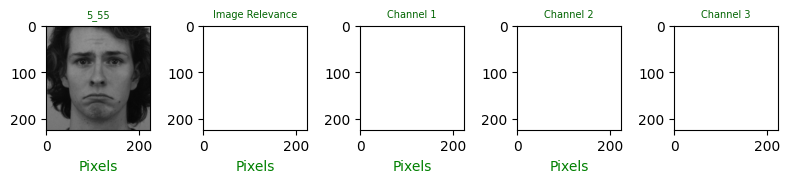

['5', '/content/ktrain_dir/0/AM35NES.png', 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 'Low']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

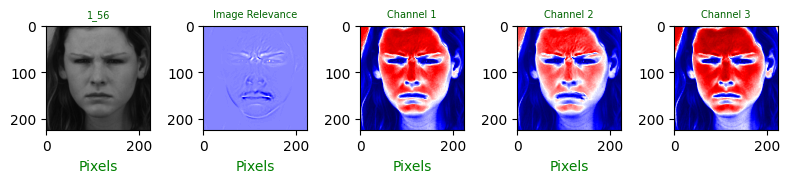

['1', '/content/ktrain_dir/1/AF01ANS.png', 7, 30, 323, 147369, 2739, 45, 9, 2, 1, 2, 150468, 150164, 59, 150468, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

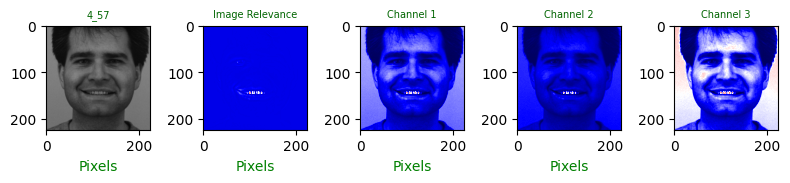

['4', '/content/ktrain_dir/1/AF02ANS.png', 24, 186, 149750, 372, 107, 46, 29, 7, 4, 2, 150439, 561, 88, 150439, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

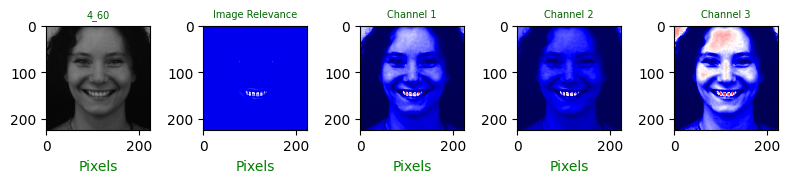

['4', '/content/ktrain_dir/1/AF05ANS.png', 7, 69, 145197, 4819, 290, 113, 23, 8, 0, 1, 150382, 5253, 145, 150382, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

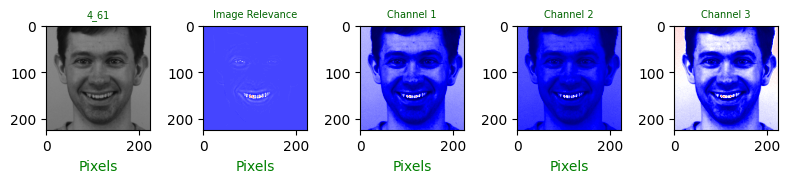

['4', '/content/ktrain_dir/1/AF06ANS.png', 2, 5, 35, 149336, 902, 161, 54, 18, 9, 5, 150280, 150471, 247, 150471, 'Medium']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

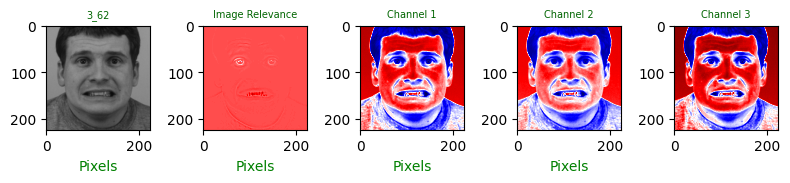

['3', '/content/ktrain_dir/1/AF07ANS.png', 1, 2, 2, 3, 14, 177, 149748, 514, 56, 10, 22, 150456, 150505, 150505, 'High']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

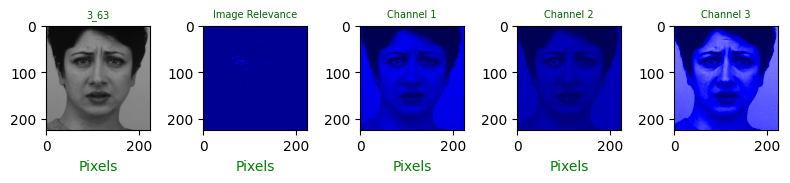

['3', '/content/ktrain_dir/1/AF08ANS.png', 225, 150203, 78, 14, 4, 0, 1, 1, 0, 1, 150524, 20, 3, 150524, 'Low']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

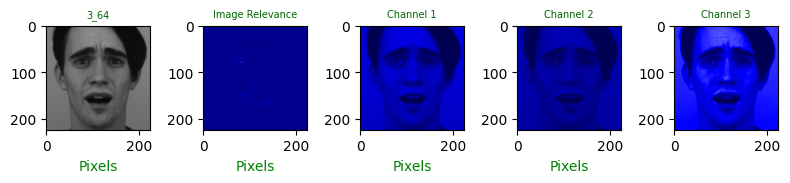

['3', '/content/ktrain_dir/1/AF10ANS.png', 3554, 146916, 42, 8, 4, 1, 1, 0, 0, 1, 150524, 14, 3, 150524, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

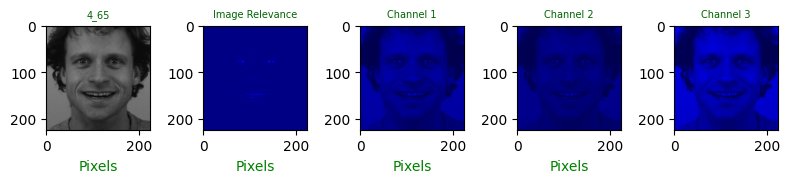

['4', '/content/ktrain_dir/1/AF13ANS.png', 147479, 2956, 64, 17, 5, 2, 2, 0, 1, 1, 150521, 26, 6, 150521, 'Low']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

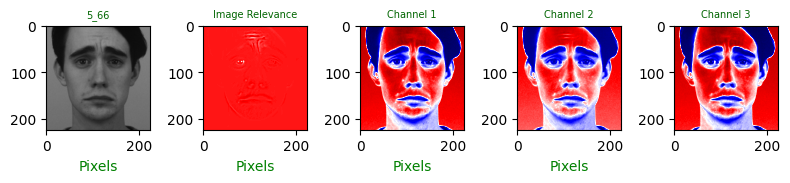

['5', '/content/ktrain_dir/1/AF14ANS.png', 0, 0, 2, 1, 9, 101, 144507, 5847, 53, 7, 12, 150465, 150515, 150515, 'High']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

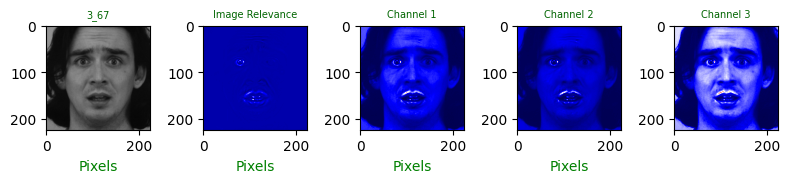

['3', '/content/ktrain_dir/1/AF15ANS.png', 274, 149193, 867, 140, 34, 9, 5, 1, 3, 1, 150508, 189, 19, 150508, 'Low']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

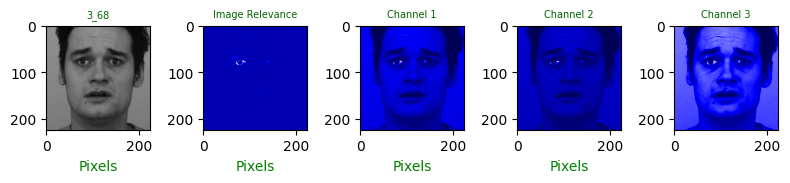

['3', '/content/ktrain_dir/1/AF17ANS.png', 43, 148785, 1526, 99, 42, 16, 7, 7, 0, 2, 150495, 171, 32, 150495, 'Low']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

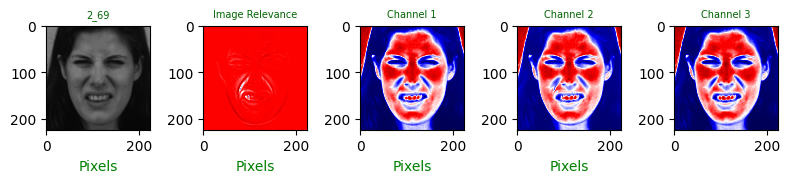

['2', '/content/ktrain_dir/1/AF19ANS.png', 2, 1, 11, 26, 89, 325, 7786, 142063, 191, 33, 129, 150289, 150398, 150398, 'High']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

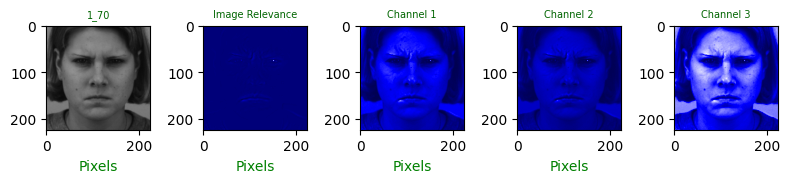

['1', '/content/ktrain_dir/1/AF20ANS.png', 147149, 3364, 7, 3, 2, 0, 1, 0, 0, 1, 150525, 6, 2, 150525, 'Low']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

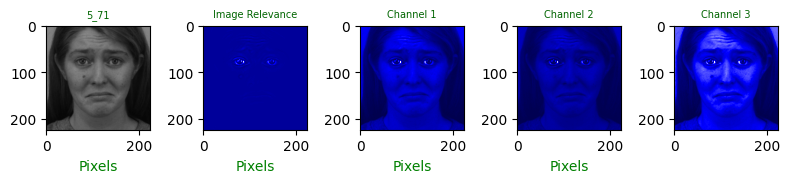

['5', '/content/ktrain_dir/1/AF21ANS.png', 208, 149874, 325, 83, 22, 6, 6, 0, 1, 2, 150512, 117, 15, 150512, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

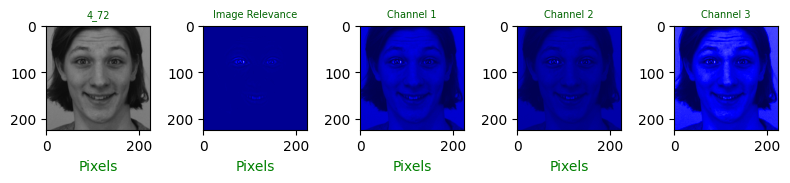

['4', '/content/ktrain_dir/1/AF22ANS.png', 690, 149604, 191, 21, 14, 3, 3, 0, 0, 1, 150520, 41, 7, 150520, 'Low']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

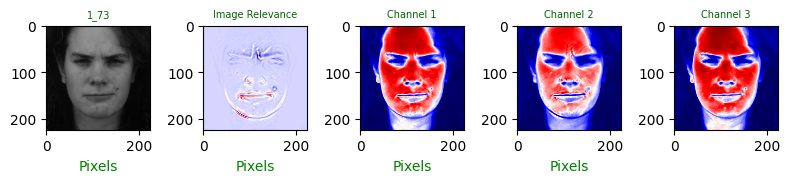

['1', '/content/ktrain_dir/1/AF23ANS.png', 8, 19, 42, 201, 4098, 145142, 868, 125, 19, 5, 4368, 150434, 146159, 150434, 'Medium']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

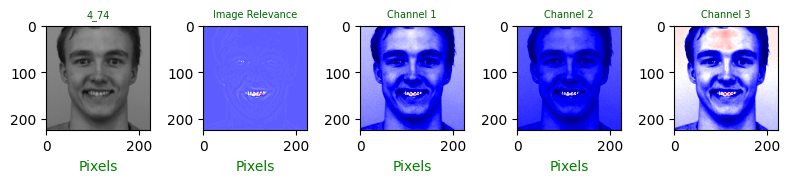

['4', '/content/ktrain_dir/1/AF24ANS.png', 3, 19, 83, 149605, 548, 170, 65, 21, 10, 3, 150258, 150409, 269, 150409, 'Medium']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

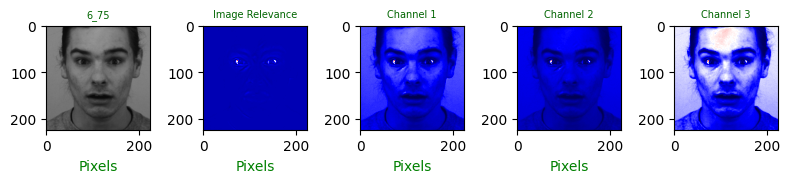

['6', '/content/ktrain_dir/1/AF25ANS.png', 52, 149208, 1082, 102, 44, 21, 10, 4, 2, 2, 150488, 181, 39, 150488, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

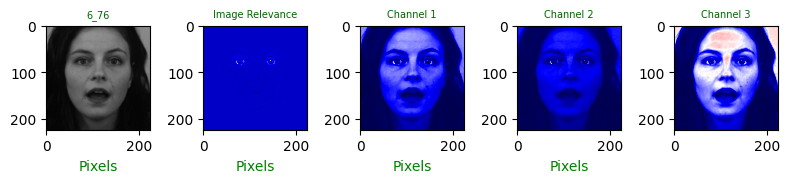

['6', '/content/ktrain_dir/1/AF27ANS.png', 48, 149677, 649, 113, 28, 7, 3, 0, 0, 2, 150515, 151, 12, 150515, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

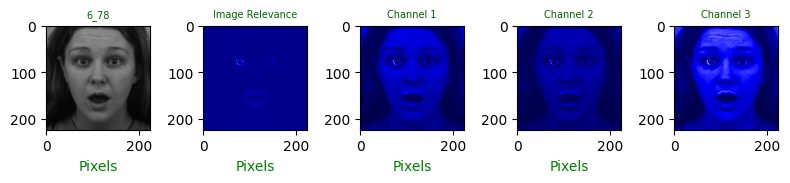

['6', '/content/ktrain_dir/1/AF29ANS.png', 1310, 148914, 235, 45, 13, 3, 3, 0, 2, 2, 150517, 64, 10, 150517, 'Low']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

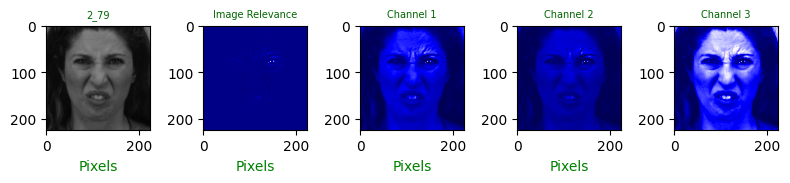

['2', '/content/ktrain_dir/1/AF30ANS.png', 10998, 139446, 49, 15, 4, 6, 2, 4, 1, 2, 150512, 31, 15, 150512, 'Low']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

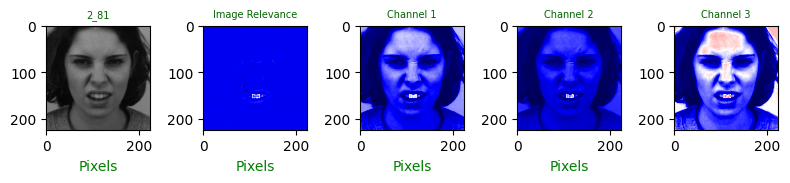

['2', '/content/ktrain_dir/1/AF33ANS.png', 5, 39, 148591, 1690, 128, 47, 19, 4, 2, 2, 150453, 1888, 74, 150453, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

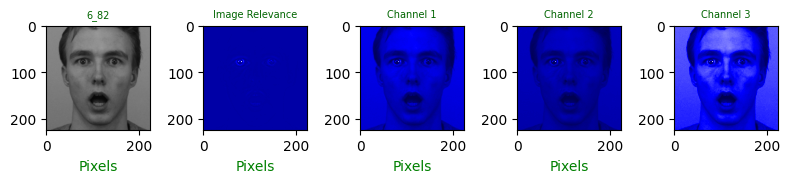

['6', '/content/ktrain_dir/1/AF34ANS.png', 64, 150308, 122, 20, 6, 2, 3, 0, 1, 1, 150520, 31, 7, 150520, 'Low']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

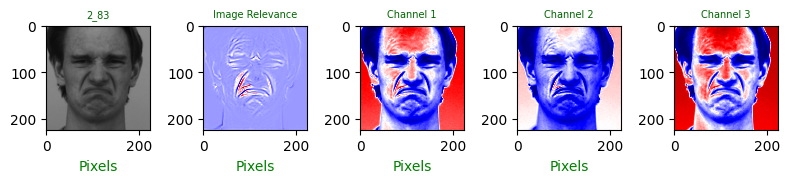

['2', '/content/ktrain_dir/1/AF35ANS.png', 14, 52, 168, 2007, 146519, 1434, 233, 76, 20, 4, 148760, 150269, 1767, 150269, 'Medium']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

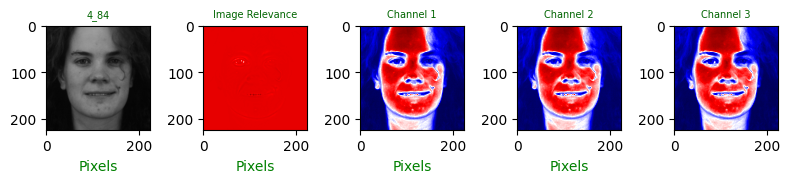

['4', '/content/ktrain_dir/1/AM01ANS.png', 0, 0, 0, 1, 1, 8, 44, 149438, 1017, 18, 2, 149492, 150525, 150525, 'High']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

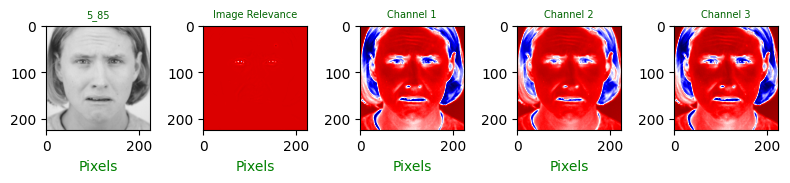

['5', '/content/ktrain_dir/1/AM02ANS.png', 0, 1, 2, 3, 7, 16, 59, 1731, 148686, 22, 13, 1816, 150514, 150514, 'High']


In [ ]:

all_image_data = []

n = 1
image_names = []
positive = []
negative_counts = []
relevance_scores = []

# for inputs, labels in train_loader:
for inputs, labels in test_loader:
    inputs = inputs.to(device)
    outputs = model(inputs).max(1).indices.detach().cpu().numpy()
    for i in range(inputs.shape[0]):
        image_id = i

        try:
            image_relevances = apply_lrp_on_vgg16(model, inputs[image_id])
            image_relevances = image_relevances.permute(0, 2, 3, 1).detach().cpu().numpy()[0]
            image_relevances = np.interp(image_relevances, (image_relevances.min(), image_relevances.max()), (0, 1))
            image_relevances_transposed = np.transpose(image_relevances, (2, 0, 1))
            pixel_relevance_scores = inputs[image_id].detach().cpu().numpy() * np.transpose(image_relevances, (2, 0, 1))

            pred_label = list(test_dataset.class_to_idx.keys())[list(test_dataset.class_to_idx.values()).index(labels[image_id])]
            image_name = pred_label + '_' + str(n)
            # Add condition to process images only for the specified emotion class
            # if pred_label == emotion_class:
            if outputs[image_id] == labels[image_id]:
                # Retrieve the original image pathname
                original_image_path = train_dataset.imgs[n][0]

                print("Groundtruth for this image:", pred_label)

                plt.clf()  # Clear the previous figure
                fig = plt.figure(figsize=(8,8))

                plt.subplot(5,5, 1)
                plt.xlabel("Pixels", color = 'green')
                plt.imshow(inputs[image_id].permute(1, 2, 0).detach().cpu().numpy())
                plt.title(image_name, fontsize = 7, color = 'darkgreen')

                plt.subplot(5,5, 2)
                plt.xlabel("Pixels", color = 'green')
                plt.imshow(image_relevances[:, :, 0], cmap="seismic")
                plt.title("Image Relevance", fontsize = 7, color = 'darkgreen')

                plt.subplot(5,5, 3)
                plt.xlabel("Pixels", color = 'green')
                plt.imshow(pixel_relevance_scores[0], cmap="seismic")
                plt.title("Channel 1", fontsize = 7, color = 'darkgreen')

                plt.subplot(5,5, 4)
                plt.xlabel("Pixels", color = 'green')
                plt.imshow(pixel_relevance_scores[1], cmap="seismic")
                plt.title("Channel 2", fontsize = 7, color = 'darkgreen')

                plt.subplot(5, 5, 5)
                plt.imshow(pixel_relevance_scores[2], cmap="seismic")
                plt.title("Channel 3", fontsize = 7, color='darkgreen')

                plt.tight_layout()
                plt.show()

                image_names.append(image_name)
                relevance_scores.append(image_relevances)
                # print("-------------------------------------------------------------------------------------------------------")
                pixel_count, lmhv = calculate_range_by_mean5(image_relevances)
                lmh = ["Low", "Medium", "High"]
                intensity = lmh[lmhv.index(max(lmhv))]
                # print(intensity+" "+pred_label)
                # print("-------------------------------------------------------------------------------------------------------")
                a, b, c, d, e, f, g, h, i, j = pixel_count
                m1, m2, m3 = lmhv
                image_details = [pred_label,original_image_path, a, b, c, d, e, f, g, h, i, j, m1, m2, m3, max(lmhv), intensity]
                print(image_details)
                all_image_data.append(image_details)

        except TypeError:
            continue

        n += 1

Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

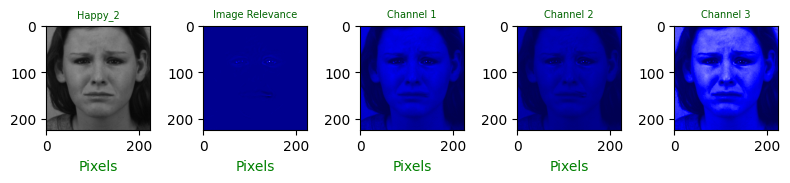

['Happy', '5', '/content/ktest_dir/0/AF10NES.png', 141148, 9339, 26, 8, 4, 0, 1, 0, 0, 1, 150525, 13, 2, 150525, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

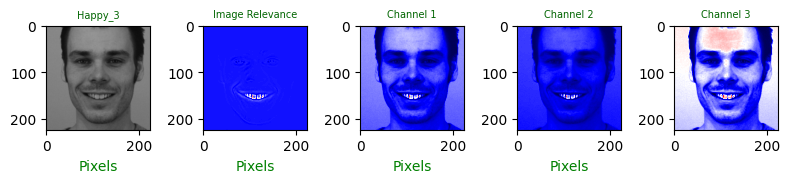

['Happy', '4', '/content/ktest_dir/0/AF15NES.png', 3, 37, 269, 149401, 574, 131, 70, 28, 10, 4, 150284, 150204, 243, 150284, 'Low']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

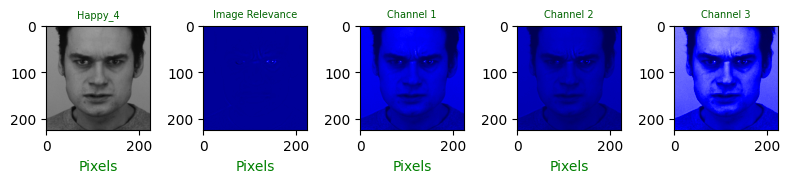

['Happy', '1', '/content/ktest_dir/0/AF24NES.png', 748, 149724, 40, 7, 5, 0, 1, 1, 0, 1, 150524, 14, 3, 150524, 'Low']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

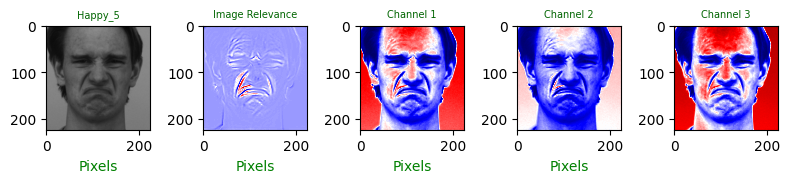

['Happy', '2', '/content/ktest_dir/0/AF25NES.png', 14, 52, 168, 2007, 146519, 1434, 233, 76, 20, 4, 148760, 150269, 1767, 150269, 'Medium']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

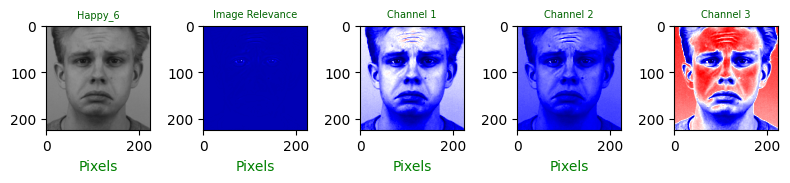

['Happy', '5', '/content/ktest_dir/0/AM03NES.png', 11, 148427, 2048, 30, 4, 4, 0, 2, 0, 1, 150520, 40, 7, 150520, 'Low']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

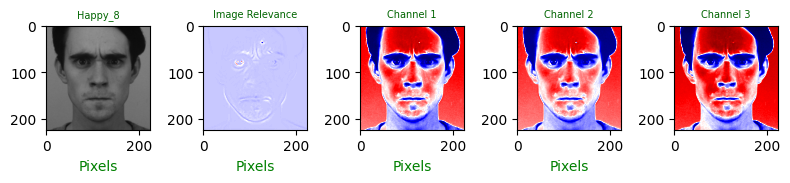

['Happy', '1', '/content/ktest_dir/0/AM16NES.png', 0, 2, 2, 5, 145494, 4986, 30, 4, 1, 3, 145503, 150519, 5024, 150519, 'Medium']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

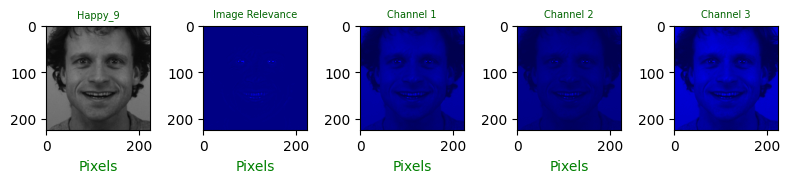

['Happy', '4', '/content/ktest_dir/0/AM17NES.png', 147479, 2956, 64, 17, 5, 2, 2, 0, 1, 1, 150521, 26, 6, 150521, 'Low']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

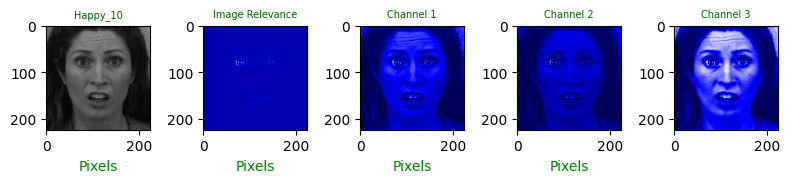

['Happy', '3', '/content/ktest_dir/0/AM23NES.png', 35, 149659, 678, 112, 26, 10, 4, 1, 0, 2, 150510, 153, 17, 150510, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

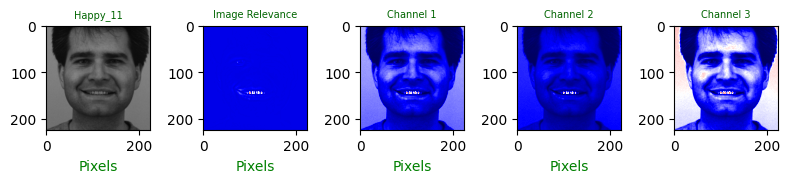

['Happy', '4', '/content/ktest_dir/0/AM25NES.png', 24, 186, 149750, 372, 107, 46, 29, 7, 4, 2, 150439, 561, 88, 150439, 'Low']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

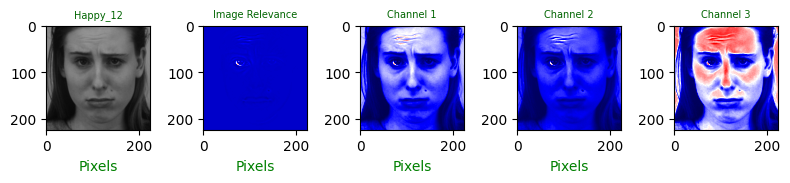

['Happy', '5', '/content/ktest_dir/0/AM32NES.png', 20, 547, 149670, 207, 44, 20, 9, 2, 3, 5, 150488, 282, 39, 150488, 'Low']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

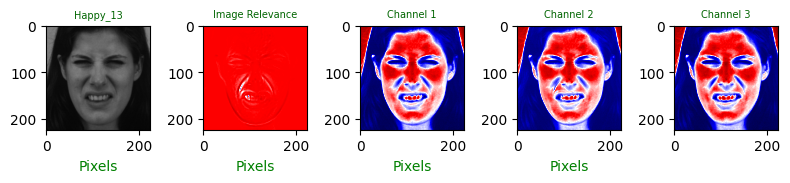

['Happy', '2', '/content/ktest_dir/0/AM33NES.png', 2, 1, 11, 26, 89, 325, 7786, 142063, 191, 33, 129, 150289, 150398, 150398, 'High']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

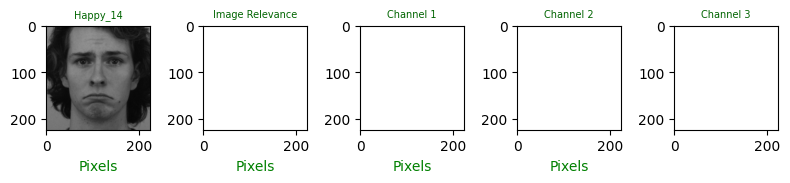

['Happy', '5', '/content/ktest_dir/1/AF09ANS.png', 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 'Low']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

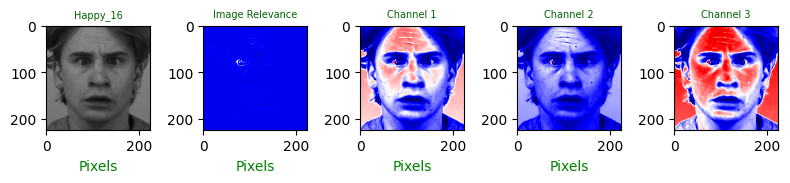

['Happy', '3', '/content/ktest_dir/1/AF12ANS.png', 2, 127, 149882, 419, 66, 21, 5, 1, 3, 1, 150496, 512, 31, 150496, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

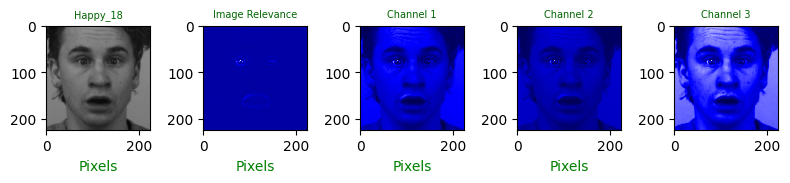

['Happy', '6', '/content/ktest_dir/1/AF18ANS.png', 140, 150113, 204, 46, 14, 3, 3, 1, 1, 2, 150517, 67, 10, 150517, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

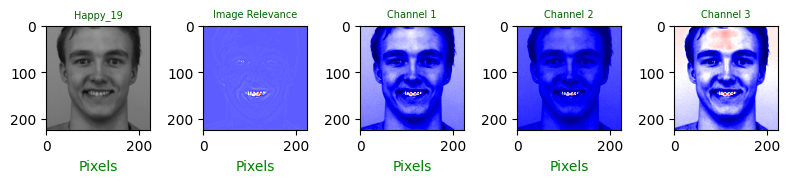

['Happy', '4', '/content/ktest_dir/1/AF26ANS.png', 3, 19, 83, 149605, 548, 170, 65, 21, 10, 3, 150258, 150409, 269, 150409, 'Medium']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

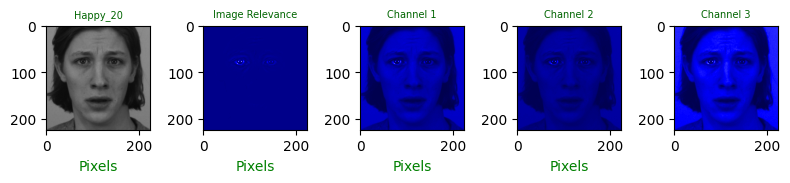

['Happy', '3', '/content/ktest_dir/1/AF31ANS.png', 135187, 15222, 86, 22, 5, 2, 1, 0, 1, 1, 150522, 30, 5, 150522, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

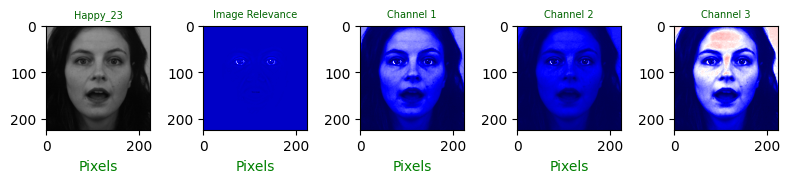

['Happy', '6', '/content/ktest_dir/1/AM22ANS.png', 48, 149677, 649, 113, 28, 7, 3, 0, 0, 2, 150515, 151, 12, 150515, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

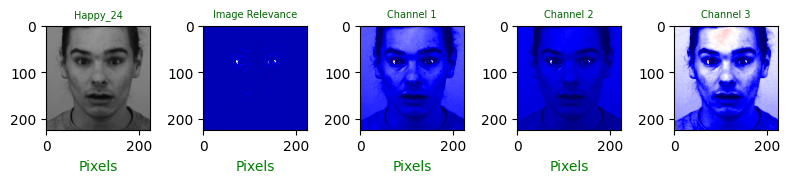

['Happy', '6', '/content/ktest_dir/1/AM24ANS.png', 52, 149208, 1082, 102, 44, 21, 10, 4, 2, 2, 150488, 181, 39, 150488, 'Low']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

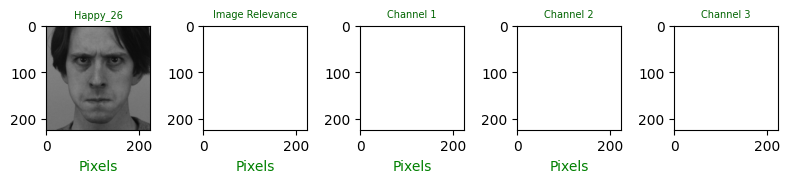

['Happy', '1', '/content/ktest_dir/1/AM28ANS.png', 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

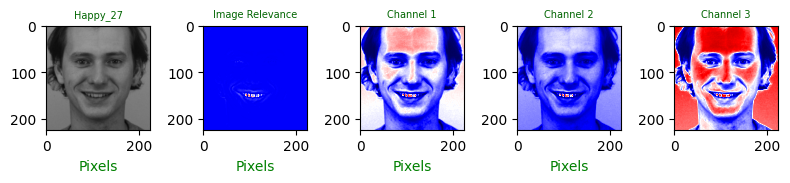

['Happy', '4', '/content/ktest_dir/1/AM31ANS.png', 5, 63, 790, 149268, 225, 88, 54, 18, 14, 2, 150351, 149653, 176, 150351, 'Low']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

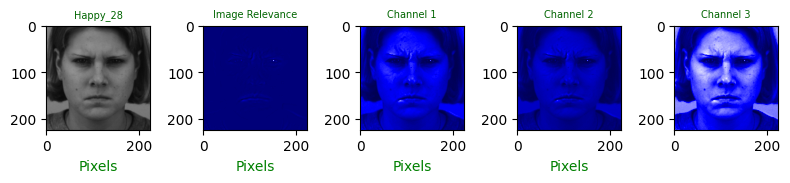

['Happy', '1', '/content/ktest_dir/2/AF02DIS.png', 147149, 3364, 7, 3, 2, 0, 1, 0, 0, 1, 150525, 6, 2, 150525, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

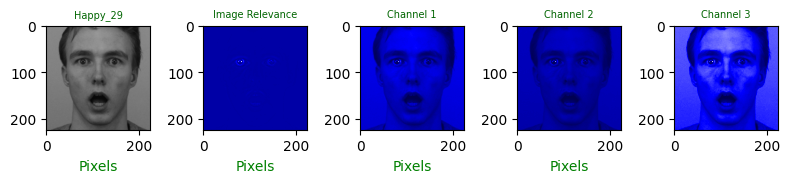

['Happy', '6', '/content/ktest_dir/2/AF03DIS.png', 64, 150308, 122, 20, 6, 2, 3, 0, 1, 1, 150520, 31, 7, 150520, 'Low']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

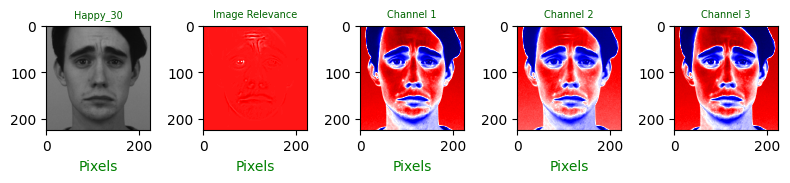

['Happy', '5', '/content/ktest_dir/2/AF07DIS.png', 0, 0, 2, 1, 9, 101, 144507, 5847, 53, 7, 12, 150465, 150515, 150515, 'High']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

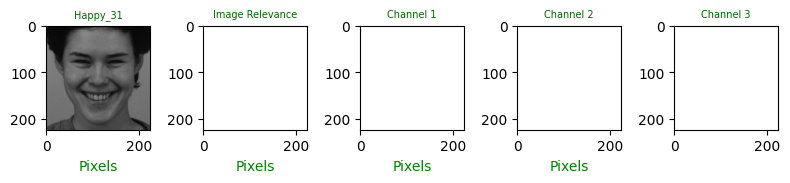

['Happy', '4', '/content/ktest_dir/2/AF11DIS.png', 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

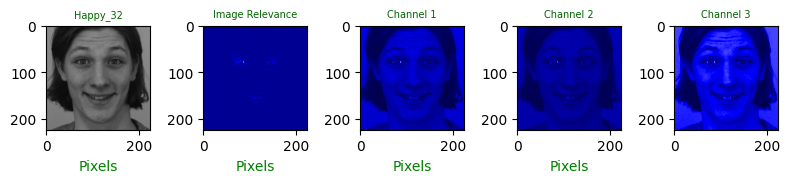

['Happy', '4', '/content/ktest_dir/2/AF13DIS.png', 690, 149604, 191, 21, 14, 3, 3, 0, 0, 1, 150520, 41, 7, 150520, 'Low']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

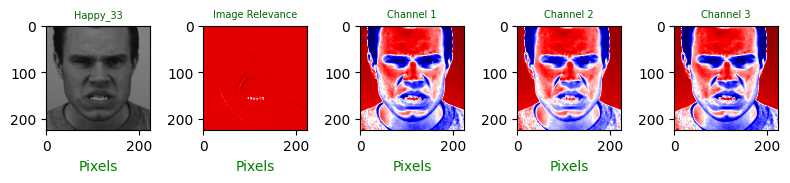

['Happy', '1', '/content/ktest_dir/2/AF18DIS.png', 1, 1, 7, 15, 30, 100, 485, 149018, 832, 38, 54, 149648, 150473, 150473, 'High']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

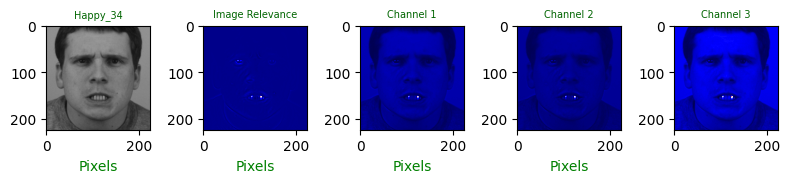

['Happy', '1', '/content/ktest_dir/2/AF20DIS.png', 609, 149696, 134, 43, 19, 12, 5, 6, 2, 1, 150501, 85, 26, 150501, 'Low']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

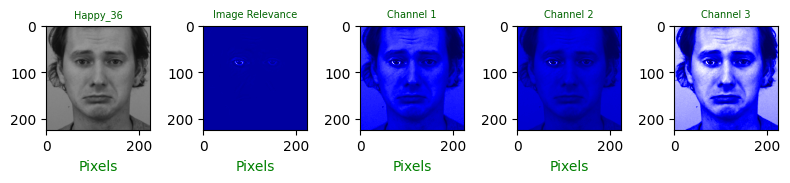

['Happy', '5', '/content/ktest_dir/2/AF23DIS.png', 126, 150156, 180, 43, 16, 4, 1, 0, 0, 1, 150521, 64, 6, 150521, 'Low']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

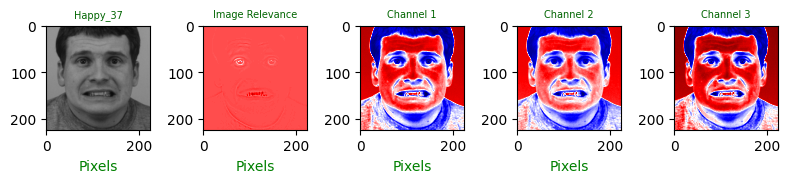

['Happy', '3', '/content/ktest_dir/2/AF26DIS.png', 1, 2, 2, 3, 14, 177, 149748, 514, 56, 10, 22, 150456, 150505, 150505, 'High']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

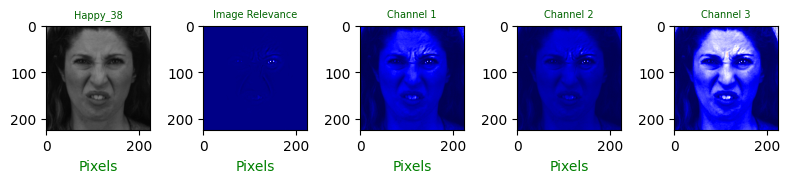

['Happy', '2', '/content/ktest_dir/2/AM05DIS.png', 10998, 139446, 49, 15, 4, 6, 2, 4, 1, 2, 150512, 31, 15, 150512, 'Low']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

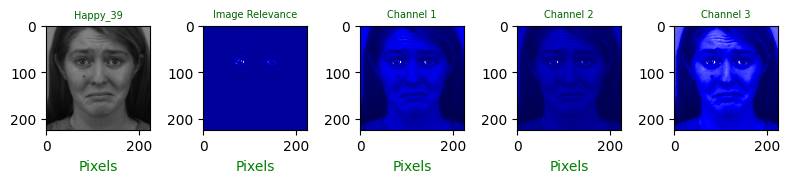

['Happy', '5', '/content/ktest_dir/2/AM16DIS.png', 208, 149874, 325, 83, 22, 6, 6, 0, 1, 2, 150512, 117, 15, 150512, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

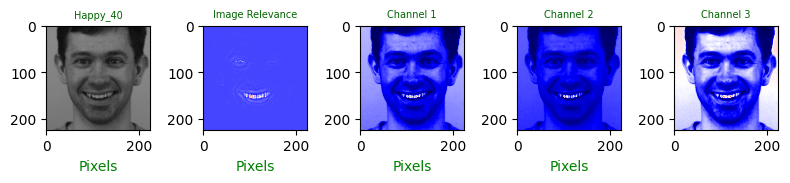

['Happy', '4', '/content/ktest_dir/2/AM21DIS.png', 2, 5, 35, 149336, 902, 161, 54, 18, 9, 5, 150280, 150471, 247, 150471, 'Medium']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

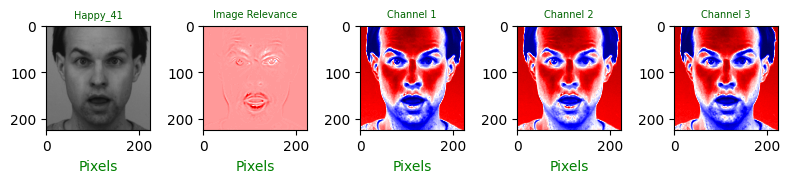

['Happy', '6', '/content/ktest_dir/2/AM23DIS.png', 0, 1, 1, 7, 101, 15115, 134991, 258, 39, 14, 110, 150472, 150417, 150472, 'Medium']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

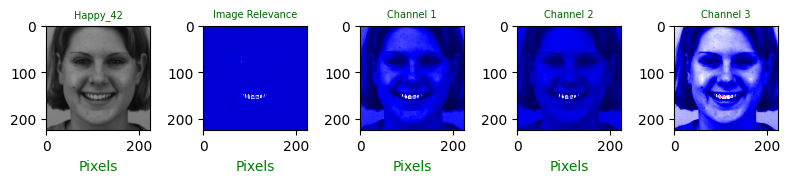

['Happy', '4', '/content/ktest_dir/3/AF08AFS.png', 12, 212, 149171, 764, 226, 95, 30, 13, 3, 1, 150385, 1128, 142, 150385, 'Low']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

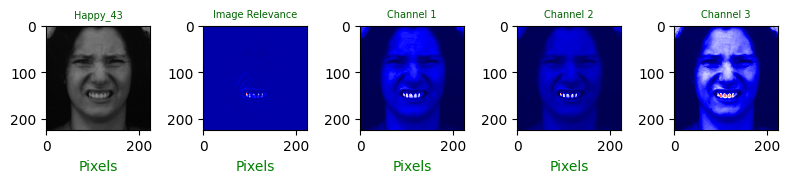

['Happy', '2', '/content/ktest_dir/3/AF10AFS.png', 60, 147313, 2813, 236, 74, 20, 6, 2, 2, 1, 150496, 338, 31, 150496, 'Low']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

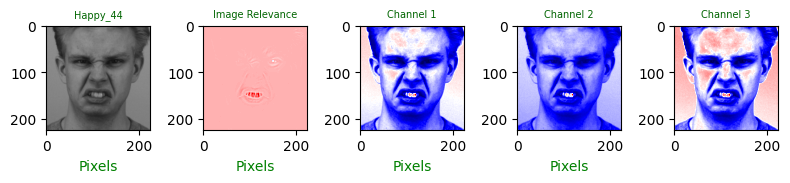

['Happy', '2', '/content/ktest_dir/3/AF11AFS.png', 0, 1, 1, 8, 29, 150035, 387, 55, 8, 3, 39, 150514, 150488, 150514, 'Medium']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

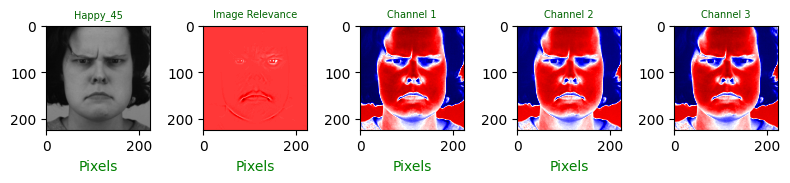

['Happy', '1', '/content/ktest_dir/3/AF21AFS.png', 0, 1, 2, 3, 11, 64, 1722, 148598, 114, 12, 17, 150398, 150510, 150510, 'High']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

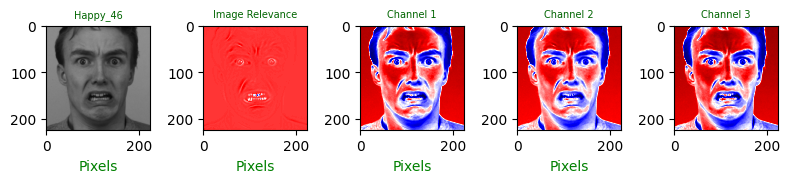

['Happy', '3', '/content/ktest_dir/3/AF23AFS.png', 1, 9, 18, 41, 134, 626, 149366, 323, 6, 3, 203, 150490, 150324, 150490, 'Medium']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

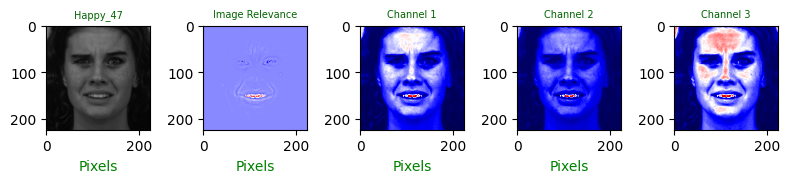

['Happy', '3', '/content/ktest_dir/3/AM06AFS.png', 0, 5, 95, 149528, 644, 150, 71, 27, 6, 1, 150272, 150420, 255, 150420, 'Medium']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

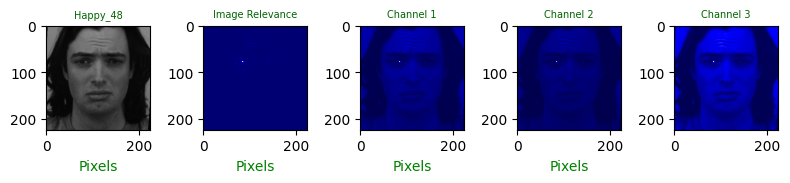

['Happy', '5', '/content/ktest_dir/3/AM08AFS.png', 150072, 424, 14, 6, 3, 2, 3, 1, 0, 2, 150519, 15, 8, 150519, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

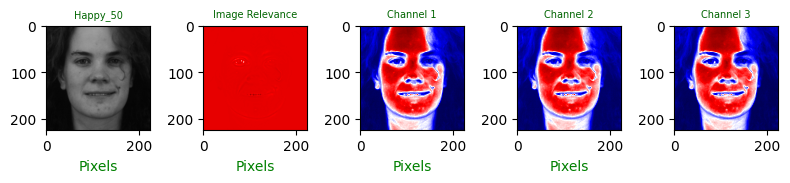

['Happy', '4', '/content/ktest_dir/3/AM16AFS.png', 0, 0, 0, 1, 1, 8, 44, 149438, 1017, 18, 2, 149492, 150525, 150525, 'High']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

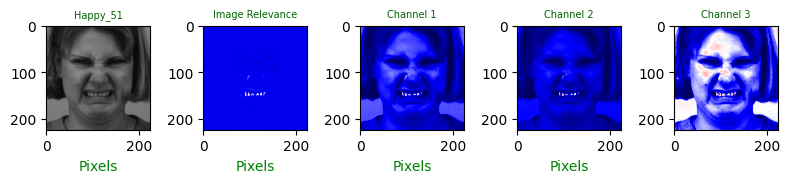

['Happy', '2', '/content/ktest_dir/3/AM18AFS.png', 9, 1030, 149050, 301, 87, 27, 12, 7, 3, 1, 150477, 434, 50, 150477, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

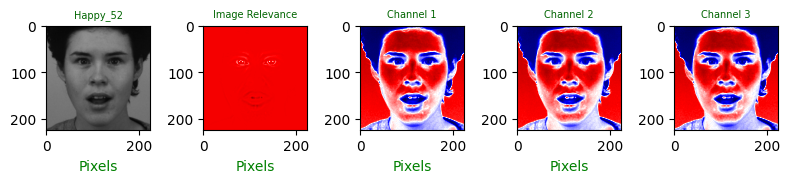

['Happy', '6', '/content/ktest_dir/3/AM24AFS.png', 0, 1, 6, 3, 9, 28, 339, 149916, 213, 12, 19, 150295, 150508, 150508, 'High']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

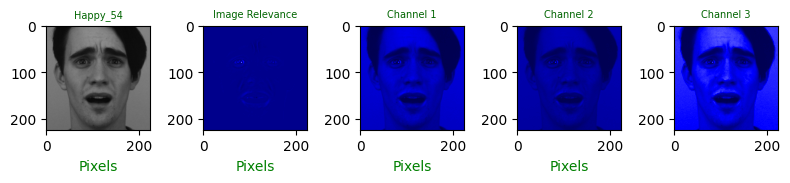

['Happy', '3', '/content/ktest_dir/3/AM32AFS.png', 3554, 146916, 42, 8, 4, 1, 1, 0, 0, 1, 150524, 14, 3, 150524, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

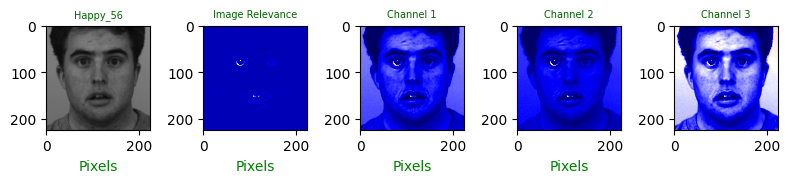

['Happy', '6', '/content/ktest_dir/4/AF02HAS.png', 20, 148737, 1552, 139, 41, 22, 8, 5, 2, 1, 150489, 215, 38, 150489, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

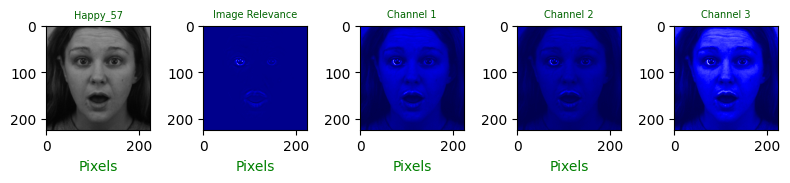

['Happy', '6', '/content/ktest_dir/4/AF12HAS.png', 1310, 148914, 235, 45, 13, 3, 3, 0, 2, 2, 150517, 64, 10, 150517, 'Low']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

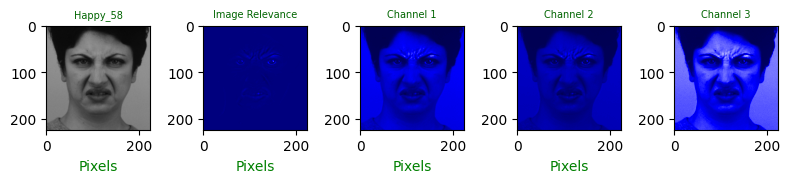

['Happy', '2', '/content/ktest_dir/4/AF16HAS.png', 139138, 11287, 80, 12, 7, 1, 1, 0, 0, 1, 150524, 21, 3, 150524, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

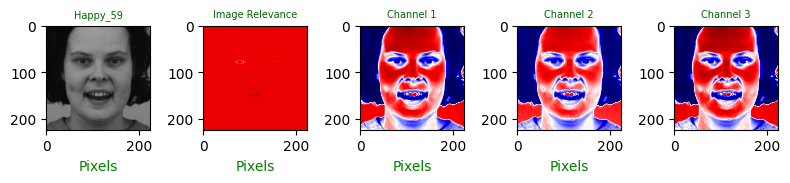

['Happy', '4', '/content/ktest_dir/4/AF26HAS.png', 0, 0, 1, 1, 3, 16, 85, 148977, 1419, 25, 5, 149082, 150522, 150522, 'High']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

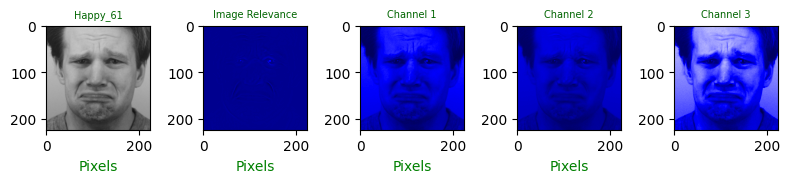

['Happy', '5', '/content/ktest_dir/4/AM02HAS.png', 122, 150339, 51, 6, 4, 2, 1, 0, 1, 1, 150522, 13, 5, 150522, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

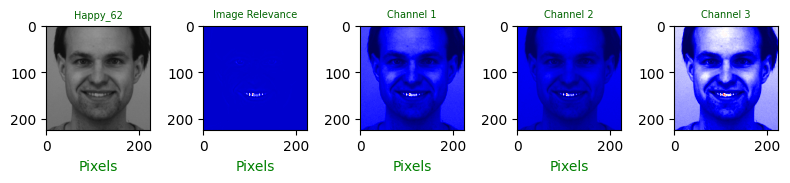

['Happy', '4', '/content/ktest_dir/4/AM04HAS.png', 11, 94, 149868, 377, 111, 40, 19, 5, 0, 2, 150461, 552, 66, 150461, 'Low']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

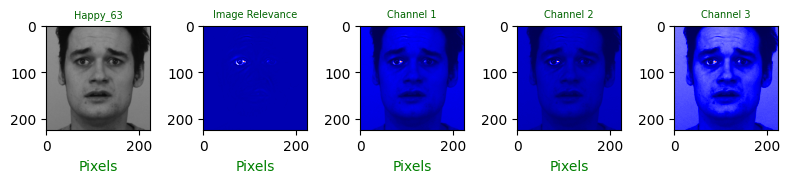

['Happy', '3', '/content/ktest_dir/4/AM08HAS.png', 43, 148785, 1526, 99, 42, 16, 7, 7, 0, 2, 150495, 171, 32, 150495, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

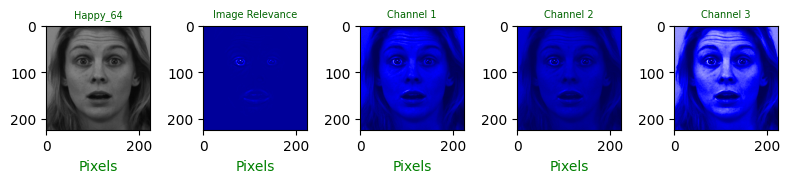

['Happy', '6', '/content/ktest_dir/4/AM13HAS.png', 125, 150017, 312, 53, 15, 1, 2, 1, 0, 1, 150522, 72, 5, 150522, 'Low']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

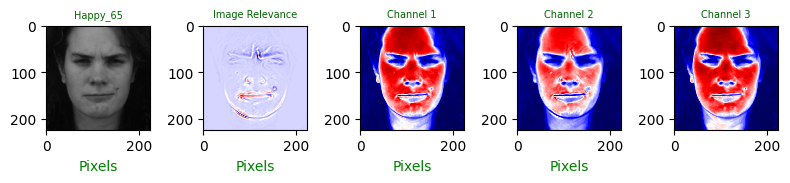

['Happy', '1', '/content/ktest_dir/4/AM18HAS.png', 8, 19, 42, 201, 4098, 145142, 868, 125, 19, 5, 4368, 150434, 146159, 150434, 'Medium']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

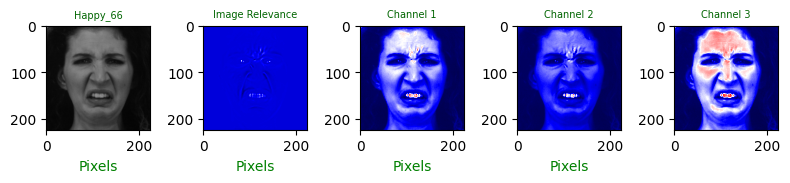

['Happy', '2', '/content/ktest_dir/4/AM27HAS.png', 5, 832, 149246, 414, 22, 2, 1, 2, 0, 3, 150519, 441, 8, 150519, 'Low']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

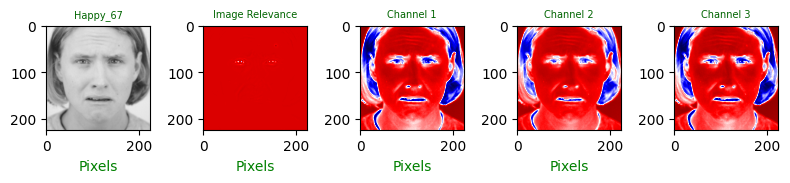

['Happy', '5', '/content/ktest_dir/4/AM29HAS.png', 0, 1, 2, 3, 7, 16, 59, 1731, 148686, 22, 13, 1816, 150514, 150514, 'High']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

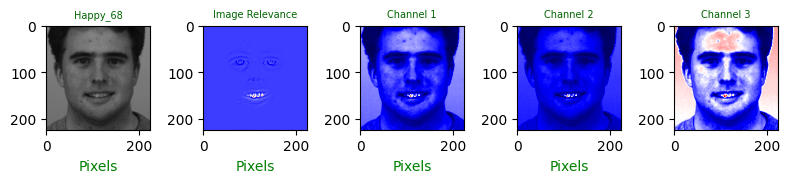

['Happy', '4', '/content/ktest_dir/4/AM30HAS.png', 7, 76, 1053, 149092, 196, 67, 21, 11, 2, 2, 150424, 149387, 103, 150424, 'Low']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

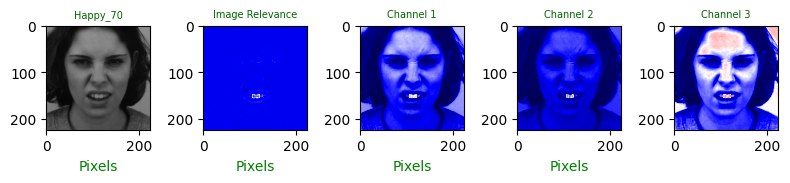

['Happy', '2', '/content/ktest_dir/5/AF05SAS.png', 5, 39, 148591, 1690, 128, 47, 19, 4, 2, 2, 150453, 1888, 74, 150453, 'Low']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

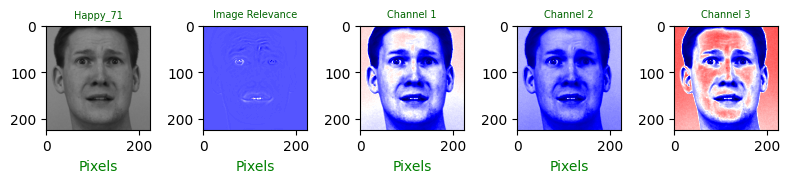

['Happy', '3', '/content/ktest_dir/5/AF09SAS.png', 0, 6, 100, 150181, 202, 23, 10, 4, 0, 1, 150489, 150420, 38, 150489, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

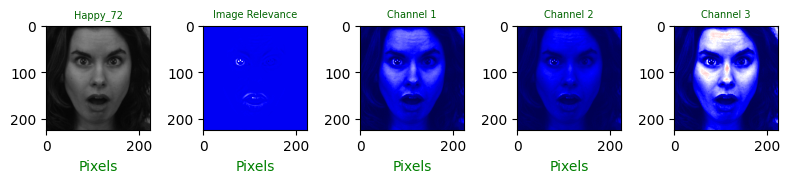

['Happy', '6', '/content/ktest_dir/5/AF12SAS.png', 1, 267, 150003, 217, 24, 5, 5, 1, 1, 3, 150512, 252, 15, 150512, 'Low']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

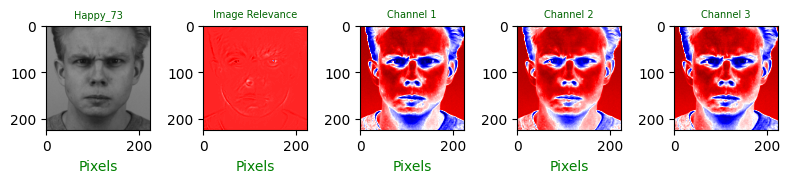

['Happy', '1', '/content/ktest_dir/5/AF21SAS.png', 1, 1, 1, 3, 4, 23, 20929, 129535, 25, 5, 10, 150494, 150517, 150517, 'High']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

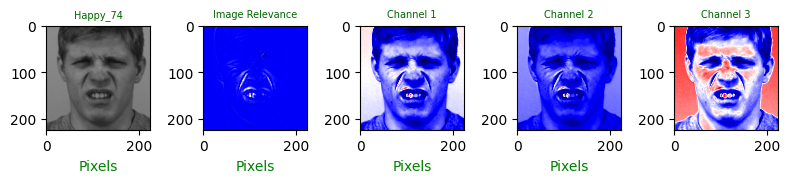

['Happy', '2', '/content/ktest_dir/5/AF22SAS.png', 17, 157, 109105, 40631, 473, 112, 22, 7, 1, 2, 150383, 41245, 144, 150383, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

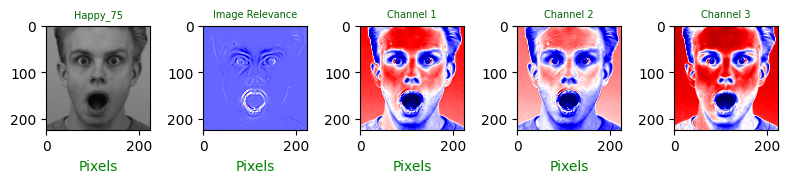

['Happy', '6', '/content/ktest_dir/5/AM01SAS.png', 9, 146, 2756, 146191, 1179, 196, 42, 4, 3, 1, 150281, 147612, 246, 150281, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

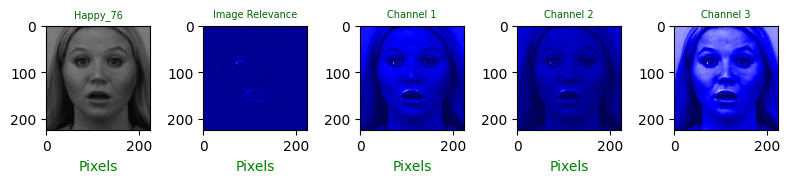

['Happy', '6', '/content/ktest_dir/5/AM05SAS.png', 241, 150007, 238, 25, 9, 4, 2, 0, 0, 1, 150520, 40, 7, 150520, 'Low']
Groundtruth for this image: 4


<Figure size 640x480 with 0 Axes>

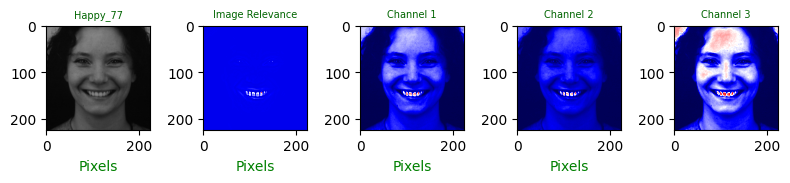

['Happy', '4', '/content/ktest_dir/5/AM13SAS.png', 7, 69, 145197, 4819, 290, 113, 23, 8, 0, 1, 150382, 5253, 145, 150382, 'Low']
Groundtruth for this image: 2


<Figure size 640x480 with 0 Axes>

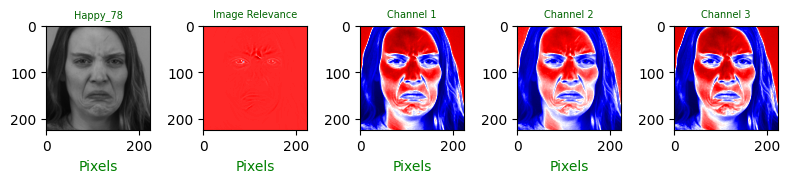

['Happy', '2', '/content/ktest_dir/5/AM14SAS.png', 1, 0, 2, 2, 15, 47, 1710, 148710, 34, 6, 20, 150484, 150507, 150507, 'High']
Groundtruth for this image: 1


<Figure size 640x480 with 0 Axes>

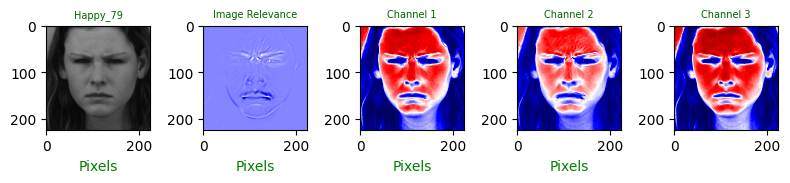

['Happy', '1', '/content/ktest_dir/5/AM17SAS.png', 7, 30, 323, 147369, 2739, 45, 9, 2, 1, 2, 150468, 150164, 59, 150468, 'Low']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

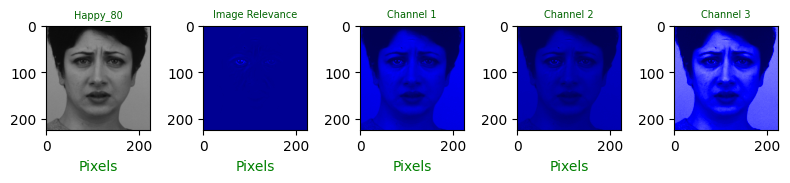

['Happy', '3', '/content/ktest_dir/5/AM20SAS.png', 225, 150203, 78, 14, 4, 0, 1, 1, 0, 1, 150524, 20, 3, 150524, 'Low']
Groundtruth for this image: 6


<Figure size 640x480 with 0 Axes>

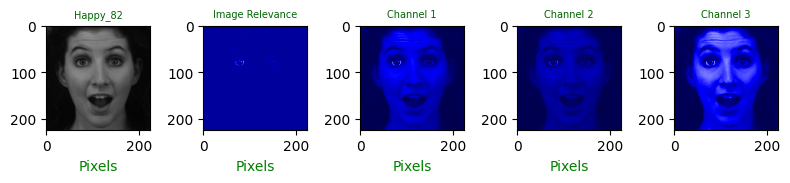

['Happy', '6', '/content/ktest_dir/5/AM24SAS.png', 180, 150122, 158, 47, 15, 2, 1, 1, 0, 1, 150522, 66, 5, 150522, 'Low']
Groundtruth for this image: 3


<Figure size 640x480 with 0 Axes>

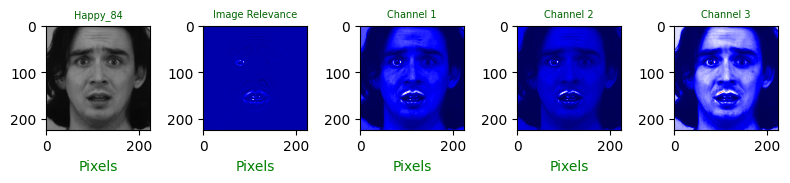

['Happy', '3', '/content/ktest_dir/6/AF06SUS.png', 274, 149193, 867, 140, 34, 9, 5, 1, 3, 1, 150508, 189, 19, 150508, 'Low']
Groundtruth for this image: 5


<Figure size 640x480 with 0 Axes>

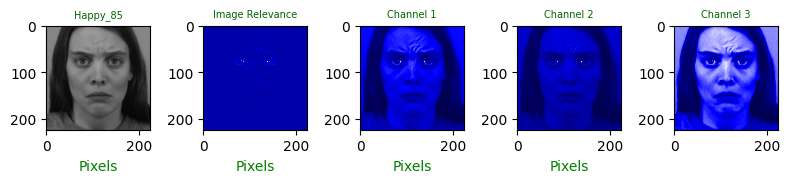

['Happy', '5', '/content/ktest_dir/6/AF13SUS.png', 119, 149864, 467, 52, 18, 2, 4, 0, 0, 1, 150520, 76, 7, 150520, 'Low']


In [ ]:
# Emotion is being displayed.
all_image_data = []

n = 1
image_names = []
positive = []
negative_counts = []
relevance_scores = []
emotion_map = {
    0: "Anger",
    1: "Contempt",
    2: "Disgust",
    3: "Fear",
    4: "Happy",
    5: "Sadness",
    6: "Surprise"
}
# for inputs, labels in train_loader:
for inputs, labels in test_loader:
    inputs = inputs.to(device)
    outputs = model(inputs).max(1).indices.detach().cpu().numpy()
    for i in range(inputs.shape[0]):
        image_id = i

        try:
            image_relevances = apply_lrp_on_vgg16(model, inputs[image_id])
            image_relevances = image_relevances.permute(0, 2, 3, 1).detach().cpu().numpy()[0]
            image_relevances = np.interp(image_relevances, (image_relevances.min(), image_relevances.max()), (0, 1))
            image_relevances_transposed = np.transpose(image_relevances, (2, 0, 1))
            pixel_relevance_scores = inputs[image_id].detach().cpu().numpy() * np.transpose(image_relevances, (2, 0, 1))

            pred_label = list(test_dataset.class_to_idx.keys())[list(test_dataset.class_to_idx.values()).index(labels[image_id])]
            image_name = pred_label + '_' + str(n)
            # emotion_label = emotion_map[pred_label]  # Get the corresponding emotion

            image_name = emotion_label + '_' + str(n)
            # Add condition to process images only for the specified emotion class
            # if pred_label == emotion_class:
            if outputs[image_id] == labels[image_id]:
                # Retrieve the original image pathname
                original_image_path = test_dataset.imgs[n][0]

                print("Groundtruth for this image:", pred_label)
                # print("Groundtruth for this image:", emotion_label)

                plt.clf()  # Clear the previous figure
                fig = plt.figure(figsize=(8,8))

                plt.subplot(5,5, 1)
                plt.xlabel("Pixels", color = 'green')
                plt.imshow(inputs[image_id].permute(1, 2, 0).detach().cpu().numpy())
                plt.title(image_name, fontsize = 7, color = 'darkgreen')

                plt.subplot(5,5, 2)
                plt.xlabel("Pixels", color = 'green')
                plt.imshow(image_relevances[:, :, 0], cmap="seismic")
                plt.title("Image Relevance", fontsize = 7, color = 'darkgreen')

                plt.subplot(5,5, 3)
                plt.xlabel("Pixels", color = 'green')
                plt.imshow(pixel_relevance_scores[0], cmap="seismic")
                plt.title("Channel 1", fontsize = 7, color = 'darkgreen')

                plt.subplot(5,5, 4)
                plt.xlabel("Pixels", color = 'green')
                plt.imshow(pixel_relevance_scores[1], cmap="seismic")
                plt.title("Channel 2", fontsize = 7, color = 'darkgreen')

                plt.subplot(5, 5, 5)
                plt.imshow(pixel_relevance_scores[2], cmap="seismic")
                plt.title("Channel 3", fontsize = 7, color='darkgreen')

                plt.tight_layout()
                plt.show()

                image_names.append(image_name)
                relevance_scores.append(image_relevances)
                # print("-------------------------------------------------------------------------------------------------------")
                pixel_count, lmhv = calculate_range_by_mean5(image_relevances)
                lmh = ["Low", "Medium", "High"]
                intensity = lmh[lmhv.index(max(lmhv))]
                # print(intensity+" "+pred_label)
                # print("-------------------------------------------------------------------------------------------------------")
                a, b, c, d, e, f, g, h, i, j = pixel_count
                m1, m2, m3 = lmhv
                image_details = [pred_label,original_image_path, a, b, c, d, e, f, g, h, i, j, m1, m2, m3, max(lmhv), intensity]
                print(image_details)
                all_image_data.append(image_details)

        except TypeError:
            continue

        n += 1

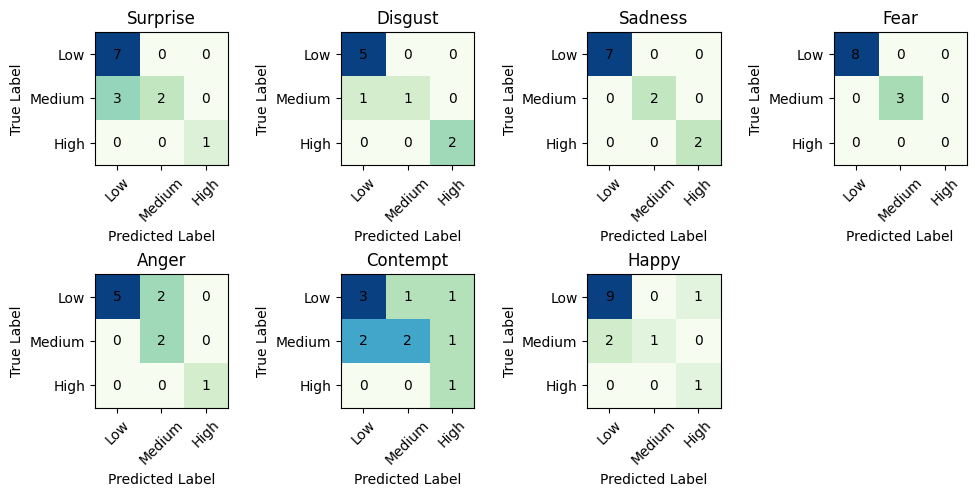

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

def c_matrix_Plot(true_labels, predicted_labels, exp, subplot_position):
    # Define the list of all possible labels
    labels = ["Low", "Medium", "High"]

    # Create the confusion matrix
    cm = confusion_matrix(true_labels, predicted_labels, labels=labels)

    # Plot the confusion matrix
    plt.subplot(subplot_position)
    plt.imshow(cm, interpolation="nearest", cmap=plt.cm.GnBu)
    plt.title(exp)
    tick_marks = np.arange(len(labels))
    plt.xticks(tick_marks, labels, rotation=45)
    plt.yticks(tick_marks, labels)
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")

    # Fill the confusion matrix cells with values
    for i in range(len(labels)):
        for j in range(len(labels)):
            plt.text(j, i, str(cm[i][j]), horizontalalignment="center", verticalalignment="center")

# Define the data for each confusion matrix plot
Su_tl = ["Medium","Low","Low","Medium","Medium","Low","Medium","High","Low","Low","Low","Low","Medium"]
Su_pl = ["Medium", "Low","Low","Medium","Low","Low","Low","High","Low","Low","Low","Low","Low"]
e = "Surprise"

Di_tl = ["Low", "High","Low","Low","Medium","High","Low","Low","Medium"]
Di_pl = ["Low","High","Low","Low","Low","High","Low","Low","Medium"]
e_di = "Disgust"

Sa_tl = ["Low","Low","Low","Medium","Low","Medium","Low","Low","High","Low","High"]
Sa_pl = ["Low","Low","Low","Medium","Low","Medium","Low", "Low","High","Low","High"]
e_sa = "Sadness"

Fe_tl = ["Medium","Low","Low","Medium","Low","Low","Medium","Low","Low","Low","Low"]
Fe_pl = ["Medium","Low","Low","Medium","Low","Low","Medium","Low","Low","Low","Low"]
e_fe = "Fear"

Ha_tl = ["High","Medium","Low","Low","Low","Low","Low","Low","Low","Medium","Low","Low","Medium","Low"]
Ha_pl = ["High","Low","Low","Low","Low","Low","Low","Low","Low","Low","Low","Low","Medium","High"]
e_Ha = "Happy"

Co_tl = ["High","Medium","Low","Medium","Medium","Low","Medium","Low","Low","Low","Medium"]
Co_pl =["High","Medium","Medium","High","Low","Low","Low","High","Low","Low","Medium"]
e_Co = "Contempt"
An_tl = ["Low","Medium","Low","Low","Low","High","Medium","Low","Low","Low"]
An_pl = ["Low","Medium","Medium","Low","Low","High","Medium","Medium","Low","Low"]

# Create a subplot with 4 columns
plt.figure(figsize=(10, 5))
# plt.figure(figsize = (4.5, 3))

# Plot the confusion matrices in the subplots
c_matrix_Plot(Su_tl, Su_pl, e, 241)
c_matrix_Plot(Di_tl, Di_pl, e_di, 242)
c_matrix_Plot(Sa_tl, Sa_pl, e_sa, 243)
c_matrix_Plot(Fe_tl, Fe_pl, e_fe, 244)
c_matrix_Plot(An_tl, An_pl, "Anger", 245)
c_matrix_Plot(Co_tl,Co_pl, e_Co,246)
c_matrix_Plot(Ha_tl, Ha_pl, "Happy",247)


plt.tight_layout()
plt.show()


# FER 2013

In [ ]:
!kaggle datasets download -d msambare/fer2013

Traceback (most recent call last):
  File "/usr/local/bin/kaggle", line 5, in <module>
    from kaggle.cli import main
  File "/usr/local/lib/python3.10/dist-packages/kaggle/__init__.py", line 23, in <module>
    api.authenticate()
  File "/usr/local/lib/python3.10/dist-packages/kaggle/api/kaggle_api_extended.py", line 403, in authenticate
    raise IOError('Could not find {}. Make sure it\'s located in'
OSError: Could not find kaggle.json. Make sure it's located in /root/.kaggle. Or use the environment method.


In [ ]:
!unzip fer2013.zip

In [ ]:
fer_dataset = '/content/train'

### Pre-processing

In [ ]:

# Auxiliary function for data distribution visualization
import cv2
def data_visualization(classes, data):
    # Define the color scheme for the bar graph
    colors = ['orange','red', 'blue', 'green', 'yellow', 'purple',  'violet']
    fig, ax = plt.subplots(figsize=(6, 3))
    ax.bar(classes, data, color=colors)
    ax.set(title="Dataset's distribution for each Emotion class")
    ax.set(xlabel="Emotions", ylabel="#Images");
    ax.grid()


def load_data(data_path):
    subfolders_ck = os.listdir(data_path)

    print("[INFO] Dataset Loading...\n")

    img_data_list=[]
    labels_list = []
    num_images_per_class = []

    for category in subfolders_ck:
        img_list=os.listdir(data_path +'/'+ category)

        print('Loading :', len(img_list), 'images of category', category)
        for img in img_list:
            # Load an image from this path
            pixels=cv2.imread(data_path + '/'+ category + '/'+ img, cv2.IMREAD_GRAYSCALE)
            face_array=cv2.resize(pixels, None, fx=1, fy=1,interpolation = cv2.INTER_CUBIC)

            img_data_list.append(face_array)
            labels_list.append(category)

        num_images_per_class.append(len(img_list))

    le = LabelEncoder()
    labels = le.fit_transform(labels_list)
    # labels = to_categorical(labels, 7)
    data = np.array(img_data_list)

    data_visualization(subfolders_ck, num_images_per_class)

    # Dataset Summary
    # print("\nTotal number of uploaded data:", data.shape[0], ", with data shape", (data.shape[1],data.shape[2],data.shape[3]))
    print("\nTotal number of uploaded data:", data.shape[0],", ", data.shape)


    return data, labels

[INFO] Dataset Loading...

Loading : 3171 images of category surprise
Loading : 4965 images of category neutral
Loading : 436 images of category disgust
Loading : 4830 images of category sad
Loading : 7215 images of category happy
Loading : 3995 images of category angry
Loading : 4097 images of category fear

Total number of uploaded data: 28709 ,  (28709, 48, 48)


(28709,)

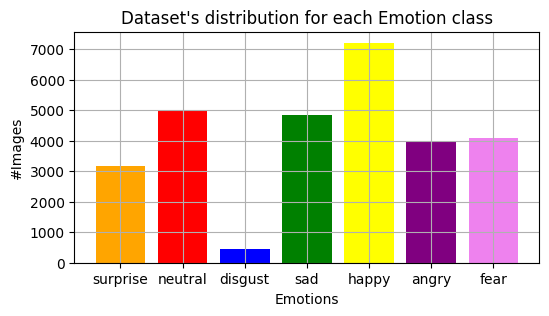

In [ ]:
data_path_ck = fer_dataset
data, labels = load_data(data_path_ck)
l = labels
l.shape

In [ ]:
from sklearn.model_selection import train_test_split

# first split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.2, random_state=42)

In [ ]:
from tensorflow.keras.utils import to_categorical

# Assume that the y_train array is already defined as a 1D array of integers

# Convert y_train to categorical
num_classes = 7 # for example, if y_train contains 10 classes
y_train = to_categorical(y_train, num_classes)
# y_val = to_categorical(y_val, num_classes)
y_test = to_categorical(y_test, num_classes)

In [ ]:
X_train.shape, y_train.shape,  X_test.shape, y_test.shape

((22967, 48, 48), (22967, 7), (5742, 48, 48), (5742, 7))

In [ ]:
import torchvision.transforms as transforms
from torch.utils.data import Dataset

x,y = 224, 224

class CustomDataset(Dataset):
    def __init__(self, data, labels, transform=None):
        self.data = data
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, index):
        x = self.data[index]
        y = self.labels[index]
        if self.transform:
            x = self.transform(x)
        return x, y

train_dataset = CustomDataset(X_train, y_train, transform=transforms.Compose([
                            transforms.Resize((x, y)),
                            transforms.ToTensor()
                        ]))

test_dataset = CustomDataset(X_test, y_test, transform=transforms.Compose([
                            transforms.Resize((x, y)),
                            transforms.ToTensor()
                        ]))


In [ ]:
batch_size = 64
train_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True
)
test_loader = torch.utils.data.DataLoader(
    test_dataset,
    batch_size=batch_size,
    shuffle=True
)

In [ ]:
import os
import shutil
import random

data_dir = fer_dataset  # Replace with the actual path to your CKPlus dataset
train_dir = '/content/ftrain_dir'  # Replace with the path where you want to store the training set
test_dir = '/content/ftest_dir'  # Replace with the path where you want to store the testing set
test_ratio = 0.2  # The ratio of data to be used for testing

# Create the train and test directories if they don't exist
os.makedirs(train_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)

# Iterate over the subfolders and randomly assign them to the train or test set
for emo_folder in os.listdir(data_dir):
    emo_path = os.path.join(data_dir, emo_folder)
    if not os.path.isdir(emo_path):
        continue
    images = os.listdir(emo_path)
    num_test = int(len(images) * test_ratio)
    test_images = random.sample(images, num_test)
    for img in images:
        src = os.path.join(emo_path, img)
        if img in test_images:
            dst = os.path.join(test_dir, emo_folder, img)
        else:
            dst = os.path.join(train_dir, emo_folder, img)
        os.makedirs(os.path.dirname(dst), exist_ok=True)
        shutil.copy(src, dst)


In [ ]:
# %% Prepare data for pretrained model
x,y = 224, 224
train_dataset = torchvision.datasets.ImageFolder(
        root='/content/ftrain_dir',
        transform=transforms.Compose([
                      transforms.Resize((x,y)),
                      transforms.ToTensor()
        ])
)

test_dataset = torchvision.datasets.ImageFolder(
        root='/content/ftest_dir',
        transform=transforms.Compose([
                      transforms.Resize((x,y)),
                      transforms.ToTensor()
        ])
)

In [ ]:
batch_size = 64
train_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True
)
test_loader = torch.utils.data.DataLoader(
    test_dataset,
    batch_size=batch_size,
    shuffle=True
)

### Modeling

In [ ]:
class CNNModel(nn.Module):
    def __init__(self):
        super(CNNModel, self).__init__()
        self.vgg16 = models.vgg16(pretrained=True)

        # Replace output layer according to our problem
        in_feats = self.vgg16.classifier[6].in_features
        self.vgg16.classifier[6] = nn.Linear(in_feats, 7)

    def forward(self, x):
        x = self.vgg16(x)
        return x

model = CNNModel()
model.to(device)
model

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:05<00:00, 93.8MB/s]


CNNModel(
  (vgg16): VGG(
    (features): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): ReLU(inplace=True)
      (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace=True)
      (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (13): ReLU(inplace=True)
      (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (15): ReLU(inplace=True)
      (16):

In [ ]:
# %% Train
cross_entropy_loss = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.0001)
epochs = 2

In [ ]:
# Iterate x epochs over the train data
print_freq = 7  # Print loss and accuracy every 100 iterations

for epoch in range(1, epochs+1):
    total_loss = 0.0
    correct = 0
    total = 0

    for i, batch in enumerate(train_loader, 0):
        inputs, labels = batch
        inputs = inputs.to(device)
        labels = labels.to(device)
        optimizer.zero_grad()
        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)

        # Calculate loss
        loss = cross_entropy_loss(outputs, labels)
        loss.backward()
        optimizer.step()

        # Update statistics
        total_loss += loss.item()
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

        # Print loss and accuracy every x iterations
        if (i+1) % print_freq == 0:
            avg_loss = total_loss / print_freq
            accuracy = 100.0 * correct / total
            print(f'Epoch [{epoch}/{epochs}], Iteration [{i+1}/{len(train_loader)}], Loss: {avg_loss:.4f}, Accuracy: {accuracy:.2f}%')
            total_loss = 0.0
            correct = 0
            total = 0

Epoch [1/2], Iteration [7/359], Loss: 1.8925, Accuracy: 22.54%
Epoch [1/2], Iteration [14/359], Loss: 1.8130, Accuracy: 23.66%
Epoch [1/2], Iteration [21/359], Loss: 1.7352, Accuracy: 29.69%
Epoch [1/2], Iteration [28/359], Loss: 1.6363, Accuracy: 37.28%
Epoch [1/2], Iteration [35/359], Loss: 1.6150, Accuracy: 38.39%
Epoch [1/2], Iteration [42/359], Loss: 1.5526, Accuracy: 41.96%
Epoch [1/2], Iteration [49/359], Loss: 1.5181, Accuracy: 40.40%
Epoch [1/2], Iteration [56/359], Loss: 1.5680, Accuracy: 39.73%
Epoch [1/2], Iteration [63/359], Loss: 1.5264, Accuracy: 39.06%
Epoch [1/2], Iteration [70/359], Loss: 1.4290, Accuracy: 43.08%


KeyboardInterrupt: ignored

In [ ]:
# Save your model to Google Drive
torch.save(model.state_dict(), '/content/drive/MyDrive/mkdef_model_30Epo.pth')

### Evaluation

In [ ]:
model.load_state_dict(torch.load("/content/drive/MyDrive/mkdef_model_50Epo.pth"))

<All keys matched successfully>

In [ ]:
import torch

model.eval()  # Set the model to evaluation mode

# Rest of your testing code
test_loss = 0
correct = 0
total = 0

with torch.no_grad():
    for batch in test_loader:
        inputs, labels = batch
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)

        total += labels.size(0)
        correct += (predicted == labels).sum().item()

        loss = cross_entropy_loss(outputs, labels)
        test_loss += loss.item()

    test_loss /= len(test_loader)
    accuracy = 100 * correct / total

    print(f"Test Loss: {test_loss:.4f}")
    print(f"Test Accuracy: {accuracy:.2f}%")


Test Loss: 0.9145
Test Accuracy: 84.69%
